# TM-scoring using USalign

Here we are going to explore how to use USalign to score the TM-score of protein
structures. We will implement this on our chimeric motors to explore the
differences in protein strurcture that might lead to different phenotypes in
ActiveDROPS. 

https://github.com/pylelab/USalign

In [2]:
import os
import subprocess
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from Bio.PDB import PDBParser, MMCIFParser, PDBIO, Select


In [ ]:

# ------------------- Residue Selector -------------------
class ResidueRangeSelect(Select):
    def __init__(self, start_residue, end_residue):
        self.start_residue = start_residue
        self.end_residue = end_residue
    def accept_residue(self, residue):
        return (
            residue.get_parent().id == "A" and
            self.start_residue <= residue.get_id()[1] <= self.end_residue
        )

def extract_residue_range(input_path, output_path, start_residue, end_residue):
    ext = os.path.splitext(input_path)[1].lower()
    parser = PDBParser(QUIET=True) if ext == ".pdb" else MMCIFParser(QUIET=True)
    structure = parser.get_structure('structure', input_path)
    io = PDBIO()
    io.set_structure(structure)
    io.save(output_path, ResidueRangeSelect(start_residue, end_residue))

# ------------------- USalign Parsing -------------------
def parse_usalign_output(output, name1, name2):
    tm_scores = []
    seq_id = None
    seq1, seq2 = "", ""
    lines = output.splitlines()
    for line in lines:
        if line.startswith("TM-score="):
            try:
                tm_scores.append(float(line.split('=')[1].split()[0]))
            except ValueError:
                continue
        elif "Seq_ID=n_identical/n_aligned=" in line:
            try:
                seq_id = float(line.split("Seq_ID=n_identical/n_aligned=")[1].strip())
            except ValueError:
                continue
    i = 0
    while i < len(lines) - 2:
        top, mid, bot = lines[i].strip(), lines[i+1].strip(), lines[i+2].strip()
        if all(c.isalpha() or c == '-' for c in top) and all(c.isalpha() or c == '-' for c in bot) and set(mid) <= set(": ."):
            seq1 += top
            seq2 += bot
            i += 3
        else:
            i += 1
    df = pd.DataFrame({name1: list(seq1), name2: list(seq2)})
    return tm_scores, seq_id, df

# ------------------- Domain Sequence Match -------------------
def find_gapped_sequence_indices(aligned_sequence, target_sequence):
    clean_sequence = aligned_sequence.replace("-", "")
    start = clean_sequence.find(target_sequence)
    if start == -1:
        return None
    gapped_indices = []
    clean_index = 0
    for i, c in enumerate(aligned_sequence):
        if c != "-":
            if start <= clean_index < start + len(target_sequence):
                gapped_indices.append(i)
            clean_index += 1
        else:
            if start <= clean_index < start + len(target_sequence):
                gapped_indices.append(i)
    return min(gapped_indices), max(gapped_indices)

# ------------------- Aligner -------------------
def align_structures(structure1_path, structure2_path, start_residue, end_residue, domain):
    base1 = os.path.splitext(os.path.basename(structure1_path))[0]
    base2 = os.path.splitext(os.path.basename(structure2_path))[0]

    domain_dir = os.path.join("../../data/3d_predictions/prodigy/trimmed_segments", domain)
    os.makedirs(domain_dir, exist_ok=True)

    trimmed1 = os.path.join(domain_dir, f"{base1}_{domain}.pdb")
    trimmed2 = os.path.join(domain_dir, f"{base2}_{domain}.pdb")

    extract_residue_range(structure1_path, trimmed1, start_residue, end_residue)
    extract_residue_range(structure2_path, trimmed2, start_residue, end_residue)

    result = subprocess.run(["USalign", trimmed1, trimmed2], stdout=subprocess.PIPE, text=True)
    return parse_usalign_output(result.stdout, base1, base2), base1, base2

# ------------------- Inputs -------------------
structure_paths = [
    "../../data/3d_predictions/prodigy/a_55.pdb",
    "../../data/3d_predictions/prodigy/h_44.pdb",
]

reference_path = structure_paths[0]
reference_name = os.path.splitext(os.path.basename(reference_path))[0]
structure_map = {os.path.splitext(os.path.basename(p))[0]: p for p in structure_paths}
structures = list(structure_map.keys())

domain_sequences = {
    "b0-a0": "AEDSIKVVCRFRPLNDSEEKA",
    "b2": "CISIAGKVYLFDKVF",
    "a1": "QEKVYNEAAKSIVTDVLA",
    "b3-ploop": "GTIFAYGQTSSGKTH",
    "L5-a2": "GVIGDSVKQGIIPRIVNDIFNHIYA",
    "b4-L8-b5": "LEFHIKVSYYEIYMDKIRDLLDVSKVNLSVHEDKNRVPYV",
    "L9-SwI": "PEDVFEVIEEGKSNRHIAVTNMNEHSSRS",
    "b6-b7": "HSVFLINVKQENLENQKKLSGKLYLVD",
    "L11-SwII": "DLAGSEKVSKTGAEG",
    "a4": "TVLDEAKNINKSLSALGNVISALAD",
    "L12-a5": "GNKTHIPYRDSKLTRILQES",
    "b8-a6": "RTTIVICCSPASFNESETKSTLDFGRRAKT",
    "neck": "VKNVVCVNEELTA",
    "coiled-coil": "EEWKRRYEKEKEKNARLKGKVEKLEIELARWRAGETVKAEEQINMEDLMEASTPNL"
}

# ------------------- Build Alignment Matrix -------------------
alignment_matrix = pd.DataFrame()
reference_column = None

for path in structure_paths[1:]:
    (tm_scores, seq_id, df), _, target_name = align_structures(reference_path, path, 1, 9999, "full")
    if reference_column is None:
        reference_column = df[reference_name]
    alignment_matrix[target_name] = df[target_name]

alignment_matrix.insert(0, reference_name, reference_column.reset_index(drop=True))

# ------------------- Infer domain index ranges -------------------
domain_index_ranges = {}
ref_seq = alignment_matrix[reference_name]
ref_string = "".join(ref_seq.tolist())

for domain, domain_seq in domain_sequences.items():
    match = find_gapped_sequence_indices(ref_string, domain_seq)
    if match:
        domain_index_ranges[domain] = match
    else:
        print(f"WARNING: Could not find domain '{domain}' in a_55")

# ------------------- Compute TM and SeqID -------------------
for domain, (start_idx, end_idx) in domain_index_ranges.items():
    print(f"\nProcessing domain: {domain}")
    aln_segment = alignment_matrix.iloc[start_idx:end_idx + 1]

    tm_matrix = pd.DataFrame(index=structures, columns=structures, dtype=float)
    seqid_matrix = pd.DataFrame(index=structures, columns=structures, dtype=float)

    for i, name_i in enumerate(structures):
        for j, name_j in enumerate(structures):
            seq_i = "".join(aln_segment[name_i].tolist()).replace("-", "")
            seq_j = "".join(aln_segment[name_j].tolist()).replace("-", "")
            identity = sum(a == b for a, b in zip(seq_i, seq_j)) / max(len(seq_i), len(seq_j)) if seq_i and seq_j else np.nan
            seqid_matrix.loc[name_i, name_j] = identity

            try:
                (tm_scores, _, _), _, _ = align_structures(
                    structure_map[name_i],
                    structure_map[name_j],
                    start_idx + 1,
                    end_idx + 1,
                    domain
                )
                tm_matrix.loc[name_i, name_j] = tm_scores[0]
            except:
                tm_matrix.loc[name_i, name_j] = np.nan

    plt.figure(figsize=(30, 10))
    plt.subplot(1, 2, 1)
    sns.heatmap(tm_matrix, annot=True, fmt=".2f", cmap="viridis", vmin=0, vmax=1, cbar_kws={"label": "TM-score"})
    plt.title(f"TM-score Heatmap: {domain}")
    plt.subplot(1, 2, 2)
    sns.heatmap(seqid_matrix, annot=True, fmt=".2f", cmap="viridis", vmin=0, vmax=1, cbar_kws={"label": "Sequence Identity"})
    plt.title(f"Sequence Identity Heatmap: {domain}")
    plt.tight_layout()
    plt.show()

In [ ]:
from Bio import AlignIO
import pandas as pd

# === Load the alignment ===
alignment = AlignIO.read("../../../../Downloads/clustalo-I20250514-094620-0072-69923726-p1m.aln-clustal_num", "clustal")

# === Convert to DataFrame ===
alignment_dict = {record.id: list(str(record.seq)) for record in alignment}
df = pd.DataFrame(alignment_dict)

# === Reference sequence name ===
ref_name = "a_55"  # Replace with the actual ID if different
if ref_name not in df.columns:
    raise ValueError(f"{ref_name} not found in alignment.")

# === Get gapped reference sequence ===
ref_seq_gapped = df[ref_name].tolist()
ref_seq_ungapped = [res for res in ref_seq_gapped if res != '-']

# === Map: ungapped index → gapped index ===
ungapped_to_gapped = [i for i, res in enumerate(ref_seq_gapped) if res != '-']
gapped_seq_str = ''.join(ref_seq_ungapped)

# === Domain dictionary ===
domain_sequences = {
    "b0-a0": "AEDSIKVVCRFRPLNDSEEKA",
    "b2": "CISIAGKVYLFDKVF",
    "a1": "QEKVYNEAAKSIVTDVLA",
    "b3-ploop": "GTIFAYGQTSSGKTH",
    "L5-a2": "GVIGDSVKQGIIPRIVNDIFNHIYA",
    "b4-L8-b5": "LEFHIKVSYYEIYMDKIRDLLDVSKVNLSVHEDKNRVPYV",
    "a3-L9-SwI": "PEDVFEVIEEGKSNRHIAVTNMNEHSSRS",
    "b6-b7": "HSVFLINVKQENLENQKKLSGKLYLVD",
    "L11-SwII": "DLAGSEKVSKTGAEG",
    "a4": "TVLDEAKNINKSLSALGNVISALAD",
    "L12-a5": "GNKTHIPYRDSKLTRILQES",
    "b8-a6": "RTTIVICCSPASFNESETKSTLDFGRRAKT",
    "neck": "VKNVVCVNEELTA",
    "coiled-coil": "EEWKRRYEKEKEKNARLKGKVEKLEIELARWRAGETVKAEEQINMEDLMEASTPNL"
}

# === Initialize domain labels ===
domain_labels = ['-'] * len(ref_seq_gapped)

# === Assign domain labels ===
for label, subseq in domain_sequences.items():
    start_idx = gapped_seq_str.find(subseq)
    if start_idx == -1:
        print(f"[NOT FOUND] {label}")
        continue
    gapped_start = ungapped_to_gapped[start_idx]
    gapped_end = ungapped_to_gapped[start_idx + len(subseq) - 1]
    for i in range(gapped_start, gapped_end + 1):
        domain_labels[i] = label
    print(f"[FOUND] {label}: gapped indices {gapped_start}-{gapped_end}")

# === Assign crude module labels ===
module_labels = (
    ["ATP-binding"] * 252 +
    ["Hydrolysis"] * (409 - 252) +
    ["Stalk"] * (len(ref_seq_gapped) - 409)
)
module_labels = module_labels[:len(ref_seq_gapped)]

# === Combine into final DataFrame ===
df_final = pd.concat([
    pd.DataFrame({
        "Module": module_labels,
        "Domain": domain_labels
    }),
    df.reset_index(drop=True)
], axis=1)

# === Output a slice for inspection ===
df_final.iloc[240:260]

In [ ]:
from Bio import AlignIO
import pandas as pd

# === Load the alignment ===
alignment = AlignIO.read("../../../../Downloads/clustalo-I20250514-094620-0072-69923726-p1m.aln-clustal_num", "clustal")

# === Convert to DataFrame ===
alignment_dict = {record.id: list(str(record.seq)) for record in alignment}
df = pd.DataFrame(alignment_dict)

# === Reference sequence name ===
ref_name = "a_55"  # Replace with actual ID if different
if ref_name not in df.columns:
    raise ValueError(f"{ref_name} not found in alignment.")

# === Get gapped reference sequence and mapping ===
ref_seq_gapped = df[ref_name].tolist()
ref_seq_ungapped = [res for res in ref_seq_gapped if res != '-']
ungapped_to_gapped = [i for i, res in enumerate(ref_seq_gapped) if res != '-']
gapped_seq_str = ''.join(ref_seq_ungapped)

# === Domain definitions from ungapped reference ===
domain_sequences = {
    "b0-a0": "AEDSIKVVCRFRPLNDSEEKA",
    "b2": "CISIAGKVYLFDKVF",
    "a1": "QEKVYNEAAKSIVTDVLA",
    "b3-ploop": "GTIFAYGQTSSGKTH",
    "L5": "GVIGDSVKQG",
    "a2": "IIPRIVNDIFNHIYA",
    "b4": "LEFHIKVSYYEIY",
    "L8-b5": "KIRDLLDVSKVNLSVHEDKNRVPYV",
    "a3": "PEDVFEVIEEGKSNR",
    "L9-SwI": "HIAVTNMNEHSSRS",
    "b6": "HSVFLINVKQEN",
    "b7": "QKKLSGKLYLV",
    "L11-SwII": "DLAGSEKVSKTGAEG",
    "a4": "TVLDEAKNINKSLSALGNVISALAD",
    "L12": "GNKTHIPYRDS",
    "a5": "KLTRILQES",
    "b8-a6": "RTTIVICC",
    "a6": "ESETKSTLDFGRRAKT",
    "neck": "VKNVVCVNEELTA",
    "coiled-coil": "EEWKRRYEKEKEKNARLKGKVEKLEIELARWRAGETVKAEEQINMEDLMEASTPNL"
}

domain_sequences = {
    "b0-a0": "AEDSIKVVCRFRPLNDSEEKA",
    "b2": "CISIAGKVYLFDKVF",
    "a1": "QEKVYNEAAKSIVTDVLA",
    "b3-ploop": "GTIFAYGQTSSGKTH",
    "L5-a2": "GVIGDSVKQGIIPRIVNDIFNHIYA",
    "b4-L8-b5": "LEFHIKVSYYEIYMDKIRDLLDVSKVNLSVHEDKNRVPYV",
    "a3-L9-SwI": "PEDVFEVIEEGKSNRHIAVTNMNEHSSRS",
    "b6-b7": "HSVFLINVKQENLENQKKLSGKLYLVD",
    "L11-SwII": "DLAGSEKVSKTGAEG",
    "a4": "TVLDEAKNINKSLSALGNVISALAD",
    "L12-a5": "GNKTHIPYRDSKLTRILQES",
    "b8-a6": "RTTIVICCSPASFNESETKSTLDFGRRAKT",
    "neck": "VKNVVCVNEELTA",
    "coiled-coil": "EEWKRRYEKEKEKNARLKGKVEKLEIELARWRAGETVKAEEQINMEDLMEASTPNL"
}

# === Locate gapped index ranges for each domain ===
domain_labels = ['-'] * len(ref_seq_gapped)
domain_ranges = {}

for label, subseq in domain_sequences.items():
    start_idx = gapped_seq_str.find(subseq)
    if start_idx == -1:
        print(f"[NOT FOUND] {label}")
        continue
    gapped_start = ungapped_to_gapped[start_idx]
    gapped_end = ungapped_to_gapped[start_idx + len(subseq) - 1]
    domain_ranges[label] = (gapped_start, gapped_end)
    for i in range(gapped_start, gapped_end + 1):
        domain_labels[i] = label
    print(f"[FOUND] {label}: gapped indices {gapped_start}-{gapped_end}")

# === Assign module labels ===
module_boundaries = {
    "ATP-binding": 252,
    "Hydrolysis": 409
}

module_labels = []
for module, boundary in module_boundaries.items():
    module_labels.extend([module] * (boundary - len(module_labels)))

module_labels.extend(["Stalk"] * (len(ref_seq_gapped) - len(module_labels)))
module_labels = module_labels[:len(ref_seq_gapped)]

# === Final annotated alignment dataframe ===
df_final = pd.concat([
    pd.DataFrame({
        "Module": module_labels,
        "Domain": domain_labels
    }),
    df.reset_index(drop=True)
], axis=1)

# === Construct per-protein domain sequence dictionaries ===
domain_sequences = {}

for protein in df.columns:
    domain_dict = {}
    for domain, (start, end) in domain_ranges.items():
        segment = df.loc[start:end, protein].tolist()
        sequence = ''.join(segment).replace('-', '')
        domain_dict[domain] = sequence
    domain_sequences[protein] = domain_dict

# === Inspect one example ===
domain_sequences

In [ ]:
#!/usr/bin/env python3
"""
Domain‑wise TM‑score & sequence‑identity pipeline (alignment‑free)
=================================================================

* Each domain is located by **exact sequence match** in chain A (no global
  alignment step).
* Matching residues are trimmed into per‑domain PDBs.
* USalign is run on every pair of trimmed PDBs to obtain TM‑scores.
* Two heat‑maps (TM‑score, sequence identity) are drawn for every domain.

REQUIREMENTS
------------
Biopython, NumPy, Pandas, Matplotlib, Seaborn, and USalign in your PATH.

USAGE
-----
Simply run:  python domain_tmseq_pipeline.py
(The script assumes the relative data paths shown below. Adjust if needed.)
"""
import os
import subprocess
import functools
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from Bio.PDB import PDBParser, MMCIFParser, PDBIO, Select, Polypeptide

# ----------------------------------------------------------------------
#  ----------  helpers for trimming PDBs -------------------------------
# ----------------------------------------------------------------------
class ResidueListSelect(Select):
    """Keep residues whose (hetflag, resseq, icode) id is in `keep_set`."""
    def __init__(self, keep_set):
        self.keep_set = keep_set
    def accept_residue(self, residue):
        return residue.get_parent().id == "A" and residue.get_id() in self.keep_set

def save_trimmed_segment(input_path, output_path, keep_residues):
    """Write chain‑A residues in `keep_residues` to `output_path`."""
    ext     = os.path.splitext(input_path)[1].lower()
    parser  = PDBParser(QUIET=True) if ext == ".pdb" else MMCIFParser(QUIET=True)
    struct  = parser.get_structure("str", input_path)
    io      = PDBIO()
    io.set_structure(struct)
    io.save(output_path, ResidueListSelect(keep_residues))

def chain_a_sequence(pdb_path):
    """
    Returns
    -------
    seq : str
        One‑letter amino‑acid sequence of chain A (standard residues only).
    residue_ids : list[tuple]
        Parallel list with residue `.get_id()` tuples
        (hetflag, resseq, icode) for mapping back to PDB numbering.
    """
    ext     = os.path.splitext(pdb_path)[1].lower()
    parser  = PDBParser(QUIET=True) if ext == ".pdb" else MMCIFParser(QUIET=True)
    struct  = parser.get_structure("str", pdb_path)
    chain   = struct[0]["A"]                   # assumes chain A exists
    seq, ids = [], []
    for res in chain:
        if not Polypeptide.is_aa(res, standard=True):
            continue
        seq.append(Polypeptide.three_to_one(res.get_resname()))
        ids.append(res.get_id())
    return "".join(seq), ids

# ----------------------------------------------------------------------
#  ----------  USalign wrapper (memoised) ------------------------------
# ----------------------------------------------------------------------
@functools.lru_cache(maxsize=None)
def run_usalign(pdb1, pdb2):
    """
    Run USalign once per pair (cached).

    Returns
    -------
    float
        First TM‑score printed by USalign (normalised to length of structure A).
        Returns np.nan if parsing fails.
    """
    output = subprocess.run(
        ["USalign", pdb1, pdb2],
        stdout=subprocess.PIPE,
        stderr=subprocess.PIPE,
        text=True,
        check=False,
    ).stdout
    for line in output.splitlines():
        if line.startswith("TM-score="):
            try:
                return float(line.split("=")[1].split()[0])
            except ValueError:
                break
    return np.nan

# ----------------------------------------------------------------------
#  ----------  USER CONFIGURATION --------------------------------------
# ----------------------------------------------------------------------
structure_paths = [
    "../../data/3d_predictions/prodigy/a_55.pdb",
    "../../data/3d_predictions/prodigy/kif5_11.cif",
    "../../data/3d_predictions/prodigy/thtr_11.cif",
    "../../data/3d_predictions/prodigy/adpa_11.cif",
    "../../data/3d_predictions/prodigy/nagr_11.cif",
    "../../data/3d_predictions/prodigy/acsu2_11.cif",
    "../../data/3d_predictions/prodigy/dipu_11.cif",
    "../../data/3d_predictions/prodigy/heal_11.cif",
    "../../data/3d_predictions/prodigy/tila_11.cif",
    "../../data/3d_predictions/prodigy/h_44.pdb",
]

# domain_sequences = {
#     # ------------------------------------------------------------------
#     #  a_55  ------------------------------------------------------------
#     # ------------------------------------------------------------------
#     "a_55": {
#         "b0-a0":       "AEDSIKVVCRFRPLNDSEEKA",
#         "b2":          "CISIAGKVYLFDKVF",
#         "a1":          "QEKVYNEAAKSIVTDVLA",
#         "b3-ploop":    "GTIFAYGQTSSGKTH",
#         "L5-a2":       "GVIGDSVKQGIIPRIVNDIFNHIYA",
#         "b4-L8-b5":    "LEFHIKVSYYEIYMDKIRDLLDVSKVNLSVHEDKNRVPYV",
#         "a3-L9-SwI":   "PEDVFEVIEEGKSNRHIAVTNMNEHSSRS",
#         "b6-b7":       "HSVFLINVKQENLENQKKLSGKLYLVD",
#         "L11-SwII":    "DLAGSEKVSKTGAEG",
#         "a4":          "TVLDEAKNINKSLSALGNVISALAD",
#         "L12-a5":      "GNKTHIPYRDSKLTRILQES",
#         "b8-a6":       "RTTIVICCSPASFNESETKSTLDFGRRAKT",
#         "neck":        "VKNVVCVNEELTA",
#         "coiled-coil": "EEWKRRYEKEKEKNARLKGKVEKLEIELARWRAGETVKAEEQINMEDLMEASTPNL",
#     },
#     # ------------------------------------------------------------------
#     #  h_44  ------------------------------------------------------------
#     # ------------------------------------------------------------------
#     "h_44": {
#         "b0-a0":       "MSSIRVVCRFRPQNKLELAQ",
#         "b2":          "NGSESNHSFSFDYVF",
#         "a1":          "QRDVYDHAAKPVIEDIMA",
#         "b3-ploop":    "GTLFVYGQTGSGKTF",
#         "L5-a2":       "GINDPNGDQELRGIVPRMIETVFEFISN",
#         "b4-L8-b5":    "IEFIVKASYIEIYMERIRDLLDTRKDNLKVREEKGKGVWV",
#         "a3-L9-SwI":   "EEDILDVINTGISNRAIAETRMNAESSRS",
#         "b6-b7":       "HSIFILTIQQKNLKVGSIKTGKLYLVD",
#         "L11-SwII":    "DLAGSEKISKTGAQG",
#         "a4":          "TTLDEAKMINKSLSSLGNVINALTD",
#         "L12-a5":      "GKSTHIPYRDSKLTRVLQES",
#         "b8-a6":       "RTTLIINCSPSSYNEAETISTLRFGSRAKN",
#         "neck":        "IKNKAKINQERSA",
#         "coiled-coil": "AELKILLSKAENEIENLKGYIKELETVSGVTVSNLKSSGSGSGSGSGSSSSSSGSSGGSGSGGSSNLSNSVNSTSNLNTSSNTSSSNVNANANVITTSVSAPTS",
#     },
# }
# ----------------------------------------------------------------------

# ---- build helpers ---------------------------------------------------
structure_map   = {os.path.splitext(os.path.basename(p))[0]: p for p in structure_paths}
structures      = list(structure_map.keys())
reference_name  = structures[0]                      # first structure as reference
domain_list     = list(domain_sequences[reference_name].keys())

# ---- cache sequences -------------------------------------------------
seq_cache = {name: chain_a_sequence(path) for name, path in structure_map.items()}

# ----------------------------------------------------------------------
#  ----------  MAIN PROCESSING LOOP ------------------------------------
# ----------------------------------------------------------------------
for domain in domain_list:
    print(f"\n=== Processing domain: {domain} ===")

    # ------------------------------------------------------------------
    #  Trim domain in every structure
    # ------------------------------------------------------------------
    trimmed_paths = {}
    for name in structures:
        if domain not in domain_sequences[name]:
            raise KeyError(
                f"Domain '{domain}' missing for structure '{name}' "
                f"in domain_sequences dictionary."
            )

        pdb_path     = structure_map[name]
        dom_seq      = domain_sequences[name][domain]

        seq, res_ids = seq_cache[name]
        start        = seq.find(dom_seq)
        if start == -1:
            raise ValueError(
                f"Exact domain sequence not found in chain A of {name} "
                f"({pdb_path}) for domain '{domain}'."
            )
        end          = start + len(dom_seq) - 1
        keep_ids     = set(res_ids[start : end + 1])

        out_dir   = os.path.join(
            "../../data/3d_predictions/prodigy/trimmed_segments", domain
        )
        os.makedirs(out_dir, exist_ok=True)
        out_pdb   = os.path.join(out_dir, f"{name}_{domain}.pdb")
        save_trimmed_segment(pdb_path, out_pdb, keep_ids)
        trimmed_paths[name] = out_pdb

    # ------------------------------------------------------------------
    #  Compute TM‑score & sequence identity matrices
    # ------------------------------------------------------------------
    tm_matrix    = pd.DataFrame(index=structures, columns=structures, dtype=float)
    seqid_matrix = pd.DataFrame(index=structures, columns=structures, dtype=float)

    for i, name_i in enumerate(structures):
        seq_i = domain_sequences[name_i][domain]
        for j, name_j in enumerate(structures):
            if j < i:                                # symmetry shortcut
                tm_matrix.iloc[i, j]    = tm_matrix.iloc[j, i]
                seqid_matrix.iloc[i, j] = seqid_matrix.iloc[j, i]
                continue

            seq_j = domain_sequences[name_j][domain]
            ident = sum(a == b for a, b in zip(seq_i, seq_j)) / min(len(seq_i), len(seq_j))
            seqid_matrix.loc[name_i, name_j] = ident

            tm_val = run_usalign(trimmed_paths[name_i], trimmed_paths[name_j])
            tm_matrix.loc[name_i, name_j] = tm_val

    # ------------------------------------------------------------------
    #  Plot heat‑maps
    # ------------------------------------------------------------------
    plt.figure(figsize=(30, 10))

    plt.subplot(1, 2, 1)
    sns.heatmap(
        tm_matrix,
        annot=True,
        fmt=".2f",
        cmap="viridis",
        vmin=0,
        vmax=1,
        square=True,
        cbar_kws={"label": "TM‑score"},
    )
    plt.title(f"TM‑score Heatmap: {domain}")

    plt.subplot(1, 2, 2)
    sns.heatmap(
        seqid_matrix,
        annot=True,
        fmt=".2f",
        cmap="viridis",
        vmin=0,
        vmax=1,
        square=True,
        cbar_kws={"label": "Sequence Identity"},
    )
    plt.title(f"Sequence Identity Heatmap: {domain}")

    plt.tight_layout()
    plt.show()
    plt.close()

print("\nDone. Trimmed PDBs saved under "
      "'../../data/3d_predictions/prodigy/trimmed_segments/<domain>/'")

In [ ]:
#!/usr/bin/env python3
"""
Kinesin‑domain TM‑score & sequence‑identity pipeline
===================================================

* Reads a Clustal multiple alignment.
* Uses **a_55** as reference to map **modules** (1‑3) and **sub‑domains**.
* Enriches the alignment DataFrame (`ali_df`) with two extra columns:
      ‑  ali_df["Module"]    :  "module 1" / "module 2" / "module 3" / "-"
      ‑  ali_df["Subdomain"] :  the sub‑domain name (e.g. "b3‑ploop") or "-"
* The structural/heat‑map part is unchanged: exact AA lookup, trimming,
  USalign, TM‑score + Seq‑ID heat‑maps.

Copy‑&‑paste ready.
"""

# ---------------------------------------------------------------------
#  0.  USER FILES & CONSTANTS
# ---------------------------------------------------------------------
alignment_file = "../../../../Downloads/species"      # Clustal alignment
structure_paths = [
    "../../data/3d_predictions/prodigy/a_55.pdb",

    "../../data/3d_predictions/prodigy/kif5_11.cif",
    "../../data/3d_predictions/prodigy/thtr_11.cif",
    "../../data/3d_predictions/prodigy/adpa_11.cif",
    "../../data/3d_predictions/prodigy/acsu2_11.cif",
    "../../data/3d_predictions/prodigy/nagr_11.cif",
    "../../data/3d_predictions/prodigy/dipu_11.cif",
    "../../data/3d_predictions/prodigy/heal_11.cif",
    "../../data/3d_predictions/prodigy/tila_11.cif",

    # "../../data/3d_predictions/prodigy/b_345.pdb",
    # "../../data/3d_predictions/prodigy/c_123.pdb",
    # "../../data/3d_predictions/prodigy/d_55.pdb",
    # "../../data/3d_predictions/prodigy/e_234.pdb",
    # "../../data/3d_predictions/prodigy/f_456.pdb",
    # "../../data/3d_predictions/prodigy/g_123.pdb",

    "../../data/3d_predictions/prodigy/h_44.pdb",
]
ref_name = "a_55"                                    # reference sequence ID

# ---------------------------------------------------------------------
#  1.  DOMAIN & MODULE DEFINITIONS (UNGAPPED, REF = a_55)
# ---------------------------------------------------------------------
domain_def_ref = {
    # ---------- modules & full ---------------------------------------
    "full":       "MSAEREIPAEDSIKVVCRFRPLNDSEEKAGSKFVVKFPNNVEENCISIAGKVYLFDKVF"
                  "KPNASQEKVYNEAAKSIVTDVLAGYNGTIFAYGQTSSGKTHTMEGVIGDSVKQGIIPRI"
                  "VNDIFNHIYAMEVNLEFHIKVSYYEIYMDKIRDLLDVSKVNLSVHEDKNRVPYVKGATE"
                  "RFVSSPEDVFEVIEEGKSNRHIAVTNMNEHSSRSHSVFLINVKQENLENQKKLSGKLYL"
                  "VDLAGSEKVSKTGAEGTVLDEAKNINKSLSALGNVISALADGNKTHIPYRDSKLTRILQ"
                  "ESLGGNARTTIVICCSPASFNESETKSTLDFGRRAKTVKNVVCVNEELTAEEWKRRYEKE"
                  "KEKNARLKGKVEKLEIELARWRAGETVKAEEQINMEDLMEASTPNL",
    "module 1":   "MSAEREIPAEDSIKVVCRFRPLNDSEEKAGSKFVVKFPNNVEENCISIAGKVYLFDKVF"
                  "KPNASQEKVYNEAAKSIVTDVLAGYNGTIFAYGQTSSGKTHTMEGVIGDSVKQGIIPRI"
                  "VNDIFNHIYAMEVNLEFHIKVSYYEIYMDKIRDLLDVSKVNLSVHEDKNRVPYVKGATERF",
    "module 2":   "VSSPEDVFEVIEEGKSNRHIAVTNMNEHSSRSHSVFLINVKQENLENQKKLSGKLYLVD"
                  "LAGSEKVSKTGAEGTVLDEAKNINKSLSALGNVISALADGNKTHIPYRDSKLTRILQESL"
                  "GGNARTTIVICCSPASFNESETKSTLDFGRRAKTVK",
    "module 3":   "NVVCVNEELTAEEWKRRYEKEKEKNARLKGKVEKLEIELARWRAGETVKAEEQINMEDL"
                  "MEASTPNL",
    # ---------- sub‑domains ------------------------------------------
    "b0-a0": "AEDSIKVVCRFRPLNDSEEKA",
    "b2": "CISIAGKVYLFDKVF",
    "a1": "QEKVYNEAAKSIVTDVLA",
    "b3-ploop": "GTIFAYGQTSSGKTH",
    "L5": "GVIGDSVKQG",
    "a2": "IIPRIVNDIFNHIYA",
    "b4": "LEFHIKVSYYEIY",
    "L8-b5": "KIRDLLDVSKVNLSVHEDKNRVPYV",
    "a3": "PEDVFEVIEEGKSNR",
    "L9-SwI": "HIAVTNMNEHSSRS",
    "b6": "HSVFLINVKQEN",
    "b7": "QKKLSGKLYLV",
    "L11-SwII": "DLAGSEKVSKTGAEG",
    "a4": "TVLDEAKNINKSLSALGNVISALAD",
    "L12": "GNKTHIPYRDS",
    "a5": "KLTRILQES",
    "b8-a6": "RTTIVICC",
    "a6": "ESETKSTLDFGRRAKT",
    "neck": "ESETKSTLDFGRRAKTVKNVVCVNEELTAEEWKRRYEK",
    "coiled-coil": "EEWKRRYEKEKEKNARLKGKVEKLEIELARWRAGETVKAEEQINMEDLMEASTPNL"
}

# split dictionaries --------------------------------------------------
modules_def_ref  = {k: v for k, v in domain_def_ref.items()
                    if k in ("full", "module 1", "module 2", "module 3")}
subdom_def_ref   = {k: v for k, v in domain_def_ref.items()
                    if k not in modules_def_ref}

# ---------------------------------------------------------------------
#  2.  READ ALIGNMENT, MAP RANGES
# ---------------------------------------------------------------------
from Bio import AlignIO
print("· loading alignment …")
ali = AlignIO.read(alignment_file, "clustal")
ali_df = pd.DataFrame({rec.id: list(str(rec.seq)) for rec in ali})
if ref_name not in ali_df.columns:
    raise ValueError(f"Reference '{ref_name}' missing from alignment.")

ref_gapped   = ali_df[ref_name].tolist()
ungapped_idx = [i for i, aa in enumerate(ref_gapped) if aa != "-"]
ref_ungapped = "".join(aa for aa in ref_gapped if aa != "-")

def map_ranges(def_dict):
    rng = {}
    for name, subseq in def_dict.items():
        u0 = ref_ungapped.find(subseq)
        if u0 == -1:
            raise ValueError(f"Cannot map '{name}'")
        g0 = ungapped_idx[u0]
        g1 = ungapped_idx[u0 + len(subseq) - 1]
        rng[name] = (g0, g1)
    return rng

module_ranges   = map_ranges({k: v for k, v in modules_def_ref.items()
                              if k != "full"})       # exclude "full"
subdom_ranges   = map_ranges(subdom_def_ref)
domain_ranges   = {**module_ranges, **subdom_ranges, "full": map_ranges({"full": modules_def_ref["full"]})["full"]}

# ---------------------------------------------------------------------
#  3.  ADD "Module" & "Subdomain" COLUMNS TO ali_df
# ---------------------------------------------------------------------
module_labels    = ["-"] * len(ref_gapped)
for mod, (g0, g1) in module_ranges.items():
    for i in range(g0, g1 + 1):
        module_labels[i] = mod

subdom_labels    = ["-"] * len(ref_gapped)
for sd, (g0, g1) in subdom_ranges.items():
    for i in range(g0, g1 + 1):
        subdom_labels[i] = sd

ali_df.insert(0, "Module",    module_labels)
ali_df.insert(1, "Subdomain", subdom_labels)

# ---------------------------------------------------------------------
#  4.  BUILD per‑protein DOMAIN SEQ DICT (ungapped)
# ---------------------------------------------------------------------
protein_dom_seq = {}
for prot in ali_df.columns[2:]:               # skip Module/Subdomain cols
    d = {}
    for dom, (g0, g1) in domain_ranges.items():
        d[dom] = "".join(ali_df.loc[g0:g1, prot]).replace("-", "")
    protein_dom_seq[prot] = d

domain_list = list(domain_ranges.keys())

# ---------------------------------------------------------------------
#  5.  STRUCTURE HELPERS (unchanged)
# ---------------------------------------------------------------------
from Bio.PDB import PDBParser, MMCIFParser, PDBIO, Select, Polypeptide
class Keep(Select):
    def __init__(self, keep): self.keep = keep
    def accept_residue(self, r): return r.get_parent().id == "A" and r.get_id() in self.keep

def chainA_sequence(path):
    parser = PDBParser(QUIET=True) if path.lower().endswith(".pdb") else MMCIFParser(QUIET=True)
    s = parser.get_structure("s", path)
    chain = s[0]["A"]
    seq, ids = [], []
    for res in chain:
        if Polypeptide.is_aa(res, standard=True):
            seq.append(Polypeptide.three_to_one(res.get_resname()))
            ids.append(res.get_id())
    return "".join(seq), ids

def save_trim(src, dst, keep_ids):
    parser = PDBParser(QUIET=True) if src.lower().endswith(".pdb") else MMCIFParser(QUIET=True)
    s = parser.get_structure("s", src)
    io = PDBIO(); io.set_structure(s); io.save(dst, Keep(keep_ids))

import functools, subprocess, numpy as np
@functools.lru_cache(maxsize=None)
def tm_score(p1, p2):
    out = subprocess.run(["USalign", p1, p2], stdout=subprocess.PIPE, text=True).stdout
    for ln in out.splitlines():
        if ln.startswith("TM-score="):
            try: return float(ln.split("=")[1].split()[0])
            except ValueError: break
    return np.nan

# ---------------------------------------------------------------------
#  6.  READ STRUCTURES
# ---------------------------------------------------------------------
structure_map = {os.path.splitext(os.path.basename(p))[0]: p for p in structure_paths}
structures    = [os.path.splitext(os.path.basename(p))[0] for p in structure_paths
                 if os.path.splitext(os.path.basename(p))[0] in protein_dom_seq]
seq_cache     = {prot: chainA_sequence(structure_map[prot]) for prot in structures}

# ---------------------------------------------------------------------
#  7.  MAIN LOOP – heat‑maps (unchanged logic)
# ---------------------------------------------------------------------
import matplotlib.pyplot as plt, seaborn as sns, os

for dom in domain_list:
    print(f"\n— {dom} —")
    g0, g1 = domain_ranges[dom]
    dom_align = ali_df.loc[g0:g1, structures]        # slice with Module/Subdomain removed

    # ---------- trim structures --------------------------------------
    trimmed = {}
    for prot in structures:
        dom_seq = protein_dom_seq[prot][dom]
        full_seq, ids = seq_cache[prot]
        idx = full_seq.find(dom_seq)
        if idx == -1:
            raise ValueError(f"{dom} not found in chain A of {prot}")
        keep_ids = set(ids[idx : idx + len(dom_seq)])
        out_dir  = f"../../data/3d_predictions/prodigy/trimmed_segments/{dom}"
        os.makedirs(out_dir, exist_ok=True)
        out_pdb  = os.path.join(out_dir, f"{prot}_{dom}.pdb")
        save_trim(structure_map[prot], out_pdb, keep_ids)
        trimmed[prot] = out_pdb

    # ---------- matrices --------------------------------------------
    tm_mat = pd.DataFrame(index=structures, columns=structures, dtype=float)
    id_mat = pd.DataFrame(index=structures, columns=structures, dtype=float)

    for i, a in enumerate(structures):
        for j, b in enumerate(structures):
            if j < i:
                tm_mat.iat[i, j] = tm_mat.iat[j, i]
                id_mat.iat[i, j] = id_mat.iat[j, i]
                continue
            col_a, col_b = dom_align[a], dom_align[b]
            mask = (col_a != '-') & (col_b != '-')
            id_mat.iat[i, j] = ((col_a == col_b) & mask).sum() / mask.sum() if mask.any() else np.nan
            tm_mat.iat[i, j] = tm_score(trimmed[a], trimmed[b])

    # ---------- plot -------------------------------------------------
    plt.figure(figsize=(20, 9))
    plt.subplot(1, 2, 1)
    sns.heatmap(tm_mat, annot=True, fmt=".2f", cmap="viridis",
                vmin=0, vmax=1, square=True, cbar_kws={"label": "TM‑score", "shrink": 0.8})
    plt.title(f"TM‑score  ({dom})")
    plt.subplot(1, 2, 2)
    sns.heatmap(id_mat, annot=True, fmt=".2f", cmap="viridis",
                vmin=0, vmax=1, square=True, cbar_kws={"label": "Sequence Identity", "shrink": 0.8})
    plt.title(f"Seq‑ID  ({dom})")
    plt.tight_layout()
    plt.show()
    plt.close()

print("\n✓  Finished – trimmed PDBs in ../../data/3d_predictions/prodigy/trimmed_segments/<domain>/")

# ---------------------------------------------------------------------
#  8.  OPTIONAL – inspect the enriched alignment DataFrame
# ---------------------------------------------------------------------
# print(ali_df.head(30))  # uncomment to preview Module / Subdomain labels

In [ ]:
#!/usr/bin/env python3
"""
Kinesin‑domain TM‑score & sequence‑identity pipeline
===================================================

* Reads a Clustal multiple alignment.
* Uses **a_55** as reference to map **modules** (1‑3) and **sub‑domains**.
* Enriches the alignment DataFrame (`ali_df`) with two extra columns:
      ‑  ali_df["Module"]    :  "module 1" / "module 2" / "module 3" / "-"
      ‑  ali_df["Subdomain"] :  the sub‑domain name (e.g. "b3‑ploop") or "-"
* The structural/heat‑map part is unchanged: exact AA lookup, trimming,
  USalign, TM‑score + Seq‑ID heat‑maps.

Copy‑&‑paste ready.
"""

# ---------------------------------------------------------------------
#  0.  USER FILES & CONSTANTS
# ---------------------------------------------------------------------
alignment_file = "../../../../Downloads/chimeras"      # Clustal alignment
structure_paths = [
    "../../data/3d_predictions/prodigy/a_55.pdb",
    
    # "../../data/3d_predictions/prodigy/kif5_11.cif",
    # "../../data/3d_predictions/prodigy/thtr_11.cif",
    # "../../data/3d_predictions/prodigy/adpa_11.cif",
    # "../../data/3d_predictions/prodigy/nagr_11.cif",
    # "../../data/3d_predictions/prodigy/acsu2_11.cif",
    # "../../data/3d_predictions/prodigy/dipu_11.cif",
    # "../../data/3d_predictions/prodigy/heal_11.cif",
    # "../../data/3d_predictions/prodigy/tila_11.cif",

    "../../data/3d_predictions/prodigy/b_345.pdb",
    "../../data/3d_predictions/prodigy/c_123.pdb",
    "../../data/3d_predictions/prodigy/d_55.pdb",
    "../../data/3d_predictions/prodigy/e_234.pdb",
    "../../data/3d_predictions/prodigy/f_456.pdb",
    "../../data/3d_predictions/prodigy/g_123.pdb",

    "../../data/3d_predictions/prodigy/h_44.pdb",
]
ref_name = "a_55"                                    # reference sequence ID

# ---------------------------------------------------------------------
#  1.  DOMAIN & MODULE DEFINITIONS (UNGAPPED, REF = a_55)
# ---------------------------------------------------------------------
domain_def_ref = {
    # ---------- modules & full ---------------------------------------
    "full":       "MSAEREIPAEDSIKVVCRFRPLNDSEEKAGSKFVVKFPNNVEENCISIAGKVYLFDKVF"
                  "KPNASQEKVYNEAAKSIVTDVLAGYNGTIFAYGQTSSGKTHTMEGVIGDSVKQGIIPRI"
                  "VNDIFNHIYAMEVNLEFHIKVSYYEIYMDKIRDLLDVSKVNLSVHEDKNRVPYVKGATE"
                  "RFVSSPEDVFEVIEEGKSNRHIAVTNMNEHSSRSHSVFLINVKQENLENQKKLSGKLYL"
                  "VDLAGSEKVSKTGAEGTVLDEAKNINKSLSALGNVISALADGNKTHIPYRDSKLTRILQ"
                  "ESLGGNARTTIVICCSPASFNESETKSTLDFGRRAKTVKNVVCVNEELTAEEWKRRYEKE"
                  "KEKNARLKGKVEKLEIELARWRAGETVKAEEQINMEDLMEASTPNL",
    "module 1":   "MSAEREIPAEDSIKVVCRFRPLNDSEEKAGSKFVVKFPNNVEENCISIAGKVYLFDKVF"
                  "KPNASQEKVYNEAAKSIVTDVLAGYNGTIFAYGQTSSGKTHTMEGVIGDSVKQGIIPRI"
                  "VNDIFNHIYAMEVNLEFHIKVSYYEIYMDKIRDLLDVSKVNLSVHEDKNRVPYVKGATERF",
    "module 2":   "VSSPEDVFEVIEEGKSNRHIAVTNMNEHSSRSHSVFLINVKQENLENQKKLSGKLYLVD"
                  "LAGSEKVSKTGAEGTVLDEAKNINKSLSALGNVISALADGNKTHIPYRDSKLTRILQESL"
                  "GGNARTTIVICCSPASFNESETKSTLDFGRRAKTVK",
    "module 3":   "NVVCVNEELTAEEWKRRYEKEKEKNARLKGKVEKLEIELARWRAGETVKAEEQINMEDL"
                  "MEASTPNL",
    # ---------- sub‑domains ------------------------------------------
    "b0-a0": "AEDSIKVVCRFRPLNDSEEKA",
    "b2": "CISIAGKVYLFDKVF",
    "a1": "QEKVYNEAAKSIVTDVLA",
    "b3-ploop": "GTIFAYGQTSSGKTH",
    "L5": "GVIGDSVKQG",
    "a2": "IIPRIVNDIFNHIYA",
    "b4": "LEFHIKVSYYEIY",
    "L8-b5": "KIRDLLDVSKVNLSVHEDKNRVPYV",
    "a3": "PEDVFEVIEEGKSNR",
    "L9-SwI": "HIAVTNMNEHSSRS",
    "b6": "HSVFLINVKQEN",
    "b7": "QKKLSGKLYLV",
    "L11-SwII": "DLAGSEKVSKTGAEG",
    "a4": "TVLDEAKNINKSLSALGNVISALAD",
    "L12": "GNKTHIPYRDS",
    "a5": "KLTRILQES",
    "b8-a6": "RTTIVICC",
    "a6": "ESETKSTLDFGRRAKT",
    "neck": "VKNVVCVNEELTA",
    "coiled-coil": "EEWKRRYEKEKEKNARLKGKVEKLEIELARWRAGETVKAEEQINMEDLMEASTPNL"
}

# split dictionaries --------------------------------------------------
modules_def_ref  = {k: v for k, v in domain_def_ref.items()
                    if k in ("full", "module 1", "module 2", "module 3")}
subdom_def_ref   = {k: v for k, v in domain_def_ref.items()
                    if k not in modules_def_ref}

# ---------------------------------------------------------------------
#  2.  READ ALIGNMENT, MAP RANGES
# ---------------------------------------------------------------------
from Bio import AlignIO
print("· loading alignment …")
ali = AlignIO.read(alignment_file, "clustal")
ali_df = pd.DataFrame({rec.id: list(str(rec.seq)) for rec in ali})
if ref_name not in ali_df.columns:
    raise ValueError(f"Reference '{ref_name}' missing from alignment.")

ref_gapped   = ali_df[ref_name].tolist()
ungapped_idx = [i for i, aa in enumerate(ref_gapped) if aa != "-"]
ref_ungapped = "".join(aa for aa in ref_gapped if aa != "-")

def map_ranges(def_dict):
    rng = {}
    for name, subseq in def_dict.items():
        u0 = ref_ungapped.find(subseq)
        if u0 == -1:
            raise ValueError(f"Cannot map '{name}'")
        g0 = ungapped_idx[u0]
        g1 = ungapped_idx[u0 + len(subseq) - 1]
        rng[name] = (g0, g1)
    return rng

module_ranges   = map_ranges({k: v for k, v in modules_def_ref.items()
                              if k != "full"})       # exclude "full"
subdom_ranges   = map_ranges(subdom_def_ref)
domain_ranges   = {**module_ranges, **subdom_ranges, "full": map_ranges({"full": modules_def_ref["full"]})["full"]}

# ---------------------------------------------------------------------
#  3.  ADD "Module" & "Subdomain" COLUMNS TO ali_df
# ---------------------------------------------------------------------
module_labels    = ["-"] * len(ref_gapped)
for mod, (g0, g1) in module_ranges.items():
    for i in range(g0, g1 + 1):
        module_labels[i] = mod

subdom_labels    = ["-"] * len(ref_gapped)
for sd, (g0, g1) in subdom_ranges.items():
    for i in range(g0, g1 + 1):
        subdom_labels[i] = sd

ali_df.insert(0, "Module",    module_labels)
ali_df.insert(1, "Subdomain", subdom_labels)

# ---------------------------------------------------------------------
#  4.  BUILD per‑protein DOMAIN SEQ DICT (ungapped)
# ---------------------------------------------------------------------
protein_dom_seq = {}
for prot in ali_df.columns[2:]:               # skip Module/Subdomain cols
    d = {}
    for dom, (g0, g1) in domain_ranges.items():
        d[dom] = "".join(ali_df.loc[g0:g1, prot]).replace("-", "")
    protein_dom_seq[prot] = d

domain_list = list(domain_ranges.keys())

# ---------------------------------------------------------------------
#  5.  STRUCTURE HELPERS (unchanged)
# ---------------------------------------------------------------------
from Bio.PDB import PDBParser, MMCIFParser, PDBIO, Select, Polypeptide
class Keep(Select):
    def __init__(self, keep): self.keep = keep
    def accept_residue(self, r): return r.get_parent().id == "A" and r.get_id() in self.keep

def chainA_sequence(path):
    parser = PDBParser(QUIET=True) if path.lower().endswith(".pdb") else MMCIFParser(QUIET=True)
    s = parser.get_structure("s", path)
    chain = s[0]["A"]
    seq, ids = [], []
    for res in chain:
        if Polypeptide.is_aa(res, standard=True):
            seq.append(Polypeptide.three_to_one(res.get_resname()))
            ids.append(res.get_id())
    return "".join(seq), ids

def save_trim(src, dst, keep_ids):
    parser = PDBParser(QUIET=True) if src.lower().endswith(".pdb") else MMCIFParser(QUIET=True)
    s = parser.get_structure("s", src)
    io = PDBIO(); io.set_structure(s); io.save(dst, Keep(keep_ids))

import functools, subprocess, numpy as np
@functools.lru_cache(maxsize=None)
def tm_score(p1, p2):
    out = subprocess.run(["USalign", p1, p2], stdout=subprocess.PIPE, text=True).stdout
    for ln in out.splitlines():
        if ln.startswith("TM-score="):
            try: return float(ln.split("=")[1].split()[0])
            except ValueError: break
    return np.nan

# ---------------------------------------------------------------------
#  6.  READ STRUCTURES
# ---------------------------------------------------------------------
structure_map = {os.path.splitext(os.path.basename(p))[0]: p for p in structure_paths}
structures    = [os.path.splitext(os.path.basename(p))[0] for p in structure_paths
                 if os.path.splitext(os.path.basename(p))[0] in protein_dom_seq]
seq_cache     = {prot: chainA_sequence(structure_map[prot]) for prot in structures}

# ---------------------------------------------------------------------
#  7.  MAIN LOOP – heat‑maps (unchanged logic)
# ---------------------------------------------------------------------
import matplotlib.pyplot as plt, seaborn as sns, os

for dom in domain_list:
    print(f"\n— {dom} —")
    g0, g1 = domain_ranges[dom]
    dom_align = ali_df.loc[g0:g1, structures]        # slice with Module/Subdomain removed

    # ---------- trim structures --------------------------------------
    trimmed = {}
    for prot in structures:
        dom_seq = protein_dom_seq[prot][dom]
        full_seq, ids = seq_cache[prot]
        idx = full_seq.find(dom_seq)
        if idx == -1:
            raise ValueError(f"{dom} not found in chain A of {prot}")
        keep_ids = set(ids[idx : idx + len(dom_seq)])
        out_dir  = f"../../data/3d_predictions/prodigy/trimmed_segments/{dom}"
        os.makedirs(out_dir, exist_ok=True)
        out_pdb  = os.path.join(out_dir, f"{prot}_{dom}.pdb")
        save_trim(structure_map[prot], out_pdb, keep_ids)
        trimmed[prot] = out_pdb

    # ---------- matrices --------------------------------------------
    tm_mat = pd.DataFrame(index=structures, columns=structures, dtype=float)
    id_mat = pd.DataFrame(index=structures, columns=structures, dtype=float)

    for i, a in enumerate(structures):
        for j, b in enumerate(structures):
            if j < i:
                tm_mat.iat[i, j] = tm_mat.iat[j, i]
                id_mat.iat[i, j] = id_mat.iat[j, i]
                continue
            col_a, col_b = dom_align[a], dom_align[b]
            mask = (col_a != '-') & (col_b != '-')
            id_mat.iat[i, j] = ((col_a == col_b) & mask).sum() / mask.sum() if mask.any() else np.nan
            tm_mat.iat[i, j] = tm_score(trimmed[a], trimmed[b])

    # ---------- plot -------------------------------------------------
    plt.figure(figsize=(20, 9))
    plt.subplot(1, 2, 1)
    sns.heatmap(tm_mat, annot=True, fmt=".2f", cmap="viridis",
                vmin=0, vmax=1, square=True, cbar_kws={"label": "TM‑score", "shrink": 0.8})
    plt.title(f"TM‑score  ({dom})")
    plt.subplot(1, 2, 2)
    sns.heatmap(id_mat, annot=True, fmt=".2f", cmap="viridis",
                vmin=0, vmax=1, square=True, cbar_kws={"label": "Sequence Identity", "shrink": 0.8})
    plt.title(f"Seq‑ID  ({dom})")
    plt.tight_layout()
    plt.show()
    plt.close()

print("\n✓  Finished – trimmed PDBs in ../../data/3d_predictions/prodigy/trimmed_segments/<domain>/")

# ---------------------------------------------------------------------
#  8.  OPTIONAL – inspect the enriched alignment DataFrame
# ---------------------------------------------------------------------
# print(ali_df.head(30))  # uncomment to preview Module / Subdomain labels

In [ ]:
#!/usr/bin/env python3
"""
Kinesin‑domain TM‑score & sequence‑identity pipeline
===================================================

* Reads a Clustal multiple alignment.
* Uses **a_55** as reference to map **modules** (1‑3) and **sub‑domains**.
* Enriches ali_df with Module / Subdomain columns.
* Builds per‑domain TM‑score & Seq‑ID matrices.
* Plots **one** heat‑map per domain:
      – lower triangle = TM‑score
      – upper triangle = sequence identity
Copy‑&‑paste ready.
"""

# ---------------------------------------------------------------------
#  0.  USER FILES & CONSTANTS
# ---------------------------------------------------------------------
import os, subprocess, functools, numpy as np, pandas as pd, matplotlib.pyplot as plt, seaborn as sns
from Bio import AlignIO
from Bio.PDB import PDBParser, MMCIFParser, PDBIO, Select, Polypeptide

alignment_file = "../../../../Downloads/chimeras"      # Clustal alignment
structure_paths = [
    "../../data/3d_predictions/prodigy/a_55.pdb",
    # "../../data/3d_predictions/prodigy/kif5_11.cif",
    # ...
    "../../data/3d_predictions/prodigy/b_345.pdb",
    "../../data/3d_predictions/prodigy/c_123.pdb",
    "../../data/3d_predictions/prodigy/d_55.pdb",
    "../../data/3d_predictions/prodigy/e_234.pdb",
    "../../data/3d_predictions/prodigy/f_456.pdb",
    "../../data/3d_predictions/prodigy/g_123.pdb",
    "../../data/3d_predictions/prodigy/h_44.pdb",
]
ref_name = "a_55"                                    # reference sequence ID

# ---------------------------------------------------------------------
#  1.  DOMAIN & MODULE DEFINITIONS (UNGAPPED, REF = a_55)
# ---------------------------------------------------------------------
domain_def_ref = {
    # ---------- modules & full ---------------------------------------
    "full": (
        "MSAEREIPAEDSIKVVCRFRPLNDSEEKAGSKFVVKFPNNVEENCISIAGKVYLFDKVF"
        "KPNASQEKVYNEAAKSIVTDVLAGYNGTIFAYGQTSSGKTHTMEGVIGDSVKQGIIPRI"
        "VNDIFNHIYAMEVNLEFHIKVSYYEIYMDKIRDLLDVSKVNLSVHEDKNRVPYVKGATE"
        "RFVSSPEDVFEVIEEGKSNRHIAVTNMNEHSSRSHSVFLINVKQENLENQKKLSGKLYL"
        "VDLAGSEKVSKTGAEGTVLDEAKNINKSLSALGNVISALADGNKTHIPYRDSKLTRILQ"
        "ESLGGNARTTIVICCSPASFNESETKSTLDFGRRAKTVKNVVCVNEELTAEEWKRRYEKE"
        "KEKNARLKGKVEKLEIELARWRAGETVKAEEQINMEDLMEASTPNL"
    ),
    "module 1": (
        "MSAEREIPAEDSIKVVCRFRPLNDSEEKAGSKFVVKFPNNVEENCISIAGKVYLFDKVF"
        "KPNASQEKVYNEAAKSIVTDVLAGYNGTIFAYGQTSSGKTHTMEGVIGDSVKQGIIPRI"
        "VNDIFNHIYAMEVNLEFHIKVSYYEIYMDKIRDLLDVSKVNLSVHEDKNRVPYVKGATERF"
    ),
    "module 2": (
        "VSSPEDVFEVIEEGKSNRHIAVTNMNEHSSRSHSVFLINVKQENLENQKKLSGKLYLVD"
        "LAGSEKVSKTGAEGTVLDEAKNINKSLSALGNVISALADGNKTHIPYRDSKLTRILQESL"
        "GGNARTTIVICCSPASFNESETKSTLDFGRRAKTVK"
    ),
    "module 3": (
        "NVVCVNEELTAEEWKRRYEKEKEKNARLKGKVEKLEIELARWRAGETVKAEEQINMEDL"
        "MEASTPNL"
    ),
    # ---------- sub‑domains (examples) --------------------------------
    "b0-a0": "AEDSIKVVCRFRPLNDSEEKA",
    "b2": "CISIAGKVYLFDKVF",
    "a1": "QEKVYNEAAKSIVTDVLA",
    "b3-ploop": "GTIFAYGQTSSGKTH",
    "L5": "GVIGDSVKQG",
    "a2": "IIPRIVNDIFNHIYA",
    "b4": "LEFHIKVSYYEIY",
    "L8-b5": "KIRDLLDVSKVNLSVHEDKNRVPYV",
    "a3": "PEDVFEVIEEGKSNR",
    "L9-SwI": "HIAVTNMNEHSSRS",
    "b6": "HSVFLINVKQEN",
    "b7": "QKKLSGKLYLV",
    "L11-SwII": "DLAGSEKVSKTGAEG",
    "a4": "TVLDEAKNINKSLSALGNVISALAD",
    "L12": "GNKTHIPYRDS",
    "a5": "KLTRILQES",
    "b8-a6": "RTTIVICC",
    "a6": "ESETKSTLDFGRRAKT",
    "neck": "VKNVVCVNEELTA",
    "coiled-coil": "EEWKRRYEKEKEKNARLKGKVEKLEIELARWRAGETVKAEEQINMEDLMEASTPNL",
}

modules_def_ref = {k: v for k, v in domain_def_ref.items() if "module" in k or k == "full"}
subdom_def_ref  = {k: v for k, v in domain_def_ref.items() if k not in modules_def_ref}

# ---------------------------------------------------------------------
#  2.  READ ALIGNMENT & MAP RANGES
# ---------------------------------------------------------------------
print("· loading alignment …")
ali = AlignIO.read(alignment_file, "clustal")
ali_df = pd.DataFrame({rec.id: list(str(rec.seq)) for rec in ali})
if ref_name not in ali_df.columns:
    raise ValueError(f"Reference '{ref_name}' missing from alignment.")

ref_gapped   = ali_df[ref_name].tolist()
ungapped_idx = [i for i, aa in enumerate(ref_gapped) if aa != "-"]
ref_ungapped = "".join(aa for aa in ref_gapped if aa != "-")

def map_ranges(def_dict):
    rng = {}
    for name, subseq in def_dict.items():
        u0 = ref_ungapped.find(subseq)
        if u0 == -1:
            raise ValueError(f"Cannot map '{name}'")
        g0 = ungapped_idx[u0]
        g1 = ungapped_idx[u0 + len(subseq) - 1]
        rng[name] = (g0, g1)
    return rng

module_ranges = map_ranges({k: v for k, v in modules_def_ref.items() if k != "full"})
subdom_ranges = map_ranges(subdom_def_ref)
domain_ranges = {
    **module_ranges,
    **subdom_ranges,
    "full": map_ranges({"full": modules_def_ref["full"]})["full"],
}

# ---------------------------------------------------------------------
#  3.  ADD "Module" & "Subdomain" COLUMNS
# ---------------------------------------------------------------------
module_labels = ["-"] * len(ref_gapped)
for mod, (g0, g1) in module_ranges.items():
    module_labels[g0 : g1 + 1] = [mod] * (g1 - g0 + 1)

subdom_labels = ["-"] * len(ref_gapped)
for sd, (g0, g1) in subdom_ranges.items():
    subdom_labels[g0 : g1 + 1] = [sd] * (g1 - g0 + 1)

ali_df.insert(0, "Module", module_labels)
ali_df.insert(1, "Subdomain", subdom_labels)

# ---------------------------------------------------------------------
#  4.  PER‑PROTEIN DOMAIN SEQ DICT
# ---------------------------------------------------------------------
protein_dom_seq = {}
for prot in ali_df.columns[2:]:  # skip new columns
    d = {}
    for dom, (g0, g1) in domain_ranges.items():
        d[dom] = "".join(ali_df.loc[g0:g1, prot]).replace("-", "")
    protein_dom_seq[prot] = d
domain_list = list(domain_ranges.keys())

# ---------------------------------------------------------------------
#  5.  STRUCTURE HELPERS
# ---------------------------------------------------------------------
class Keep(Select):
    def __init__(self, keep): self.keep = keep
    def accept_residue(self, r): return r.get_parent().id == "A" and r.get_id() in self.keep

def chainA_sequence(path):
    parser = PDBParser(QUIET=True) if path.lower().endswith(".pdb") else MMCIFParser(QUIET=True)
    s = parser.get_structure("s", path)
    chain = s[0]["A"]
    seq, ids = [], []
    for res in chain:
        if Polypeptide.is_aa(res, standard=True):
            seq.append(Polypeptide.three_to_one(res.get_resname()))
            ids.append(res.get_id())
    return "".join(seq), ids

def save_trim(src, dst, keep_ids):
    parser = PDBParser(QUIET=True) if src.lower().endswith(".pdb") else MMCIFParser(QUIET=True)
    s = parser.get_structure("s", src)
    io = PDBIO(); io.set_structure(s); io.save(dst, Keep(keep_ids))

@functools.lru_cache(maxsize=None)
def tm_score(p1, p2):
    out = subprocess.run(["USalign", p1, p2], stdout=subprocess.PIPE, text=True).stdout
    for ln in out.splitlines():
        if ln.startswith("TM-score="):
            try: return float(ln.split("=")[1].split()[0])
            except ValueError: break
    return np.nan

# ---------------------------------------------------------------------
#  6.  LOAD STRUCTURES
# ---------------------------------------------------------------------
structure_map = {os.path.splitext(os.path.basename(p))[0]: p for p in structure_paths}
structures = [
    os.path.splitext(os.path.basename(p))[0]
    for p in structure_paths
    if os.path.splitext(os.path.basename(p))[0] in protein_dom_seq
]
seq_cache = {prot: chainA_sequence(structure_map[prot]) for prot in structures}

# ---------------------------------------------------------------------
#  7.  MAIN LOOP – combined triangular heat‑maps
# ---------------------------------------------------------------------
sns.set_context("notebook")

for dom in domain_list:
    print(f"\n— {dom} —")
    g0, g1 = domain_ranges[dom]
    dom_align = ali_df.loc[g0:g1, structures]

    # ---------- trim structures --------------------------------------
    trimmed = {}
    for prot in structures:
        dom_seq = protein_dom_seq[prot][dom]
        full_seq, ids = seq_cache[prot]
        idx = full_seq.find(dom_seq)
        if idx == -1:
            raise ValueError(f"{dom} not found in chain A of {prot}")
        keep_ids = set(ids[idx : idx + len(dom_seq)])
        out_dir = f"../../data/3d_predictions/prodigy/trimmed_segments/{dom}"
        os.makedirs(out_dir, exist_ok=True)
        out_pdb = os.path.join(out_dir, f"{prot}_{dom}.pdb")
        save_trim(structure_map[prot], out_pdb, keep_ids)
        trimmed[prot] = out_pdb

    # ---------- matrices --------------------------------------------
    tm_mat = pd.DataFrame(index=structures, columns=structures, dtype=float)
    id_mat = pd.DataFrame(index=structures, columns=structures, dtype=float)

    for i, a in enumerate(structures):
        for j, b in enumerate(structures):
            if j < i:  # mirror
                tm_mat.iat[i, j] = tm_mat.iat[j, i]
                id_mat.iat[i, j] = id_mat.iat[j, i]
                continue
            col_a, col_b = dom_align[a], dom_align[b]
            mask = (col_a != '-') & (col_b != '-')
            id_mat.iat[i, j] = ((col_a == col_b) & mask).sum() / mask.sum() if mask.any() else np.nan
            tm_mat.iat[i, j] = tm_score(trimmed[a], trimmed[b])

    # ---------- combine & plot --------------------------------------
    comb_mat = tm_mat.copy()
    upper = np.triu_indices_from(comb_mat, k=1)
    comb_mat.values[upper] = id_mat.values[upper]
    np.fill_diagonal(comb_mat.values, np.nan)

    plt.figure(figsize=(10, 8))
    sns.heatmap(
        comb_mat,
        annot=True,
        fmt=".2f",
        cmap="viridis",
        vmin=0,
        vmax=1,
        square=True,
        cbar_kws={"label": "TM‑score  (lower)   |   Seq‑ID  (upper)"},
    )
    plt.title(f"{dom}  —  lower triangle: TM‑score,  upper triangle: sequence identity")
    plt.tight_layout()
    plt.show()
    plt.close()

print("\n✓  Finished – trimmed PDBs in ../../data/3d_predictions/prodigy/trimmed_segments/<domain>/")

In [ ]:
#!/usr/bin/env python3
"""
Kinesin‑domain TM‑score & sequence‑identity pipeline
===================================================

* Reads a Clustal multiple alignment.
* Uses **a_55** as reference to map **modules** (1‑3) and **sub‑domains**.
* Enriches the alignment DataFrame (`ali_df`) with two extra columns:
      ‑  ali_df["Module"]    :  "module 1" / "module 2" / "module 3" / "-"
      ‑  ali_df["Subdomain"] :  the sub‑domain name (e.g. "b3‑ploop") or "-"
* The structural/heat‑map part is unchanged: exact AA lookup, trimming,
  USalign, TM‑score + Seq‑ID heat‑maps.

Copy‑&‑paste ready.
"""

# ---------------------------------------------------------------------
#  0.  USER FILES & CONSTANTS
# ---------------------------------------------------------------------
alignment_file = "../../../../Downloads/all"      # Clustal alignment
structure_paths = [
    "../../data/3d_predictions/prodigy/popa_11.cif",
    "../../data/3d_predictions/prodigy/thtr_11.cif",
    "../../data/3d_predictions/prodigy/kif5_11.cif",
    "../../data/3d_predictions/prodigy/unc_11.cif",

    "../../data/3d_predictions/prodigy/a_55.pdb",
    "../../data/3d_predictions/prodigy/e_234.pdb",
    "../../data/3d_predictions/prodigy/c_123.pdb",
    "../../data/3d_predictions/prodigy/g_123.pdb",
    "../../data/3d_predictions/prodigy/tila_11.cif",
    "../../data/3d_predictions/prodigy/acsu2_11.cif",
    "../../data/3d_predictions/prodigy/acsu_11.cif",
    "../../data/3d_predictions/prodigy/heal_11.cif",
    "../../data/3d_predictions/prodigy/dipu_11.cif",
    "../../data/3d_predictions/prodigy/d_55.pdb",
    "../../data/3d_predictions/prodigy/h_44.pdb",
    "../../data/3d_predictions/prodigy/blesto_11.cif",
    "../../data/3d_predictions/prodigy/blesto2_11.cif",

    "../../data/3d_predictions/prodigy/adpa_11.cif",
    "../../data/3d_predictions/prodigy/nagr_11.cif",

    "../../data/3d_predictions/prodigy/b_345.pdb",
    "../../data/3d_predictions/prodigy/f_456.pdb",

]
ref_name = "a_55"                                    # reference sequence ID

# ---------------------------------------------------------------------
#  1.  DOMAIN & MODULE DEFINITIONS (UNGAPPED, REF = a_55)
# ---------------------------------------------------------------------
domain_def_ref = {
    # ---------- modules & full ---------------------------------------
    "full":       "MSAEREIPAEDSIKVVCRFRPLNDSEEKAGSKFVVKFPNNVEENCISIAGKVYLFDKVF"
                  "KPNASQEKVYNEAAKSIVTDVLAGYNGTIFAYGQTSSGKTHTMEGVIGDSVKQGIIPRI"
                  "VNDIFNHIYAMEVNLEFHIKVSYYEIYMDKIRDLLDVSKVNLSVHEDKNRVPYVKGATE"
                  "RFVSSPEDVFEVIEEGKSNRHIAVTNMNEHSSRSHSVFLINVKQENLENQKKLSGKLYL"
                  "VDLAGSEKVSKTGAEGTVLDEAKNINKSLSALGNVISALADGNKTHIPYRDSKLTRILQ"
                  "ESLGGNARTTIVICCSPASFNESETKSTLDFGRRAKTVKNVVCVNEELTAEEWKRRYEKE"
                  "KEKNARLKGKVEKLEIELARWRAGETVKAEEQINMEDLMEASTPNL",
    "module 1":   "MSAEREIPAEDSIKVVCRFRPLNDSEEKAGSKFVVKFPNNVEENCISIAGKVYLFDKVF"
                  "KPNASQEKVYNEAAKSIVTDVLAGYNGTIFAYGQTSSGKTHTMEGVIGDSVKQGIIPRI"
                  "VNDIFNHIYAMEVNLEFHIKVSYYEIYMDKIRDLLDVSKVNLSVHEDKNRVPYVKGATERF",
    "module 2":   "VSSPEDVFEVIEEGKSNRHIAVTNMNEHSSRSHSVFLINVKQENLENQKKLSGKLYLVD"
                  "LAGSEKVSKTGAEGTVLDEAKNINKSLSALGNVISALADGNKTHIPYRDSKLTRILQESL"
                  "GGNARTTIVICCSPASFNESETKSTLDFGRRAKTVK",
    "module 3":   "NVVCVNEELTAEEWKRRYEKEKEKNARLKGKVEKLEIELARWRAGETVKAEEQINMEDL"
                  "MEASTPNL",
    # ---------- sub‑domains ------------------------------------------
    "b0-a0": "AEDSIKVVCRFRPLNDSEEKA",
    "b2": "CISIAGKVYLFDKVF",
    "a1": "QEKVYNEAAKSIVTDVLA",
    "b3-ploop": "GTIFAYGQTSSGKTH",
    "L5": "GVIGDSVKQG",
    "a2": "IIPRIVNDIFNHIYA",
    "b4": "LEFHIKVSYYEIY",
    "L8-b5": "KIRDLLDVSKVNLSVHEDKNRVPYV",
    "a3": "PEDVFEVIEEGKSNR",
    "L9-SwI": "HIAVTNMNEHSSRS",
    "b6": "HSVFLINVKQEN",
    "b7": "QKKLSGKLYLV",
    "L11-SwII": "DLAGSEKVSKTGAEG",
    "a4": "TVLDEAKNINKSLSALGNVISALAD",
    "L12": "GNKTHIPYRDS",
    "a5": "KLTRILQES",
    "b8-a6": "RTTIVICC",
    "a6": "ESETKSTLDFGRRAKT",
    "neck": "VKNVVCVNEELTA",
    "coiled-coil": "EEWKRRYEKEKEKNARLKGKVEKLEIELARWRAGETVKAEEQINMEDLMEASTPNL"
}

# split dictionaries --------------------------------------------------
modules_def_ref  = {k: v for k, v in domain_def_ref.items()
                    if k in ("full", "module 1", "module 2", "module 3")}
subdom_def_ref   = {k: v for k, v in domain_def_ref.items()
                    if k not in modules_def_ref}

# ---------------------------------------------------------------------
#  2.  READ ALIGNMENT, MAP RANGES
# ---------------------------------------------------------------------
from Bio import AlignIO
print("· loading alignment …")
ali = AlignIO.read(alignment_file, "clustal")
ali_df = pd.DataFrame({rec.id: list(str(rec.seq)) for rec in ali})
if ref_name not in ali_df.columns:
    raise ValueError(f"Reference '{ref_name}' missing from alignment.")

ref_gapped   = ali_df[ref_name].tolist()
ungapped_idx = [i for i, aa in enumerate(ref_gapped) if aa != "-"]
ref_ungapped = "".join(aa for aa in ref_gapped if aa != "-")

def map_ranges(def_dict):
    rng = {}
    for name, subseq in def_dict.items():
        u0 = ref_ungapped.find(subseq)
        if u0 == -1:
            raise ValueError(f"Cannot map '{name}'")
        g0 = ungapped_idx[u0]
        g1 = ungapped_idx[u0 + len(subseq) - 1]
        rng[name] = (g0, g1)
    return rng

module_ranges   = map_ranges({k: v for k, v in modules_def_ref.items()
                              if k != "full"})       # exclude "full"
subdom_ranges   = map_ranges(subdom_def_ref)
domain_ranges   = {**module_ranges, **subdom_ranges, "full": map_ranges({"full": modules_def_ref["full"]})["full"]}

# ---------------------------------------------------------------------
#  3.  ADD "Module" & "Subdomain" COLUMNS TO ali_df
# ---------------------------------------------------------------------
module_labels    = ["-"] * len(ref_gapped)
for mod, (g0, g1) in module_ranges.items():
    for i in range(g0, g1 + 1):
        module_labels[i] = mod

subdom_labels    = ["-"] * len(ref_gapped)
for sd, (g0, g1) in subdom_ranges.items():
    for i in range(g0, g1 + 1):
        subdom_labels[i] = sd

ali_df.insert(0, "Module",    module_labels)
ali_df.insert(1, "Subdomain", subdom_labels)

# ---------------------------------------------------------------------
#  4.  BUILD per‑protein DOMAIN SEQ DICT (ungapped)
# ---------------------------------------------------------------------
protein_dom_seq = {}
for prot in ali_df.columns[2:]:               # skip Module/Subdomain cols
    d = {}
    for dom, (g0, g1) in domain_ranges.items():
        d[dom] = "".join(ali_df.loc[g0:g1, prot]).replace("-", "")
    protein_dom_seq[prot] = d

domain_list = list(domain_ranges.keys())

# ---------------------------------------------------------------------
#  5.  STRUCTURE HELPERS (unchanged)
# ---------------------------------------------------------------------
from Bio.PDB import PDBParser, MMCIFParser, PDBIO, Select, Polypeptide
class Keep(Select):
    def __init__(self, keep): self.keep = keep
    def accept_residue(self, r): return r.get_parent().id == "A" and r.get_id() in self.keep

def chainA_sequence(path):
    parser = PDBParser(QUIET=True) if path.lower().endswith(".pdb") else MMCIFParser(QUIET=True)
    s = parser.get_structure("s", path)
    chain = s[0]["A"]
    seq, ids = [], []
    for res in chain:
        if Polypeptide.is_aa(res, standard=True):
            seq.append(Polypeptide.three_to_one(res.get_resname()))
            ids.append(res.get_id())
    return "".join(seq), ids

def save_trim(src, dst, keep_ids):
    parser = PDBParser(QUIET=True) if src.lower().endswith(".pdb") else MMCIFParser(QUIET=True)
    s = parser.get_structure("s", src)
    io = PDBIO(); io.set_structure(s); io.save(dst, Keep(keep_ids))

import functools, subprocess, numpy as np
@functools.lru_cache(maxsize=None)
def tm_score(p1, p2):
    out = subprocess.run(["USalign", p1, p2], stdout=subprocess.PIPE, text=True).stdout
    for ln in out.splitlines():
        if ln.startswith("TM-score="):
            try: return float(ln.split("=")[1].split()[0])
            except ValueError: break
    return np.nan

# ---------------------------------------------------------------------
#  6.  READ STRUCTURES
# ---------------------------------------------------------------------
structure_map = {os.path.splitext(os.path.basename(p))[0]: p for p in structure_paths}
structures    = [os.path.splitext(os.path.basename(p))[0] for p in structure_paths
                 if os.path.splitext(os.path.basename(p))[0] in protein_dom_seq]
seq_cache     = {prot: chainA_sequence(structure_map[prot]) for prot in structures}

# ---------------------------------------------------------------------
#  7.  MAIN LOOP – heat‑maps (unchanged logic)
# ---------------------------------------------------------------------
import matplotlib.pyplot as plt, seaborn as sns, os

for dom in domain_list:
    print(f"\n— {dom} —")
    g0, g1 = domain_ranges[dom]
    dom_align = ali_df.loc[g0:g1, structures]        # slice with Module/Subdomain removed

    # ---------- trim structures --------------------------------------
    trimmed = {}
    for prot in structures:
        dom_seq = protein_dom_seq[prot][dom]
        full_seq, ids = seq_cache[prot]
        idx = full_seq.find(dom_seq)
        if idx == -1:
            raise ValueError(f"{dom} not found in chain A of {prot}")
        keep_ids = set(ids[idx : idx + len(dom_seq)])
        out_dir  = f"../../data/3d_predictions/prodigy/trimmed_segments/{dom}"
        os.makedirs(out_dir, exist_ok=True)
        out_pdb  = os.path.join(out_dir, f"{prot}_{dom}.pdb")
        save_trim(structure_map[prot], out_pdb, keep_ids)
        trimmed[prot] = out_pdb

    # ---------- matrices --------------------------------------------
    tm_mat = pd.DataFrame(index=structures, columns=structures, dtype=float)
    id_mat = pd.DataFrame(index=structures, columns=structures, dtype=float)

    for i, a in enumerate(structures):
        for j, b in enumerate(structures):
            if j < i:
                tm_mat.iat[i, j] = tm_mat.iat[j, i]
                id_mat.iat[i, j] = id_mat.iat[j, i]
                continue
            col_a, col_b = dom_align[a], dom_align[b]
            mask = (col_a != '-') & (col_b != '-')
            id_mat.iat[i, j] = ((col_a == col_b) & mask).sum() / mask.sum() if mask.any() else np.nan
            tm_mat.iat[i, j] = tm_score(trimmed[a], trimmed[b])

    # ---------- plot -------------------------------------------------
    plt.figure(figsize=(20, 9))
    plt.subplot(1, 2, 1)
    sns.heatmap(tm_mat, annot=True, fmt=".2f", cmap="viridis",
                vmin=0, vmax=1, square=True, cbar_kws={"label": "TM‑score", "shrink": 0.8})
    plt.title(f"TM‑score  ({dom})")
    plt.subplot(1, 2, 2)
    sns.heatmap(id_mat, annot=True, fmt=".2f", cmap="viridis",
                vmin=0, vmax=1, square=True, cbar_kws={"label": "Sequence Identity", "shrink": 0.8})
    plt.title(f"Seq‑ID  ({dom})")
    plt.tight_layout()
    plt.show()
    plt.close()

print("\n✓  Finished – trimmed PDBs in ../../data/3d_predictions/prodigy/trimmed_segments/<domain>/")

# ---------------------------------------------------------------------
#  8.  OPTIONAL – inspect the enriched alignment DataFrame
# ---------------------------------------------------------------------
# print(ali_df.head(30))  # uncomment to preview Module / Subdomain labels

In [ ]:
df

In [ ]:
#!/usr/bin/env python3
"""
Kinesin‑domain TM‑score & sequence‑identity pipeline
===================================================

* Reads a Clustal multiple alignment.
* Uses **a_55** as reference to map **modules** (1‑3) and **sub‑domains**.
* Enriches the alignment DataFrame (`ali_df`) with two extra columns:
      ‑  ali_df["Module"]    :  "module 1" / "module 2" / "module 3" / "-"
      ‑  ali_df["Subdomain"] :  the sub‑domain name (e.g. "b3‑ploop") or "-"
* The structural/heat‑map part is unchanged: exact AA lookup, trimming,
  USalign, TM‑score + Seq‑ID heat‑maps.

Copy‑&‑paste ready.
"""

# ---------------------------------------------------------------------
#  0.  USER FILES & CONSTANTS
# ---------------------------------------------------------------------
alignment_file = "../../../../Downloads/kt"      # Clustal alignment
structure_paths = [
    "../../data/3d_predictions/k401_ThTr-states/k401_abtub_adpx2_gtpx2_mgx4_seed123.cif",
    "../../data/3d_predictions/k401_ThTr-states/k401_abtub_adpx2_gtpx2_mgx4_seed22.cif",
    "../../data/3d_predictions/k401_ThTr-states/k401_abtub_adpx2_gtpx2_mgx4_seed420.cif",
    "../../data/3d_predictions/k401_ThTr-states/k401_abtub_adpx2_gtpx2_mgx4_seed69.cif",
    "../../data/3d_predictions/k401_ThTr-states/k401_abtub_adpx2_gtpx2_mgx4_seed8.cif",

    "../../data/3d_predictions/k401_ThTr-states/k401_abtub_seed123.cif",
    "../../data/3d_predictions/k401_ThTr-states/k401_abtub_seed22.cif",
    "../../data/3d_predictions/k401_ThTr-states/k401_abtub_seed420.cif",
    "../../data/3d_predictions/k401_ThTr-states/k401_abtub_seed69.cif",
    "../../data/3d_predictions/k401_ThTr-states/k401_abtub_seed8.cif",

    "../../data/3d_predictions/k401_ThTr-states/k401_abtub_atpx2_gtpx2_mgx4_seed123.cif",
    "../../data/3d_predictions/k401_ThTr-states/k401_abtub_atpx2_gtpx2_mgx4_seed22.cif",
    "../../data/3d_predictions/k401_ThTr-states/k401_abtub_atpx2_gtpx2_mgx4_seed420.cif",
    "../../data/3d_predictions/k401_ThTr-states/k401_abtub_atpx2_gtpx2_mgx4_seed69.cif",
    "../../data/3d_predictions/k401_ThTr-states/k401_abtub_atpx2_gtpx2_mgx4_seed8.cif",


    "../../data/3d_predictions/k401_ThTr-states/thtr_abtub_adpx2_gtpx2_mgx4_seed123.cif",
    "../../data/3d_predictions/k401_ThTr-states/thtr_abtub_adpx2_gtpx2_mgx4_seed22.cif",
    "../../data/3d_predictions/k401_ThTr-states/thtr_abtub_adpx2_gtpx2_mgx4_seed420.cif",
    "../../data/3d_predictions/k401_ThTr-states/thtr_abtub_adpx2_gtpx2_mgx4_seed69.cif",
    "../../data/3d_predictions/k401_ThTr-states/thtr_abtub_adpx2_gtpx2_mgx4_seed8.cif",

    "../../data/3d_predictions/k401_ThTr-states/thtr_abtub_seed123.cif",
    "../../data/3d_predictions/k401_ThTr-states/thtr_abtub_seed22.cif",
    "../../data/3d_predictions/k401_ThTr-states/thtr_abtub_seed420.cif",
    "../../data/3d_predictions/k401_ThTr-states/thtr_abtub_seed69.cif",
    "../../data/3d_predictions/k401_ThTr-states/thtr_abtub_seed8.cif",

    "../../data/3d_predictions/k401_ThTr-states/thtr_abtub_atpx2_gtpx2_mgx4_seed123.cif",
    "../../data/3d_predictions/k401_ThTr-states/thtr_abtub_atpx2_gtpx2_mgx4_seed22.cif",
    "../../data/3d_predictions/k401_ThTr-states/thtr_abtub_atpx2_gtpx2_mgx4_seed420.cif",
    "../../data/3d_predictions/k401_ThTr-states/thtr_abtub_atpx2_gtpx2_mgx4_seed69.cif",
    "../../data/3d_predictions/k401_ThTr-states/thtr_abtub_atpx2_gtpx2_mgx4_seed8.cif",

]


ref_name = "k401_abtub_adpx2_gtpx2_mgx4_seed123"                                    # reference sequence ID

# ---------------------------------------------------------------------
#  1.  DOMAIN & MODULE DEFINITIONS (UNGAPPED, REF = a_55)
# ---------------------------------------------------------------------
domain_def_ref = {
    # ---------- modules & full ---------------------------------------
    "full":       "MSAEREIPAEDSIKVVCRFRPLNDSEEKAGSKFVVKFPNNVEENCISIAGKVYLFDKVF"
                  "KPNASQEKVYNEAAKSIVTDVLAGYNGTIFAYGQTSSGKTHTMEGVIGDSVKQGIIPRI"
                  "VNDIFNHIYAMEVNLEFHIKVSYYEIYMDKIRDLLDVSKVNLSVHEDKNRVPYVKGATE"
                  "RFVSSPEDVFEVIEEGKSNRHIAVTNMNEHSSRSHSVFLINVKQENLENQKKLSGKLYL"
                  "VDLAGSEKVSKTGAEGTVLDEAKNINKSLSALGNVISALADGNKTHIPYRDSKLTRILQ"
                  "ESLGGNARTTIVICCSPASFNESETKSTLDFGRRAKTVKNVVCVNEELTAEEWKRRYEKE"
                  "KEKNARLKGKVEKLEIELARWRAGETVKAEEQINMEDLMEASTPNL",
    "module 1":   "MSAEREIPAEDSIKVVCRFRPLNDSEEKAGSKFVVKFPNNVEENCISIAGKVYLFDKVF"
                  "KPNASQEKVYNEAAKSIVTDVLAGYNGTIFAYGQTSSGKTHTMEGVIGDSVKQGIIPRI"
                  "VNDIFNHIYAMEVNLEFHIKVSYYEIYMDKIRDLLDVSKVNLSVHEDKNRVPYVKGATERF",
    "module 2":   "VSSPEDVFEVIEEGKSNRHIAVTNMNEHSSRSHSVFLINVKQENLENQKKLSGKLYLVD"
                  "LAGSEKVSKTGAEGTVLDEAKNINKSLSALGNVISALADGNKTHIPYRDSKLTRILQESL"
                  "GGNARTTIVICCSPASFNESETKSTLDFGRRAKTVK",
    "module 3":   "NVVCVNEELTAEEWKRRYEKEKEKNARLKGKVEKLEIELARWRAGETVKAEEQINMEDL"
                  "MEASTPNL",
    "module 1+2": "MSAEREIPAEDSIKVVCRFRPLNDSEEKAGSKFVVKFPNNVEENCISIAGKVYLFDKVF"
                  "KPNASQEKVYNEAAKSIVTDVLAGYNGTIFAYGQTSSGKTHTMEGVIGDSVKQGIIPRI"
                  "VNDIFNHIYAMEVNLEFHIKVSYYEIYMDKIRDLLDVSKVNLSVHEDKNRVPYVKGATERFVSSPEDVFEVIEEGKSNRHIAVTNMNEHSSRSHSVFLINVKQENLENQKKLSGKLYLVD"
                  "LAGSEKVSKTGAEGTVLDEAKNINKSLSALGNVISALADGNKTHIPYRDSKLTRILQESL"
                  "GGNARTTIVICCSPASFNESETKSTLDFGRRAKTVK",    # ---------- sub‑domains ------------------------------------------
    "b0-a0": "AEDSIKVVCRFRPLNDSEEKA",
    "b2": "CISIAGKVYLFDKVF",
    "a1": "QEKVYNEAAKSIVTDVLA",
    "b3-ploop": "GTIFAYGQTSSGKTH",
    "L5": "GVIGDSVKQG",
    "a2": "IIPRIVNDIFNHIYA",
    "b4": "LEFHIKVSYYEIY",
    "L8-b5": "KIRDLLDVSKVNLSVHEDKNRVPYV",
    "a3": "PEDVFEVIEEGKSNR",
    "L9-SwI": "HIAVTNMNEHSSRS",
    "b6": "HSVFLINVKQEN",
    "b7": "QKKLSGKLYLV",
    "L11-SwII": "DLAGSEKVSKTGAEG",
    "a4": "TVLDEAKNINKSLSALGNVISALAD",
    "L12": "GNKTHIPYRDS",
    "a5": "KLTRILQES",
    "b8-a6": "RTTIVICC",
    "a6": "ESETKSTLDFGRRAKT",
    "neck": "VKNVVCVNEELTA",
    "coiled-coil": "EEWKRRYEKEKEKNARLKGKVEKLEIELARWRAGETVKAEEQINMEDLMEASTPNL"
}

# split dictionaries --------------------------------------------------
modules_def_ref  = {k: v for k, v in domain_def_ref.items()
                    if k in ("full", "module 1", "module 2", "module 3")}
subdom_def_ref   = {k: v for k, v in domain_def_ref.items()
                    if k not in modules_def_ref}

# ---------------------------------------------------------------------
#  2.  READ ALIGNMENT, MAP RANGES
# ---------------------------------------------------------------------
from Bio import AlignIO
print("· loading alignment …")
ali = AlignIO.read(alignment_file, "clustal")
ali_df = pd.DataFrame({rec.id: list(str(rec.seq)) for rec in ali})
if ref_name not in ali_df.columns:
    raise ValueError(f"Reference '{ref_name}' missing from alignment.")

ref_gapped   = ali_df[ref_name].tolist()
ungapped_idx = [i for i, aa in enumerate(ref_gapped) if aa != "-"]
ref_ungapped = "".join(aa for aa in ref_gapped if aa != "-")

def map_ranges(def_dict):
    rng = {}
    for name, subseq in def_dict.items():
        u0 = ref_ungapped.find(subseq)
        if u0 == -1:
            raise ValueError(f"Cannot map '{name}'")
        g0 = ungapped_idx[u0]
        g1 = ungapped_idx[u0 + len(subseq) - 1]
        rng[name] = (g0, g1)
    return rng

module_ranges   = map_ranges({k: v for k, v in modules_def_ref.items()
                              if k != "full"})       # exclude "full"
subdom_ranges   = map_ranges(subdom_def_ref)
domain_ranges   = {**module_ranges, **subdom_ranges, "full": map_ranges({"full": modules_def_ref["full"]})["full"]}

# ---------------------------------------------------------------------
#  3.  ADD "Module" & "Subdomain" COLUMNS TO ali_df
# ---------------------------------------------------------------------
module_labels    = ["-"] * len(ref_gapped)
for mod, (g0, g1) in module_ranges.items():
    for i in range(g0, g1 + 1):
        module_labels[i] = mod

subdom_labels    = ["-"] * len(ref_gapped)
for sd, (g0, g1) in subdom_ranges.items():
    for i in range(g0, g1 + 1):
        subdom_labels[i] = sd

ali_df.insert(0, "Module",    module_labels)
ali_df.insert(1, "Subdomain", subdom_labels)

# ---------------------------------------------------------------------
#  4.  BUILD per‑protein DOMAIN SEQ DICT (ungapped)
# ---------------------------------------------------------------------
protein_dom_seq = {}
for prot in ali_df.columns[2:]:               # skip Module/Subdomain cols
    d = {}
    for dom, (g0, g1) in domain_ranges.items():
        d[dom] = "".join(ali_df.loc[g0:g1, prot]).replace("-", "")
    protein_dom_seq[prot] = d

domain_list = list(domain_ranges.keys())

# ---------------------------------------------------------------------
#  5.  STRUCTURE HELPERS (unchanged)
# ---------------------------------------------------------------------
from Bio.PDB import PDBParser, MMCIFParser, PDBIO, Select, Polypeptide
class Keep(Select):
    def __init__(self, keep): self.keep = keep
    def accept_residue(self, r): return r.get_parent().id == "A" and r.get_id() in self.keep

def chainA_sequence(path):
    parser = PDBParser(QUIET=True) if path.lower().endswith(".pdb") else MMCIFParser(QUIET=True)
    s = parser.get_structure("s", path)
    chain = s[0]["A"]
    seq, ids = [], []
    for res in chain:
        if Polypeptide.is_aa(res, standard=True):
            seq.append(Polypeptide.three_to_one(res.get_resname()))
            ids.append(res.get_id())
    return "".join(seq), ids

def save_trim(src, dst, keep_ids):
    parser = PDBParser(QUIET=True) if src.lower().endswith(".pdb") else MMCIFParser(QUIET=True)
    s = parser.get_structure("s", src)
    io = PDBIO(); io.set_structure(s); io.save(dst, Keep(keep_ids))

import functools, subprocess, numpy as np
@functools.lru_cache(maxsize=None)
def tm_score(p1, p2):
    out = subprocess.run(["USalign", p1, p2], stdout=subprocess.PIPE, text=True).stdout
    for ln in out.splitlines():
        if ln.startswith("TM-score="):
            try: return float(ln.split("=")[1].split()[0])
            except ValueError: break
    return np.nan

# ---------------------------------------------------------------------
#  6.  READ STRUCTURES
# ---------------------------------------------------------------------
structure_map = {os.path.splitext(os.path.basename(p))[0]: p for p in structure_paths}
structures    = [os.path.splitext(os.path.basename(p))[0] for p in structure_paths
                 if os.path.splitext(os.path.basename(p))[0] in protein_dom_seq]
seq_cache     = {prot: chainA_sequence(structure_map[prot]) for prot in structures}

# ---------------------------------------------------------------------
#  7.  MAIN LOOP – heat‑maps (unchanged logic)
# ---------------------------------------------------------------------
import matplotlib.pyplot as plt, seaborn as sns, os

for dom in domain_list:
    print(f"\n— {dom} —")
    g0, g1 = domain_ranges[dom]
    dom_align = ali_df.loc[g0:g1, structures]        # slice with Module/Subdomain removed

    # ---------- trim structures --------------------------------------
    trimmed = {}
    for prot in structures:
        dom_seq = protein_dom_seq[prot][dom]
        full_seq, ids = seq_cache[prot]
        idx = full_seq.find(dom_seq)
        if idx == -1:
            raise ValueError(f"{dom} not found in chain A of {prot}")
        keep_ids = set(ids[idx : idx + len(dom_seq)])
        out_dir  = f"../../data/3d_predictions/prodigy/trimmed_segments/{dom}"
        os.makedirs(out_dir, exist_ok=True)
        out_pdb  = os.path.join(out_dir, f"{prot}_{dom}.pdb")
        save_trim(structure_map[prot], out_pdb, keep_ids)
        trimmed[prot] = out_pdb

    # ---------- matrices --------------------------------------------
    tm_mat = pd.DataFrame(index=structures, columns=structures, dtype=float)
    id_mat = pd.DataFrame(index=structures, columns=structures, dtype=float)

    for i, a in enumerate(structures):
        for j, b in enumerate(structures):
            if j < i:
                tm_mat.iat[i, j] = tm_mat.iat[j, i]
                id_mat.iat[i, j] = id_mat.iat[j, i]
                continue
            col_a, col_b = dom_align[a], dom_align[b]
            mask = (col_a != '-') & (col_b != '-')
            id_mat.iat[i, j] = ((col_a == col_b) & mask).sum() / mask.sum() if mask.any() else np.nan
            tm_mat.iat[i, j] = tm_score(trimmed[a], trimmed[b])

    # ---------- plot -------------------------------------------------
    plt.figure(figsize=(20, 9))
    plt.subplot(1, 2, 1)
    sns.heatmap(tm_mat, annot=False, fmt=".2f", cmap="viridis",
                vmin=0, vmax=1, square=True, cbar_kws={"label": "TM‑score", "shrink": 0.8})
    plt.title(f"TM‑score  ({dom})")
    plt.subplot(1, 2, 2)
    sns.heatmap(id_mat, annot=False, fmt=".2f", cmap="viridis",
                vmin=0, vmax=1, square=True, cbar_kws={"label": "Sequence Identity", "shrink": 0.8})
    plt.title(f"Seq‑ID  ({dom})")
    plt.tight_layout()
    plt.show()
    plt.close()

print("\n✓  Finished – trimmed PDBs in ../../data/3d_predictions/prodigy/trimmed_segments/<domain>/")

# ---------------------------------------------------------------------
#  8.  OPTIONAL – inspect the enriched alignment DataFrame
# ---------------------------------------------------------------------
# print(ali_df.head(30))  # uncomment to preview Module / Subdomain labels

In [1]:
import os
import subprocess
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from Bio.PDB import PDBParser, MMCIFParser, PDBIO, Select


· loading alignment …


/Users/dalarios/anaconda3/lib/python3.11/site-packages/Bio/PDB/Polypeptide.py:144: BiopythonDeprecationWarning: 'three_to_one' will be deprecated in a future release of Biopython in favor of 'Bio.PDB.Polypeptide.protein_letters_3to1'.
  warnings.warn(
/Users/dalarios/anaconda3/lib/python3.11/site-packages/Bio/PDB/Polypeptide.py:144: BiopythonDeprecationWarning: 'three_to_one' will be deprecated in a future release of Biopython in favor of 'Bio.PDB.Polypeptide.protein_letters_3to1'.
  warnings.warn(
/Users/dalarios/anaconda3/lib/python3.11/site-packages/Bio/PDB/Polypeptide.py:144: BiopythonDeprecationWarning: 'three_to_one' will be deprecated in a future release of Biopython in favor of 'Bio.PDB.Polypeptide.protein_letters_3to1'.
  warnings.warn(
/Users/dalarios/anaconda3/lib/python3.11/site-packages/Bio/PDB/Polypeptide.py:144: BiopythonDeprecationWarning: 'three_to_one' will be deprecated in a future release of Biopython in favor of 'Bio.PDB.Polypeptide.protein_letters_3to1'.
  warning


— module 1 —


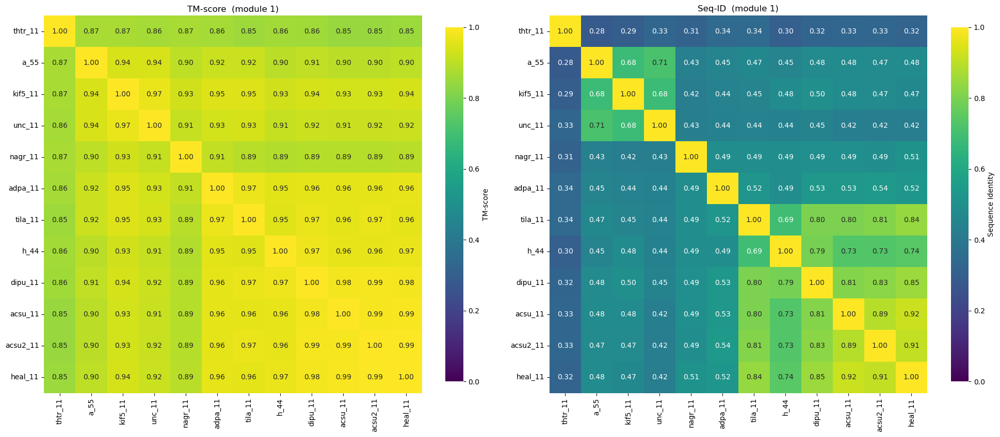


— module 2 —


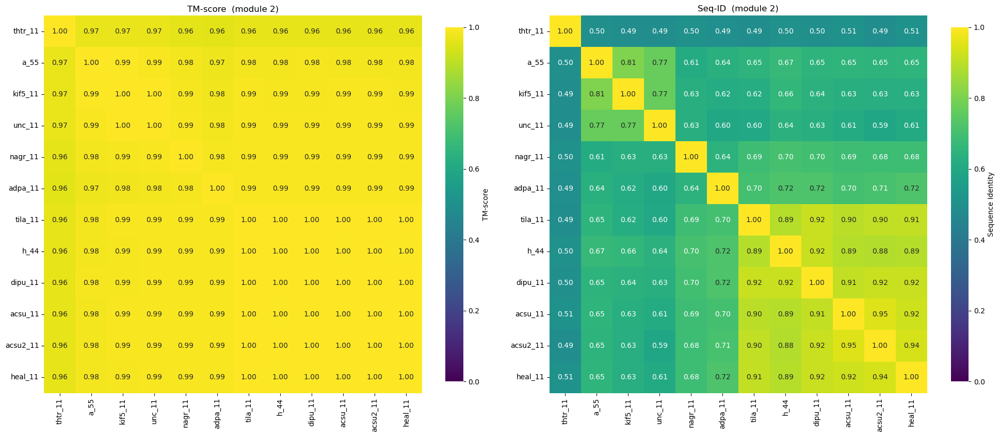


— module 3 —


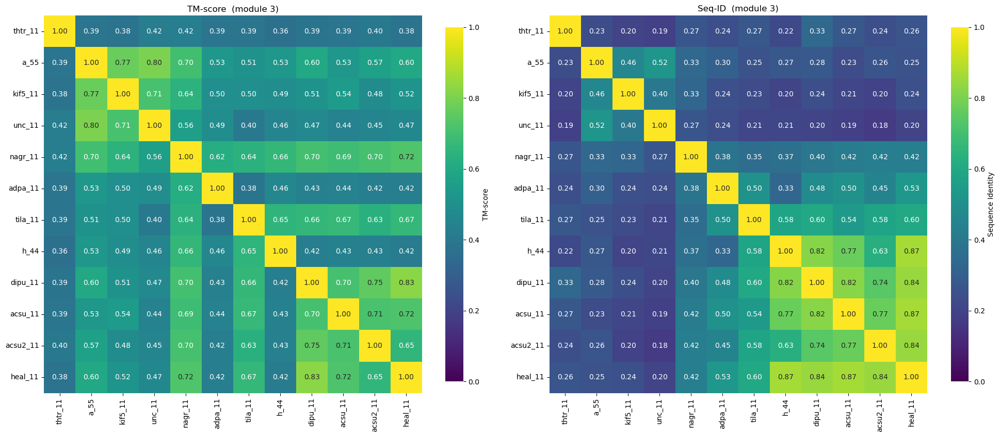


— b0-a0 —


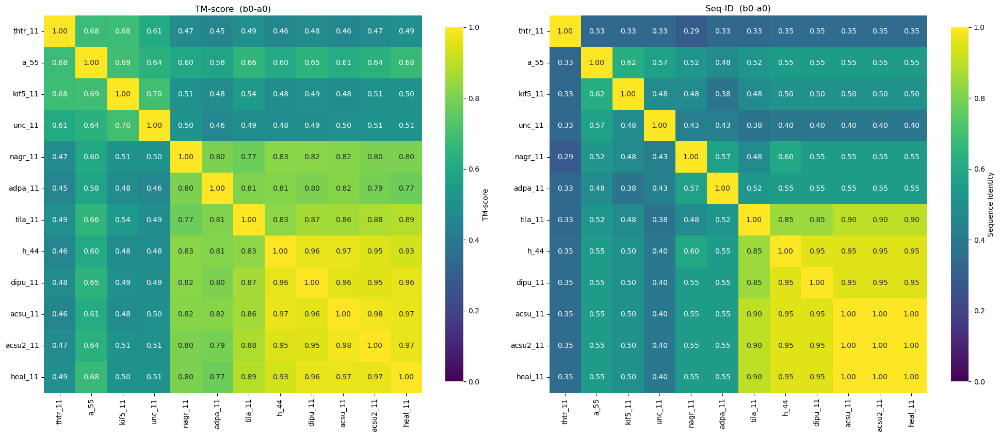


— b2 —


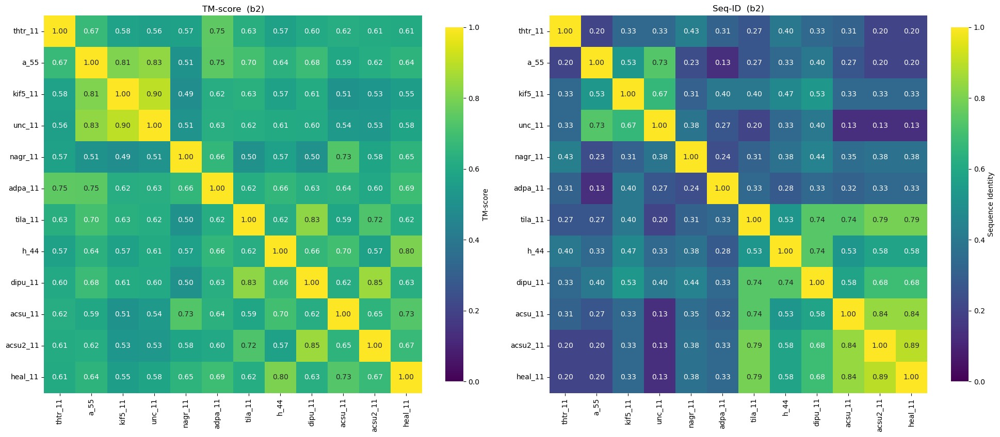


— a1 —


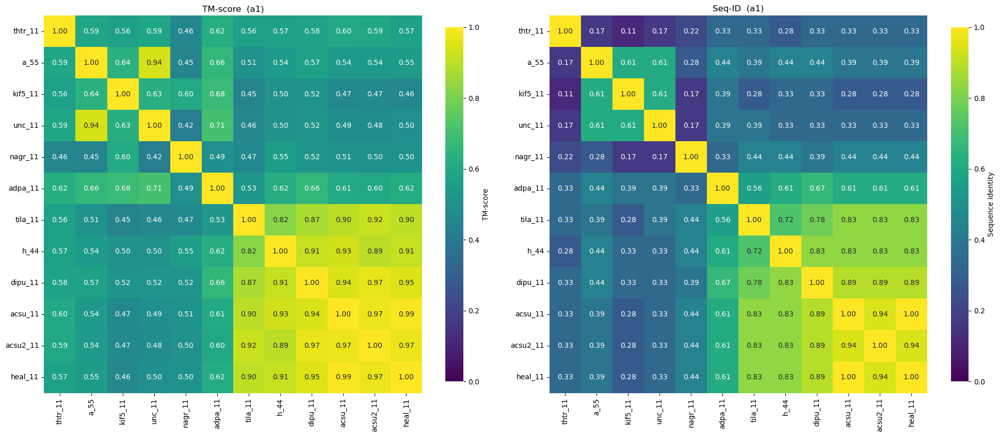


— b3-ploop —


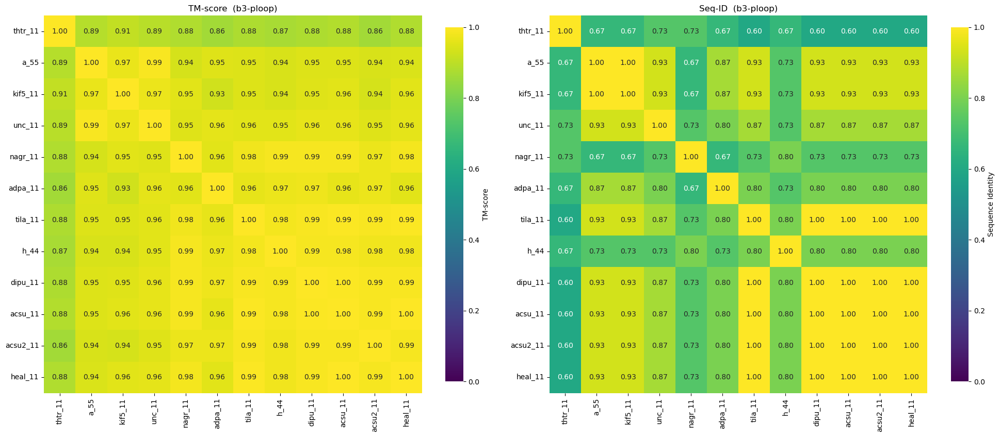


— L5 —


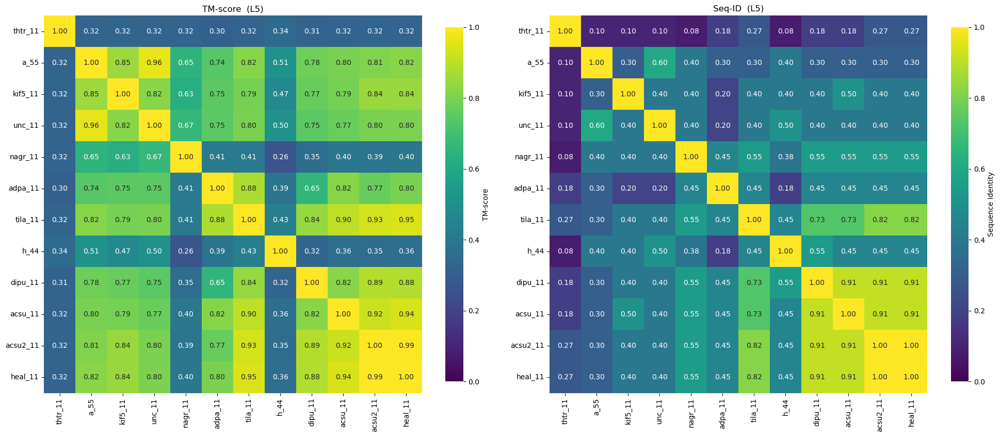


— a2 —


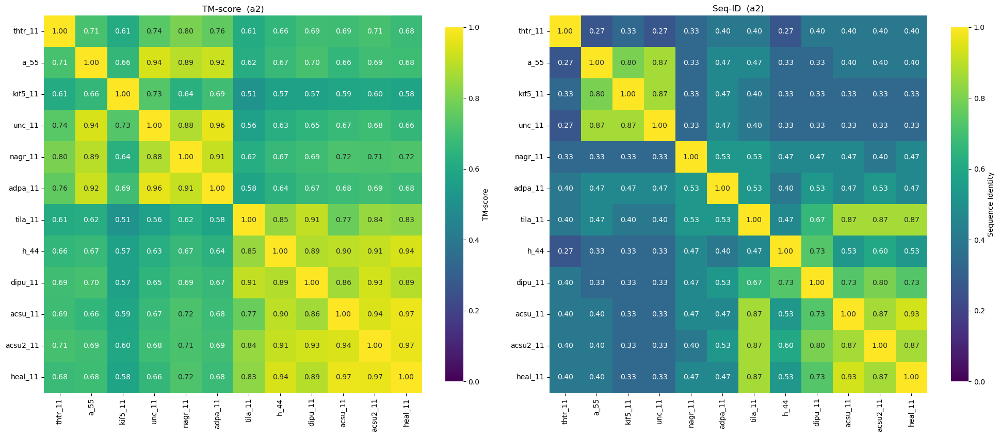


— b4 —


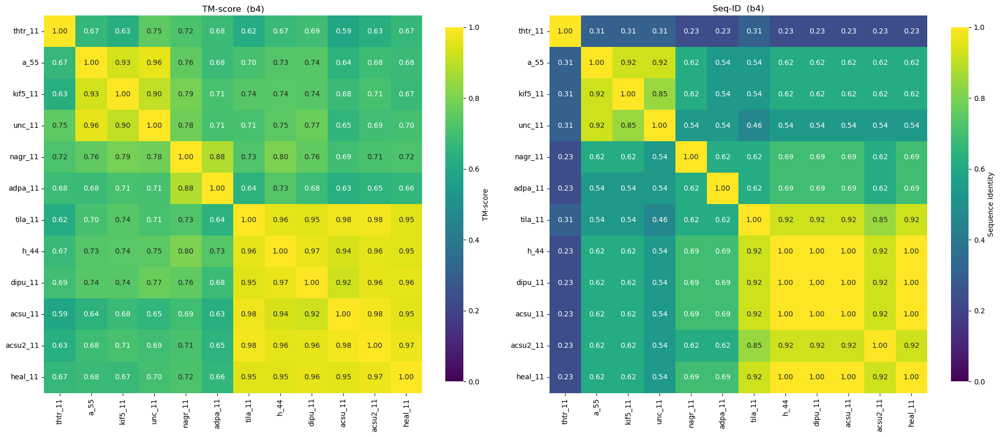


— L8-b5 —


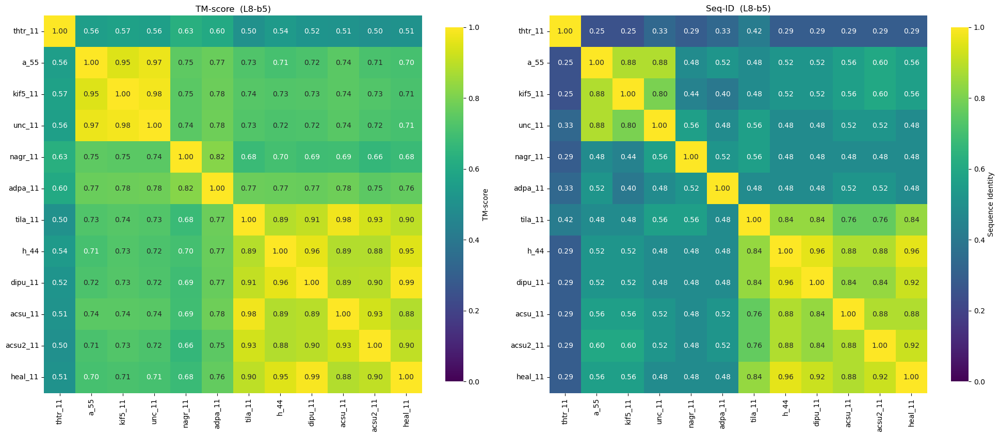


— a3 —


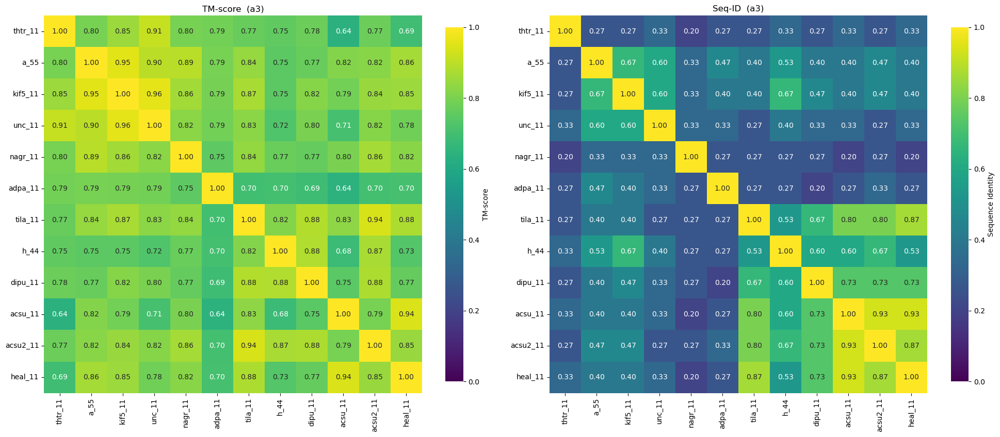


— L9-SwI —


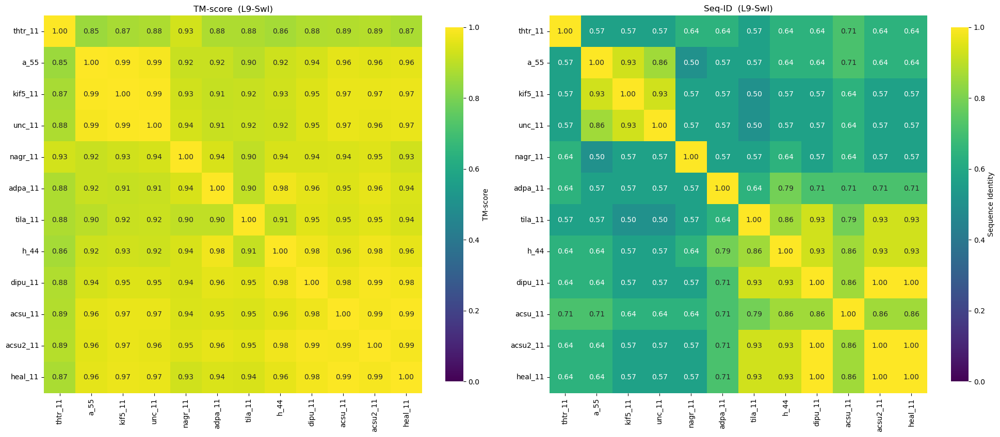


— b6 —


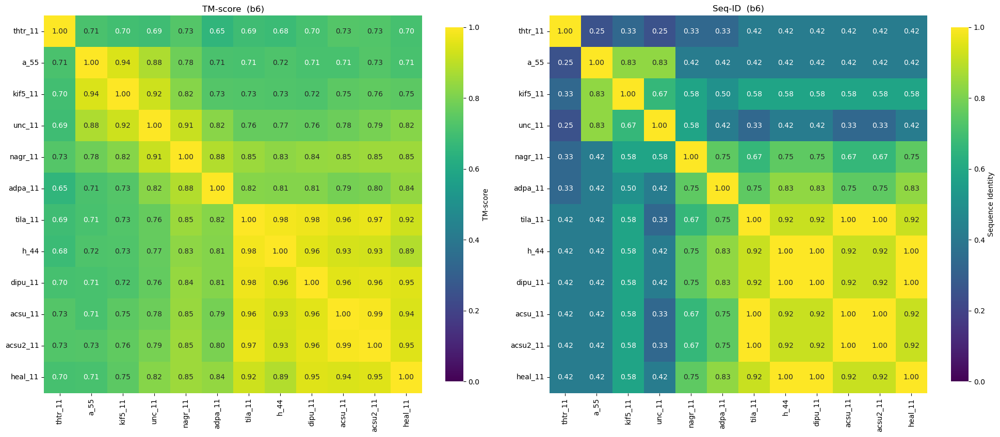


— b7 —


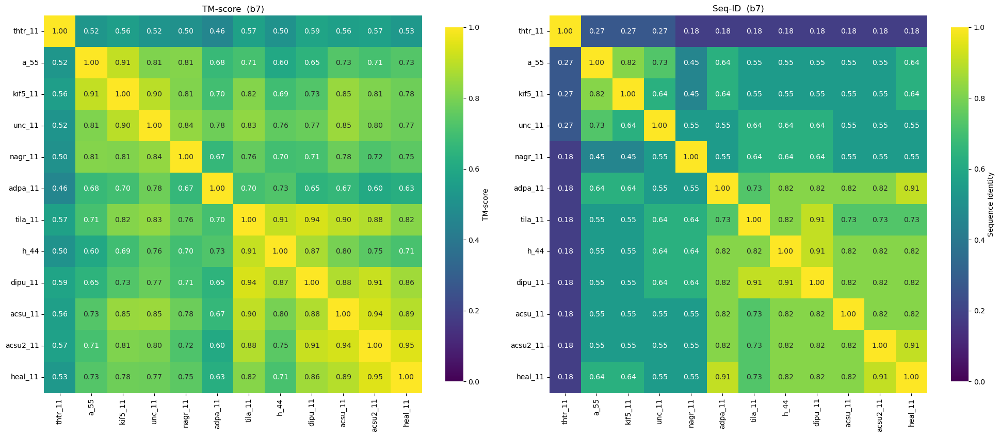


— L11-SwII —


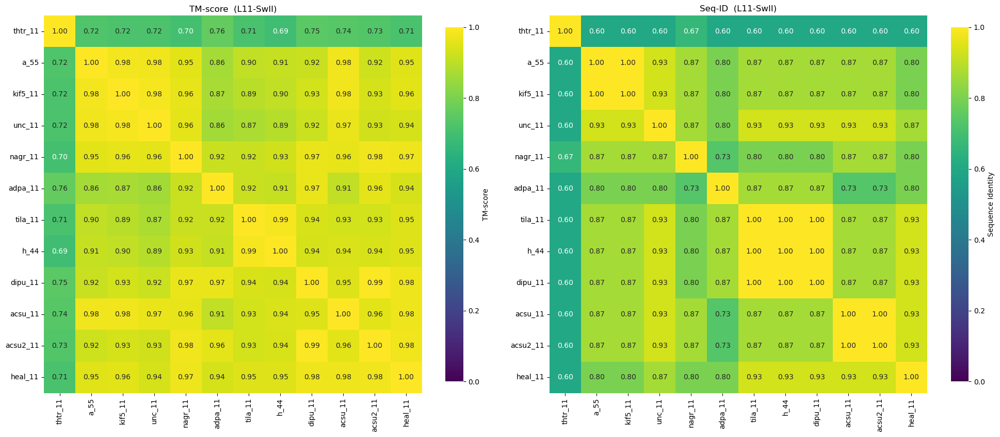


— a4 —


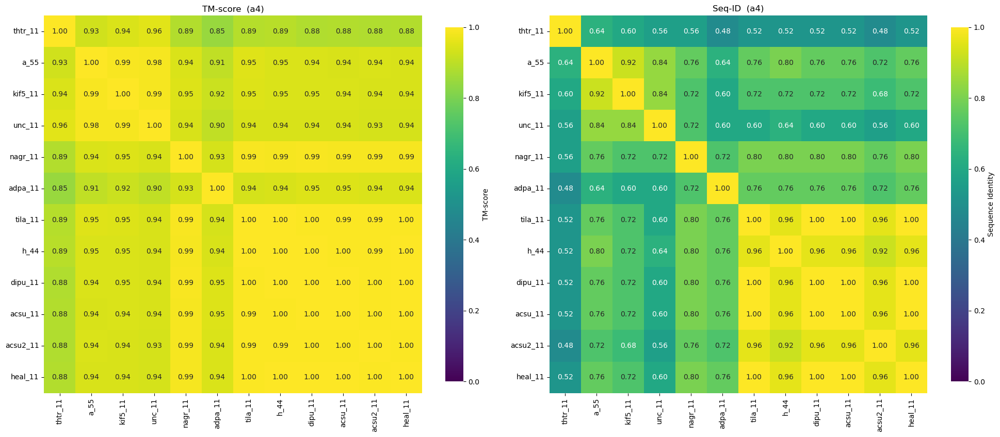


— L12 —


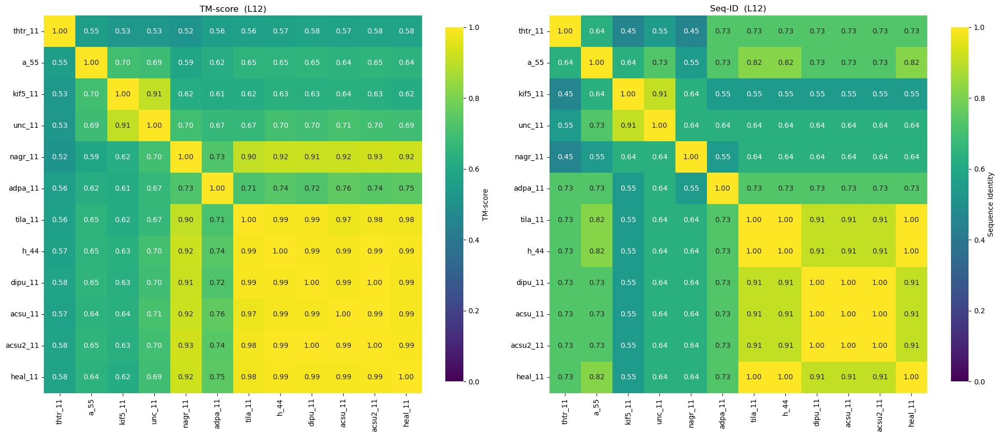


— a5 —


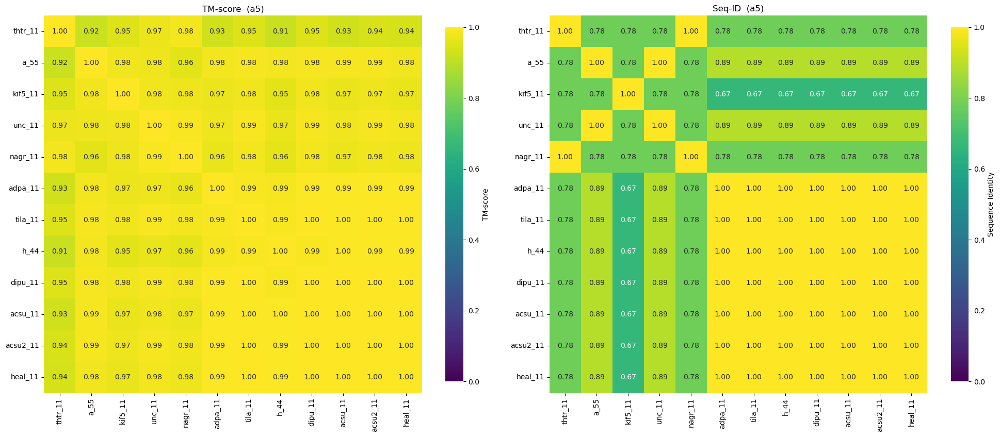


— b8-a6 —


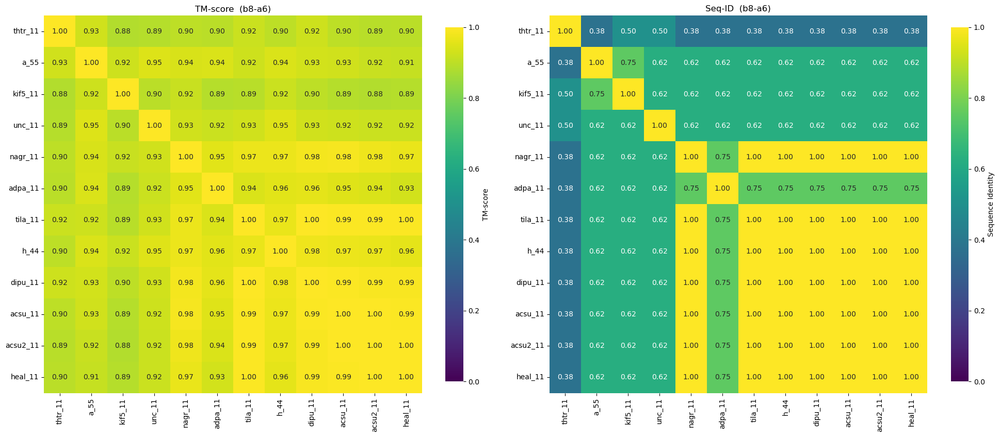


— a6 —


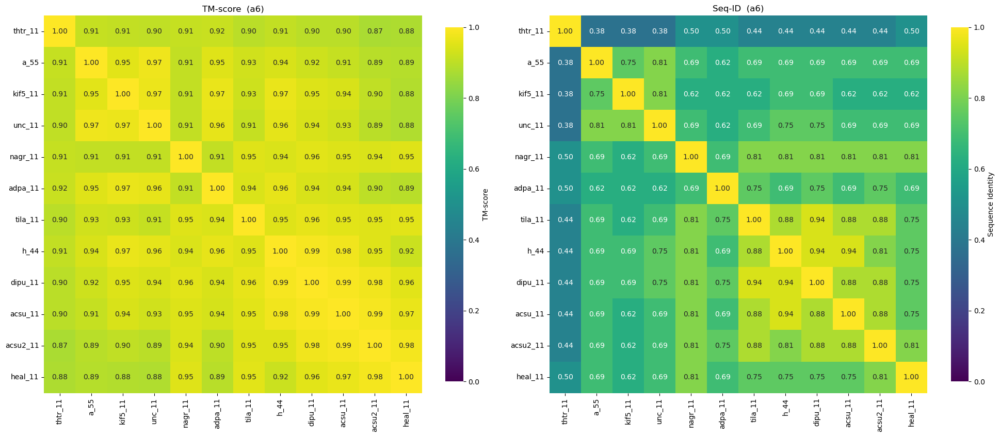


— neck —


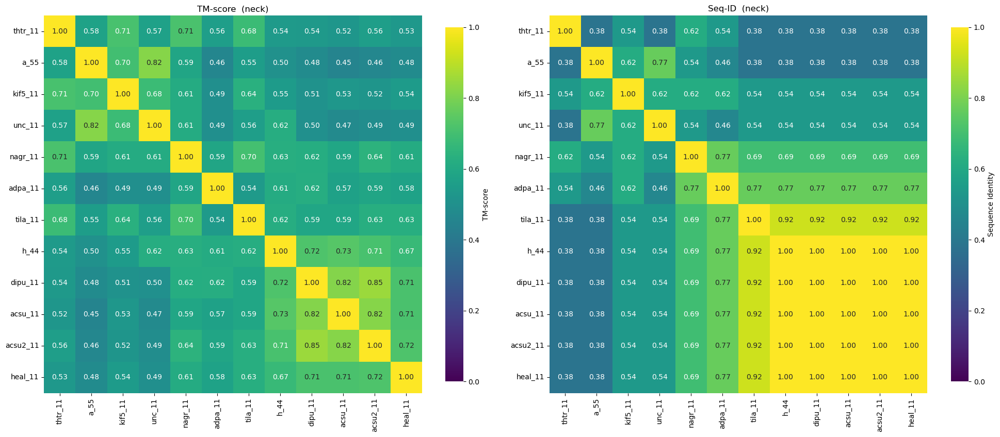


— coiled-coil —


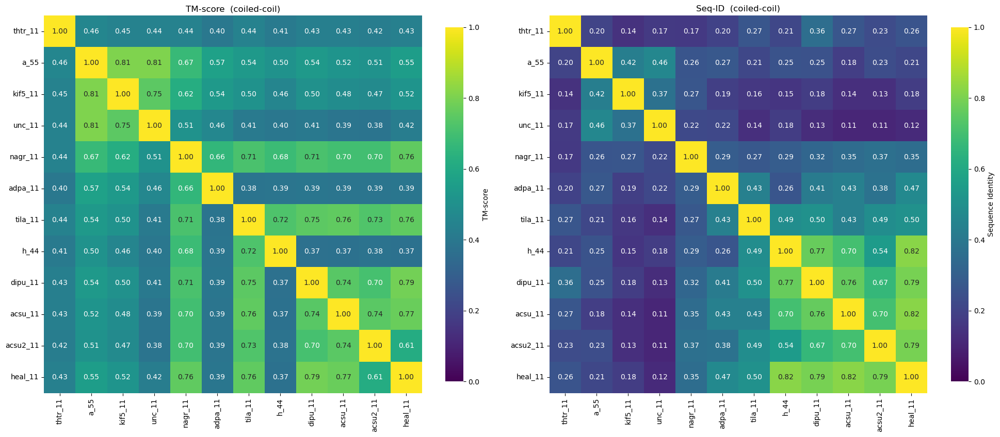


— full —


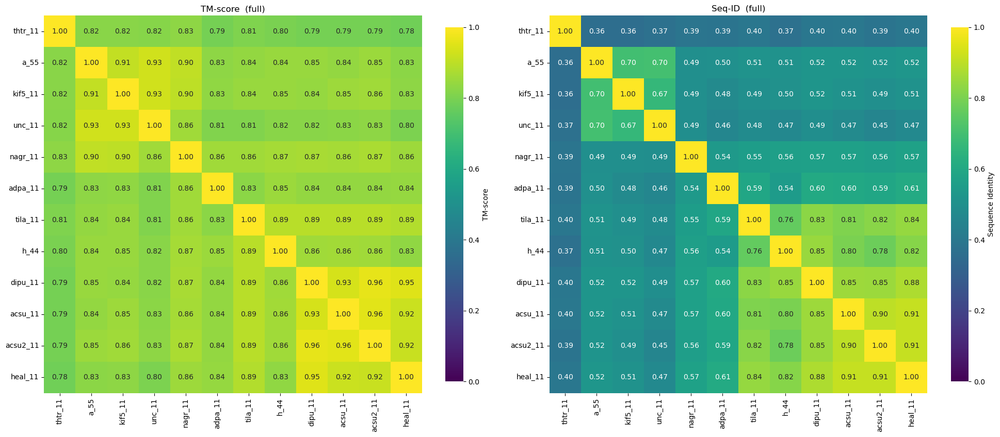


✓  Finished – trimmed PDBs in ../../data/3d_predictions/prodigy/trimmed_segments/<domain>/


In [25]:
#!/usr/bin/env python3
"""
Kinesin‑domain TM‑score & sequence‑identity pipeline (FIXED for single-chain structures)
========================================================================================

* Reads a Clustal multiple alignment.
* Uses **a_55** as reference to map **modules** (1‑3) and **sub‑domains**.
* Enriches the alignment DataFrame (`ali_df`) with two extra columns:
      ‑  ali_df["Module"]    :  "module 1" / "module 2" / "module 3" / "-"
      ‑  ali_df["Subdomain"] :  the sub‑domain name (e.g. "b3‑ploop") or "-"
* The structural/heat‑map part is FIXED to handle single-chain structures.
* Works with structures that have any chain ID (not just "A").

Copy‑&‑paste ready.
"""

# ---------------------------------------------------------------------
#  0.  USER FILES & CONSTANTS
# ---------------------------------------------------------------------
import os, subprocess, functools, numpy as np, pandas as pd, matplotlib.pyplot as plt, seaborn as sns
from Bio import AlignIO
from Bio.PDB import PDBParser, MMCIFParser, PDBIO, Select, Polypeptide

alignment_file = "../../../../Downloads/all"      # Clustal alignment
structure_paths = [
    "../../data/3d_predictions/prodigy/thtr_11.cif",
    # "../../data/3d_predictions/prodigy/ncd_11.cif",
    # "../../data/3d_predictions/prodigy/popa_11.cif",
    # "../../data/3d_predictions/prodigy/kif5_11.cif",
    # "../../data/3d_predictions/prodigy/a_55.pdb",
    # "../../data/3d_predictions/prodigy/unc_11.cif",
    # "../../data/3d_predictions/prodigy/nagr_11.cif",
    # "../../data/3d_predictions/prodigy/adpa_11.cif",
    # "../../data/3d_predictions/prodigy/tila_11.cif",
    # "../../data/3d_predictions/prodigy/h_44.pdb",
    # "../../data/3d_predictions/prodigy/dipu_11.cif",
    # "../../data/3d_predictions/prodigy/acsu_11.cif",
    # "../../data/3d_predictions/prodigy/acsu2_11.cif",
    # "../../data/3d_predictions/prodigy/heal_11.cif",


    "../../data/3d_predictions/prodigy/chain_A/a_55.pdb",
    # "../../data/3d_predictions/prodigy/chain_A/ncd_11.pdb",
    # "../../data/3d_predictions/prodigy/chain_A/popa_11.pdb",
    "../../data/3d_predictions/prodigy/chain_A/kif5_11.pdb",
    # "../../data/3d_predictions/prodigy/chain_A/a_55.pdb",
    "../../data/3d_predictions/prodigy/chain_A/unc_11.pdb",
    "../../data/3d_predictions/prodigy/chain_A/nagr_11.pdb",

    "../../data/3d_predictions/prodigy/chain_A/adpa_11.pdb",

    "../../data/3d_predictions/prodigy/chain_A/tila_11.pdb",
    "../../data/3d_predictions/prodigy/chain_A/h_44.pdb",
    "../../data/3d_predictions/prodigy/chain_A/dipu_11.pdb",
    "../../data/3d_predictions/prodigy/chain_A/acsu_11.pdb",

    "../../data/3d_predictions/prodigy/chain_A/acsu2_11.pdb",
    "../../data/3d_predictions/prodigy/chain_A/heal_11.pdb",

]
ref_name = "a_55"                                    # reference sequence ID

# ---------------------------------------------------------------------
#  1.  DOMAIN & MODULE DEFINITIONS (UNGAPPED, REF = a_55)
# ---------------------------------------------------------------------
domain_def_ref = {
    # ---------- modules & full ---------------------------------------
    "full":       "MSAEREIPAEDSIKVVCRFRPLNDSEEKAGSKFVVKFPNNVEENCISIAGKVYLFDKVF"
                  "KPNASQEKVYNEAAKSIVTDVLAGYNGTIFAYGQTSSGKTHTMEGVIGDSVKQGIIPRI"
                  "VNDIFNHIYAMEVNLEFHIKVSYYEIYMDKIRDLLDVSKVNLSVHEDKNRVPYVKGATE"
                  "RFVSSPEDVFEVIEEGKSNRHIAVTNMNEHSSRSHSVFLINVKQENLENQKKLSGKLYL"
                  "VDLAGSEKVSKTGAEGTVLDEAKNINKSLSALGNVISALADGNKTHIPYRDSKLTRILQ"
                  "ESLGGNARTTIVICCSPASFNESETKSTLDFGRRAKTVKNVVCVNEELTAEEWKRRYEKE"
                  "KEKNARLKGKVEKLEIELARWRAGETVKAEEQINMEDLMEASTPNL",
    "module 1":   "MSAEREIPAEDSIKVVCRFRPLNDSEEKAGSKFVVKFPNNVEENCISIAGKVYLFDKVF"
                  "KPNASQEKVYNEAAKSIVTDVLAGYNGTIFAYGQTSSGKTHTMEGVIGDSVKQGIIPRI"
                  "VNDIFNHIYAMEVNLEFHIKVSYYEIYMDKIRDLLDVSKVNLSVHEDKNRVPYVKGATERF",
    "module 2":   "VSSPEDVFEVIEEGKSNRHIAVTNMNEHSSRSHSVFLINVKQENLENQKKLSGKLYLVD"
                  "LAGSEKVSKTGAEGTVLDEAKNINKSLSALGNVISALADGNKTHIPYRDSKLTRILQESL"
                  "GGNARTTIVICCSPASFNESETKSTLDFGRRAKTVK",
    "module 3":   "NVVCVNEELTAEEWKRRYEKEKEKNARLKGKVEKLEIELARWRAGETVKAEEQINMEDL"
                  "MEASTPNL",
    # ---------- sub‑domains ------------------------------------------
    "b0-a0": "AEDSIKVVCRFRPLNDSEEKA",
    "b2": "CISIAGKVYLFDKVF",
    "a1": "QEKVYNEAAKSIVTDVLA",
    "b3-ploop": "GTIFAYGQTSSGKTH",
    "L5": "GVIGDSVKQG",
    "a2": "IIPRIVNDIFNHIYA",
    "b4": "LEFHIKVSYYEIY",
    "L8-b5": "KIRDLLDVSKVNLSVHEDKNRVPYV",
    "a3": "PEDVFEVIEEGKSNR",
    "L9-SwI": "HIAVTNMNEHSSRS",
    "b6": "HSVFLINVKQEN",
    "b7": "QKKLSGKLYLV",
    "L11-SwII": "DLAGSEKVSKTGAEG",
    "a4": "TVLDEAKNINKSLSALGNVISALAD",
    "L12": "GNKTHIPYRDS",
    "a5": "KLTRILQES",
    "b8-a6": "RTTIVICC",
    "a6": "ESETKSTLDFGRRAKT",
    "neck": "VKNVVCVNEELTA",
    "coiled-coil": "EEWKRRYEKEKEKNARLKGKVEKLEIELARWRAGETVKAEEQINMEDLMEASTPNL"
}

# split dictionaries --------------------------------------------------
modules_def_ref  = {k: v for k, v in domain_def_ref.items()
                    if k in ("full", "module 1", "module 2", "module 3")}
subdom_def_ref   = {k: v for k, v in domain_def_ref.items()
                    if k not in modules_def_ref}

# ---------------------------------------------------------------------
#  2.  READ ALIGNMENT, MAP RANGES
# ---------------------------------------------------------------------
print("· loading alignment …")
ali = AlignIO.read(alignment_file, "clustal")
ali_df = pd.DataFrame({rec.id: list(str(rec.seq)) for rec in ali})
if ref_name not in ali_df.columns:
    raise ValueError(f"Reference '{ref_name}' missing from alignment.")

ref_gapped   = ali_df[ref_name].tolist()
ungapped_idx = [i for i, aa in enumerate(ref_gapped) if aa != "-"]
ref_ungapped = "".join(aa for aa in ref_gapped if aa != "-")

def map_ranges(def_dict):
    rng = {}
    for name, subseq in def_dict.items():
        u0 = ref_ungapped.find(subseq)
        if u0 == -1:
            raise ValueError(f"Cannot map '{name}'")
        g0 = ungapped_idx[u0]
        g1 = ungapped_idx[u0 + len(subseq) - 1]
        rng[name] = (g0, g1)
    return rng

module_ranges   = map_ranges({k: v for k, v in modules_def_ref.items()
                              if k != "full"})       # exclude "full"
subdom_ranges   = map_ranges(subdom_def_ref)
domain_ranges   = {**module_ranges, **subdom_ranges, "full": map_ranges({"full": modules_def_ref["full"]})["full"]}

# ---------------------------------------------------------------------
#  3.  ADD "Module" & "Subdomain" COLUMNS TO ali_df
# ---------------------------------------------------------------------
module_labels    = ["-"] * len(ref_gapped)
for mod, (g0, g1) in module_ranges.items():
    for i in range(g0, g1 + 1):
        module_labels[i] = mod

subdom_labels    = ["-"] * len(ref_gapped)
for sd, (g0, g1) in subdom_ranges.items():
    for i in range(g0, g1 + 1):
        subdom_labels[i] = sd

ali_df.insert(0, "Module",    module_labels)
ali_df.insert(1, "Subdomain", subdom_labels)

# ---------------------------------------------------------------------
#  4.  BUILD per‑protein DOMAIN SEQ DICT (ungapped)
# ---------------------------------------------------------------------
protein_dom_seq = {}
for prot in ali_df.columns[2:]:               # skip Module/Subdomain cols
    d = {}
    for dom, (g0, g1) in domain_ranges.items():
        d[dom] = "".join(ali_df.loc[g0:g1, prot]).replace("-", "")
    protein_dom_seq[prot] = d

domain_list = list(domain_ranges.keys())

# ---------------------------------------------------------------------
#  5.  STRUCTURE HELPERS (FIXED for single-chain structures)
# ---------------------------------------------------------------------
class Keep(Select):
    def __init__(self, keep, chain_id): 
        self.keep = keep
        self.chain_id = chain_id
    def accept_residue(self, r): 
        return r.get_parent().id == self.chain_id and r.get_id() in self.keep

def get_chain_sequence(path):
    """Get sequence from the first available chain (works for single-chain structures)"""
    parser = PDBParser(QUIET=True) if path.lower().endswith(".pdb") else MMCIFParser(QUIET=True)
    s = parser.get_structure("s", path)
    
    # Get all chains
    chains = list(s[0].get_chains())
    if not chains:
        raise ValueError(f"No chains found in {path}")
    
    # Use the first chain (for single-chain structures, this is the only chain)
    chain = chains[0]
    chain_id = chain.id
    
    seq, ids = [], []
    for res in chain:
        if Polypeptide.is_aa(res, standard=True):
            seq.append(Polypeptide.three_to_one(res.get_resname()))
            ids.append(res.get_id())
    
    return "".join(seq), ids, chain_id

def save_trim(src, dst, keep_ids, chain_id):
    parser = PDBParser(QUIET=True) if src.lower().endswith(".pdb") else MMCIFParser(QUIET=True)
    s = parser.get_structure("s", src)
    io = PDBIO()
    io.set_structure(s)
    io.save(dst, Keep(keep_ids, chain_id))

import functools, subprocess, numpy as np
@functools.lru_cache(maxsize=None)
def tm_score(p1, p2):
    out = subprocess.run(["USalign", p1, p2], stdout=subprocess.PIPE, text=True).stdout
    for ln in out.splitlines():
        if ln.startswith("TM-score="):
            try: return float(ln.split("=")[1].split()[0])
            except ValueError: break
    return np.nan

# ---------------------------------------------------------------------
#  6.  READ STRUCTURES
# ---------------------------------------------------------------------
structure_map = {os.path.splitext(os.path.basename(p))[0]: p for p in structure_paths}
structures    = [os.path.splitext(os.path.basename(p))[0] for p in structure_paths
                 if os.path.splitext(os.path.basename(p))[0] in protein_dom_seq]

# FIXED: Use the new function that returns chain_id as well
seq_cache     = {prot: get_chain_sequence(structure_map[prot]) for prot in structures}

# ---------------------------------------------------------------------
#  7.  MAIN LOOP – heat‑maps (FIXED logic)
# ---------------------------------------------------------------------
for dom in domain_list:
    print(f"\n— {dom} —")
    g0, g1 = domain_ranges[dom]
    dom_align = ali_df.loc[g0:g1, structures]        # slice with Module/Subdomain removed

    # ---------- trim structures --------------------------------------
    trimmed = {}
    for prot in structures:
        dom_seq = protein_dom_seq[prot][dom]
        full_seq, ids, chain_id = seq_cache[prot]  # FIXED: unpack chain_id
        idx = full_seq.find(dom_seq)
        if idx == -1:
            raise ValueError(f"{dom} not found in chain {chain_id} of {prot}")
        keep_ids = set(ids[idx : idx + len(dom_seq)])
        out_dir  = f"../../data/3d_predictions/prodigy/trimmed_segments/{dom}"
        os.makedirs(out_dir, exist_ok=True)
        out_pdb  = os.path.join(out_dir, f"{prot}_{dom}.pdb")
        save_trim(structure_map[prot], out_pdb, keep_ids, chain_id)  # FIXED: pass chain_id
        trimmed[prot] = out_pdb

    # ---------- matrices --------------------------------------------
    tm_mat = pd.DataFrame(index=structures, columns=structures, dtype=float)
    id_mat = pd.DataFrame(index=structures, columns=structures, dtype=float)

    for i, a in enumerate(structures):
        for j, b in enumerate(structures):
            if j < i:
                tm_mat.iat[i, j] = tm_mat.iat[j, i]
                id_mat.iat[i, j] = id_mat.iat[j, i]
                continue
            col_a, col_b = dom_align[a], dom_align[b]
            mask = (col_a != '-') & (col_b != '-')
            id_mat.iat[i, j] = ((col_a == col_b) & mask).sum() / mask.sum() if mask.any() else np.nan
            tm_mat.iat[i, j] = tm_score(trimmed[a], trimmed[b])

    # ---------- plot -------------------------------------------------
    plt.figure(figsize=(20, 9))
    plt.subplot(1, 2, 1)
    sns.heatmap(tm_mat, annot=True, fmt=".2f", cmap="viridis",
                vmin=0, vmax=1, square=True, cbar_kws={"label": "TM‑score", "shrink": 0.8})
    plt.title(f"TM‑score  ({dom})")
    plt.subplot(1, 2, 2)
    sns.heatmap(id_mat, annot=True, fmt=".2f", cmap="viridis",
                vmin=0, vmax=1, square=True, cbar_kws={"label": "Sequence Identity", "shrink": 0.8})
    plt.title(f"Seq‑ID  ({dom})")
    plt.tight_layout()
    plt.show()
    plt.close()

print("\n✓  Finished – trimmed PDBs in ../../data/3d_predictions/prodigy/trimmed_segments/<domain>/")

# ---------------------------------------------------------------------
#  8.  OPTIONAL – inspect the enriched alignment DataFrame
# ---------------------------------------------------------------------
# print(ali_df.head(30))  # uncomment to preview Module / Subdomain labels

In [ ]:
#!/usr/bin/env python3
"""
Kinesin‑domain TM‑score & sequence‑identity pipeline
===================================================

* Reads a Clustal multiple alignment.
* Uses **a_55** as reference to map **modules** (1‑3) and **sub‑domains**.
* Enriches the alignment DataFrame (`ali_df`) with two extra columns:
      ‑  ali_df["Module"]    :  "module 1" / "module 2" / "module 3" / "-"
      ‑  ali_df["Subdomain"] :  the sub‑domain name (e.g. "b3‑ploop") or "-"
* The structural/heat‑map part is unchanged: exact AA lookup, trimming,
  USalign, TM‑score + Seq‑ID heat‑maps.

Copy‑&‑paste ready.
"""

# ---------------------------------------------------------------------
#  0.  USER FILES & CONSTANTS
# ---------------------------------------------------------------------
alignment_file = "../../../../Downloads/all"      # Clustal alignment
structure_paths = [
    "../../data/3d_predictions/prodigy/ncd_11.cif",
    "../../data/3d_predictions/prodigy/thtr_11.cif",
    "../../data/3d_predictions/prodigy/popa_11.cif",
    "../../data/3d_predictions/prodigy/kif5_11.cif",
    "../../data/3d_predictions/prodigy/unc_11.cif",

    "../../data/3d_predictions/prodigy/a_55.pdb",
    "../../data/3d_predictions/prodigy/c_123.pdb",

    "../../data/3d_predictions/prodigy/e_234.pdb",
    "../../data/3d_predictions/prodigy/g_123.pdb",

    "../../data/3d_predictions/prodigy/nagr_11.cif",
    "../../data/3d_predictions/prodigy/adpa_11.cif",

    "../../data/3d_predictions/prodigy/tila_11.cif",
    "../../data/3d_predictions/prodigy/acsu_11.cif",
    "../../data/3d_predictions/prodigy/acsu2_11.cif",
    "../../data/3d_predictions/prodigy/heal_11.cif",

    "../../data/3d_predictions/prodigy/dipu_11.cif",

    "../../data/3d_predictions/prodigy/b_345.pdb",
    "../../data/3d_predictions/prodigy/d_55.pdb",

    "../../data/3d_predictions/prodigy/f_456.pdb",
    "../../data/3d_predictions/prodigy/h_44.pdb",

    # "../../data/3d_predictions/prodigy/blesto_11.cif",
    # "../../data/3d_predictions/prodigy/blesto2_11.cif",



]
ref_name = "a_55"                                    # reference sequence ID

# ---------------------------------------------------------------------
#  1.  DOMAIN & MODULE DEFINITIONS (UNGAPPED, REF = a_55)
# ---------------------------------------------------------------------
domain_def_ref = {
    # ---------- modules & full ---------------------------------------
    "full":       "MSAEREIPAEDSIKVVCRFRPLNDSEEKAGSKFVVKFPNNVEENCISIAGKVYLFDKVF"
                  "KPNASQEKVYNEAAKSIVTDVLAGYNGTIFAYGQTSSGKTHTMEGVIGDSVKQGIIPRI"
                  "VNDIFNHIYAMEVNLEFHIKVSYYEIYMDKIRDLLDVSKVNLSVHEDKNRVPYVKGATE"
                  "RFVSSPEDVFEVIEEGKSNRHIAVTNMNEHSSRSHSVFLINVKQENLENQKKLSGKLYL"
                  "VDLAGSEKVSKTGAEGTVLDEAKNINKSLSALGNVISALADGNKTHIPYRDSKLTRILQ"
                  "ESLGGNARTTIVICCSPASFNESETKSTLDFGRRAKTVKNVVCVNEELTAEEWKRRYEKE"
                  "KEKNARLKGKVEKLEIELARWRAGETVKAEEQINMEDLMEASTPNL",
    "module 1":   "MSAEREIPAEDSIKVVCRFRPLNDSEEKAGSKFVVKFPNNVEENCISIAGKVYLFDKVF"
                  "KPNASQEKVYNEAAKSIVTDVLAGYNGTIFAYGQTSSGKTHTMEGVIGDSVKQGIIPRI"
                  "VNDIFNHIYAMEVNLEFHIKVSYYEIYMDKIRDLLDVSKVNLSVHEDKNRVPYVKGATERF",
    "module 2":   "VSSPEDVFEVIEEGKSNRHIAVTNMNEHSSRSHSVFLINVKQENLENQKKLSGKLYLVD"
                  "LAGSEKVSKTGAEGTVLDEAKNINKSLSALGNVISALADGNKTHIPYRDSKLTRILQESL"
                  "GGNARTTIVICCSPASFNESETKSTLDFGRRAKTVK",
    "module 3":   "NVVCVNEELTAEEWKRRYEKEKEKNARLKGKVEKLEIELARWRAGETVKAEEQINMEDL"
                  "MEASTPNL",
    # ---------- sub‑domains ------------------------------------------
    "a0": "KVVCRFRPLNDSEEKA",
    "b2": "CISIAGKVYLFDKVF",
    "a1": "QEKVYNEAAKSIVTDVLA",
    "b3-ploop": "GTIFAYGQTSSGKTH",
    "L5": "GVIGDSVKQG",
    "a2": "IIPRIVNDIFNHIYA",
    "b4": "LEFHIKVSYYEIY",
    "L8-b5": "KIRDLLDVSKVNLSVHEDKNRVPYV",
    "a3": "PEDVFEVIEEGKSNR",
    "L9-SwI": "HIAVTNMNEHSSRS",
    "b6": "HSVFLINVKQEN",
    "b7": "QKKLSGKLYLV",
    "L11-SwII": "DLAGSEKVSKTGAEG",
    "a4": "TVLDEAKNINKSLSALGNVISALAD",
    "L12": "GNKTHIPYRDS",
    "a5": "KLTRILQES",
    "b8-a6": "RTTIVICC",
    "a6": "ESETKSTLDFGRRAKT",
    "neck": "VKNVVCVNEELTA",
    "coiled-coil": "EEWKRRYEKEKEKNARLKGKVEKLEIELARWRAGETVKAEEQINMEDLMEASTPNL"
}

# split dictionaries --------------------------------------------------
modules_def_ref  = {k: v for k, v in domain_def_ref.items()
                    if k in ("full", "module 1", "module 2", "module 3")}
subdom_def_ref   = {k: v for k, v in domain_def_ref.items()
                    if k not in modules_def_ref}

# ---------------------------------------------------------------------
#  2.  READ ALIGNMENT, MAP RANGES
# ---------------------------------------------------------------------
from Bio import AlignIO
print("· loading alignment …")
ali = AlignIO.read(alignment_file, "clustal")
ali_df = pd.DataFrame({rec.id: list(str(rec.seq)) for rec in ali})
if ref_name not in ali_df.columns:
    raise ValueError(f"Reference '{ref_name}' missing from alignment.")

ref_gapped   = ali_df[ref_name].tolist()
ungapped_idx = [i for i, aa in enumerate(ref_gapped) if aa != "-"]
ref_ungapped = "".join(aa for aa in ref_gapped if aa != "-")

def map_ranges(def_dict):
    rng = {}
    for name, subseq in def_dict.items():
        u0 = ref_ungapped.find(subseq)
        if u0 == -1:
            raise ValueError(f"Cannot map '{name}'")
        g0 = ungapped_idx[u0]
        g1 = ungapped_idx[u0 + len(subseq) - 1]
        rng[name] = (g0, g1)
    return rng

module_ranges   = map_ranges({k: v for k, v in modules_def_ref.items()
                              if k != "full"})       # exclude "full"
subdom_ranges   = map_ranges(subdom_def_ref)
domain_ranges   = {**module_ranges, **subdom_ranges, "full": map_ranges({"full": modules_def_ref["full"]})["full"]}

# ---------------------------------------------------------------------
#  3.  ADD "Module" & "Subdomain" COLUMNS TO ali_df
# ---------------------------------------------------------------------
module_labels    = ["-"] * len(ref_gapped)
for mod, (g0, g1) in module_ranges.items():
    for i in range(g0, g1 + 1):
        module_labels[i] = mod

subdom_labels    = ["-"] * len(ref_gapped)
for sd, (g0, g1) in subdom_ranges.items():
    for i in range(g0, g1 + 1):
        subdom_labels[i] = sd

ali_df.insert(0, "Module",    module_labels)
ali_df.insert(1, "Subdomain", subdom_labels)

# ---------------------------------------------------------------------
#  4.  BUILD per‑protein DOMAIN SEQ DICT (ungapped)
# ---------------------------------------------------------------------
protein_dom_seq = {}
for prot in ali_df.columns[2:]:               # skip Module/Subdomain cols
    d = {}
    for dom, (g0, g1) in domain_ranges.items():
        d[dom] = "".join(ali_df.loc[g0:g1, prot]).replace("-", "")
    protein_dom_seq[prot] = d

domain_list = list(domain_ranges.keys())

# ---------------------------------------------------------------------
#  5.  STRUCTURE HELPERS (unchanged)
# ---------------------------------------------------------------------
from Bio.PDB import PDBParser, MMCIFParser, PDBIO, Select, Polypeptide
class Keep(Select):
    def __init__(self, keep): self.keep = keep
    def accept_residue(self, r): return r.get_parent().id == "A" and r.get_id() in self.keep

def chainA_sequence(path):
    parser = PDBParser(QUIET=True) if path.lower().endswith(".pdb") else MMCIFParser(QUIET=True)
    s = parser.get_structure("s", path)
    chain = s[0]["A"]
    seq, ids = [], []
    for res in chain:
        if Polypeptide.is_aa(res, standard=True):
            seq.append(Polypeptide.three_to_one(res.get_resname()))
            ids.append(res.get_id())
    return "".join(seq), ids

def save_trim(src, dst, keep_ids):
    parser = PDBParser(QUIET=True) if src.lower().endswith(".pdb") else MMCIFParser(QUIET=True)
    s = parser.get_structure("s", src)
    io = PDBIO(); io.set_structure(s); io.save(dst, Keep(keep_ids))

import functools, subprocess, numpy as np
@functools.lru_cache(maxsize=None)
def tm_score(p1, p2):
    out = subprocess.run(["USalign", p1, p2], stdout=subprocess.PIPE, text=True).stdout
    for ln in out.splitlines():
        if ln.startswith("TM-score="):
            try: return float(ln.split("=")[1].split()[0])
            except ValueError: break
    return np.nan

# ---------------------------------------------------------------------
#  6.  READ STRUCTURES
# ---------------------------------------------------------------------
structure_map = {os.path.splitext(os.path.basename(p))[0]: p for p in structure_paths}
structures    = [os.path.splitext(os.path.basename(p))[0] for p in structure_paths
                 if os.path.splitext(os.path.basename(p))[0] in protein_dom_seq]
seq_cache     = {prot: chainA_sequence(structure_map[prot]) for prot in structures}

# ---------------------------------------------------------------------
#  7.  MAIN LOOP – heat‑maps (unchanged logic)
# ---------------------------------------------------------------------
import matplotlib.pyplot as plt, seaborn as sns, os

for dom in domain_list:
    print(f"\n— {dom} —")
    g0, g1 = domain_ranges[dom]
    dom_align = ali_df.loc[g0:g1, structures]        # slice with Module/Subdomain removed

    # ---------- trim structures --------------------------------------
    trimmed = {}
    for prot in structures:
        dom_seq = protein_dom_seq[prot][dom]
        full_seq, ids = seq_cache[prot]
        idx = full_seq.find(dom_seq)
        if idx == -1:
            raise ValueError(f"{dom} not found in chain A of {prot}")
        keep_ids = set(ids[idx : idx + len(dom_seq)])
        out_dir  = f"../../data/3d_predictions/prodigy/trimmed_segments/{dom}"
        os.makedirs(out_dir, exist_ok=True)
        out_pdb  = os.path.join(out_dir, f"{prot}_{dom}.pdb")
        save_trim(structure_map[prot], out_pdb, keep_ids)
        trimmed[prot] = out_pdb

    # ---------- matrices --------------------------------------------
    tm_mat = pd.DataFrame(index=structures, columns=structures, dtype=float)
    id_mat = pd.DataFrame(index=structures, columns=structures, dtype=float)

    for i, a in enumerate(structures):
        for j, b in enumerate(structures):
            if j < i:
                tm_mat.iat[i, j] = tm_mat.iat[j, i]
                id_mat.iat[i, j] = id_mat.iat[j, i]
                continue
            col_a, col_b = dom_align[a], dom_align[b]
            mask = (col_a != '-') & (col_b != '-')
            id_mat.iat[i, j] = ((col_a == col_b) & mask).sum() / mask.sum() if mask.any() else np.nan
            tm_mat.iat[i, j] = tm_score(trimmed[a], trimmed[b])

    # ---------- plot -------------------------------------------------
    plt.figure(figsize=(20, 9))
    plt.subplot(1, 2, 1)
    sns.heatmap(tm_mat, annot=False, fmt=".2f", cmap="viridis",
                vmin=0, vmax=1, square=True, cbar_kws={"label": "TM‑score", "shrink": 0.8})
    plt.title(f"TM‑score  ({dom})")
    plt.subplot(1, 2, 2)
    sns.heatmap(id_mat, annot=False, fmt=".2f", cmap="inferno",
                vmin=0, vmax=1, square=True, cbar_kws={"label": "Sequence Identity", "shrink": 0.8})
    plt.title(f"Seq‑ID  ({dom})")
    plt.tight_layout()
    plt.show()
    plt.close()

print("\n✓  Finished – trimmed PDBs in ../../data/3d_predictions/prodigy/trimmed_segments/<domain>/")

# ---------------------------------------------------------------------
#  8.  OPTIONAL – inspect the enriched alignment DataFrame
# ---------------------------------------------------------------------
# print(ali_df.head(30))  # uncomment to preview Module / Subdomain labels

· loading alignment …


/Users/dalarios/anaconda3/lib/python3.11/site-packages/Bio/PDB/Polypeptide.py:144: BiopythonDeprecationWarning: 'three_to_one' will be deprecated in a future release of Biopython in favor of 'Bio.PDB.Polypeptide.protein_letters_3to1'.
  warnings.warn(
/Users/dalarios/anaconda3/lib/python3.11/site-packages/Bio/PDB/Polypeptide.py:144: BiopythonDeprecationWarning: 'three_to_one' will be deprecated in a future release of Biopython in favor of 'Bio.PDB.Polypeptide.protein_letters_3to1'.
  warnings.warn(
/Users/dalarios/anaconda3/lib/python3.11/site-packages/Bio/PDB/Polypeptide.py:144: BiopythonDeprecationWarning: 'three_to_one' will be deprecated in a future release of Biopython in favor of 'Bio.PDB.Polypeptide.protein_letters_3to1'.
  warnings.warn(
/Users/dalarios/anaconda3/lib/python3.11/site-packages/Bio/PDB/Polypeptide.py:144: BiopythonDeprecationWarning: 'three_to_one' will be deprecated in a future release of Biopython in favor of 'Bio.PDB.Polypeptide.protein_letters_3to1'.
  warning


— module 1 —


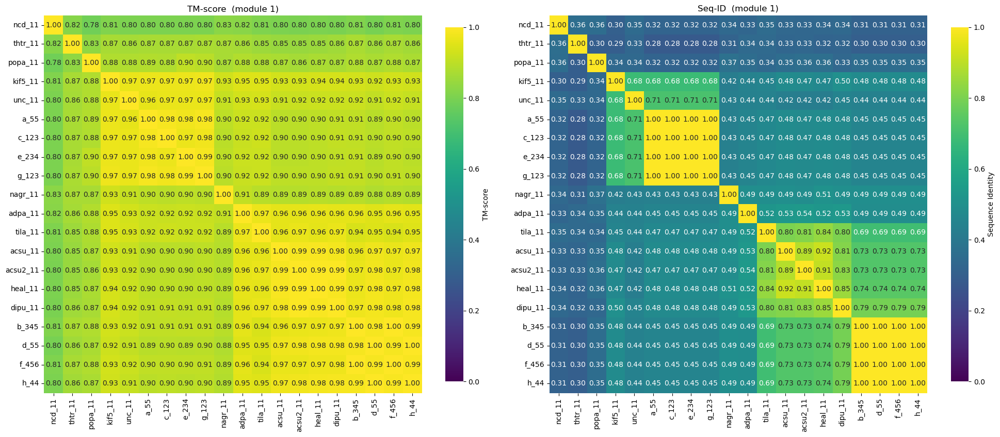


— module 2 —


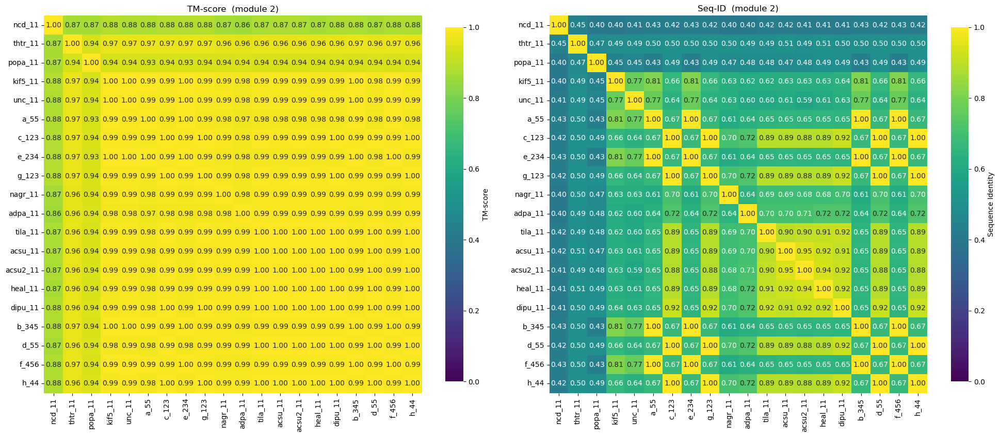


— module 3 —


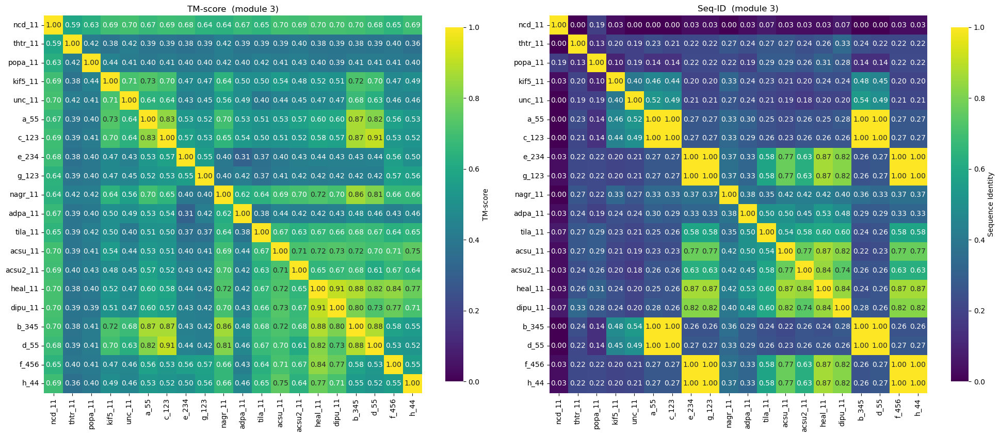


— b0-a0 —


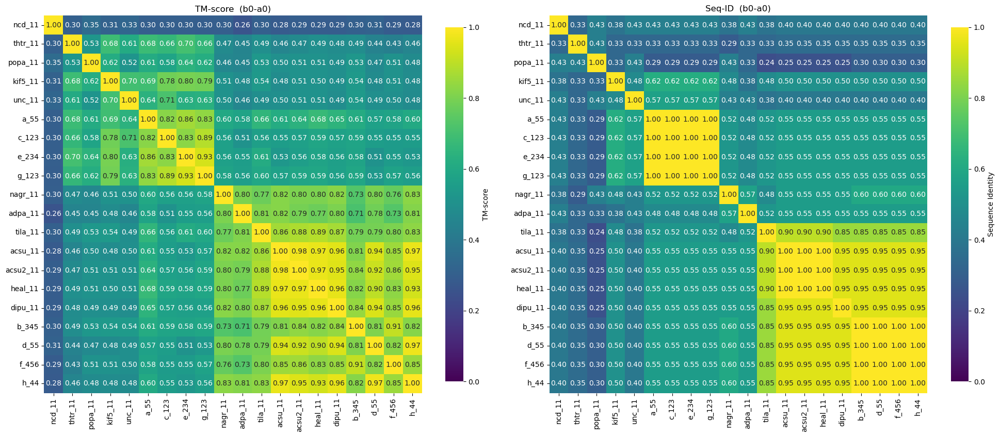


— b2 —


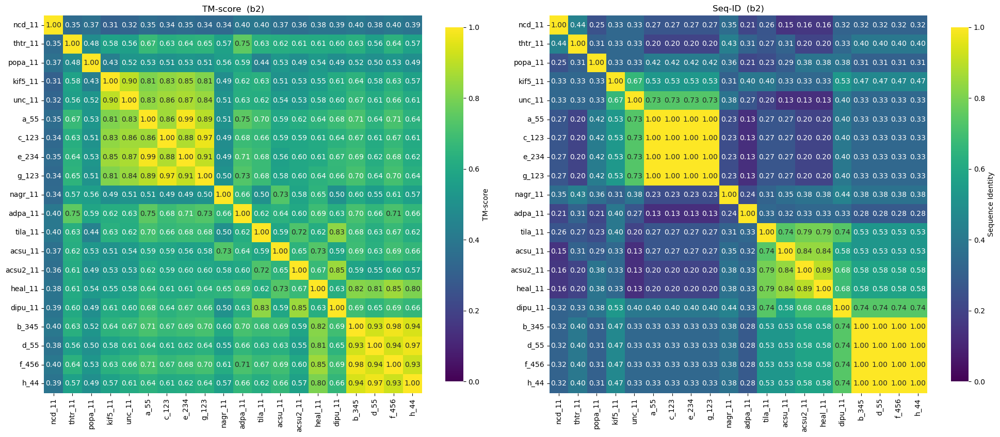


— a1 —


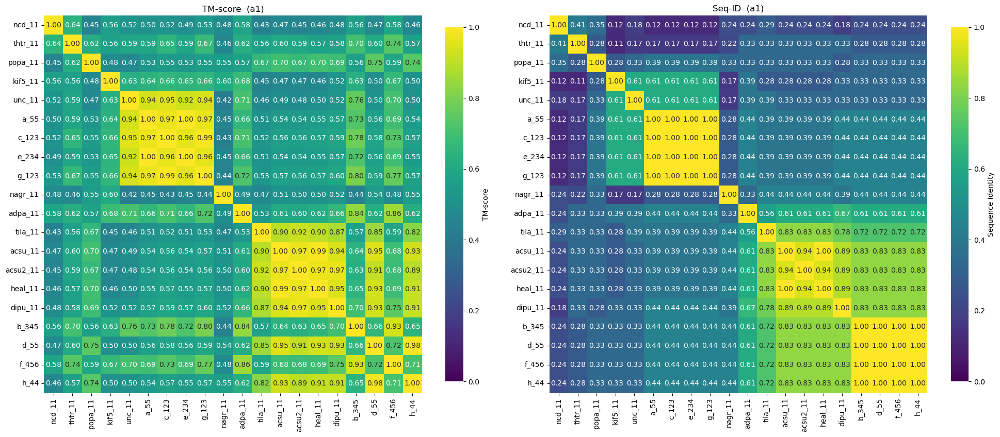


— b3-ploop —


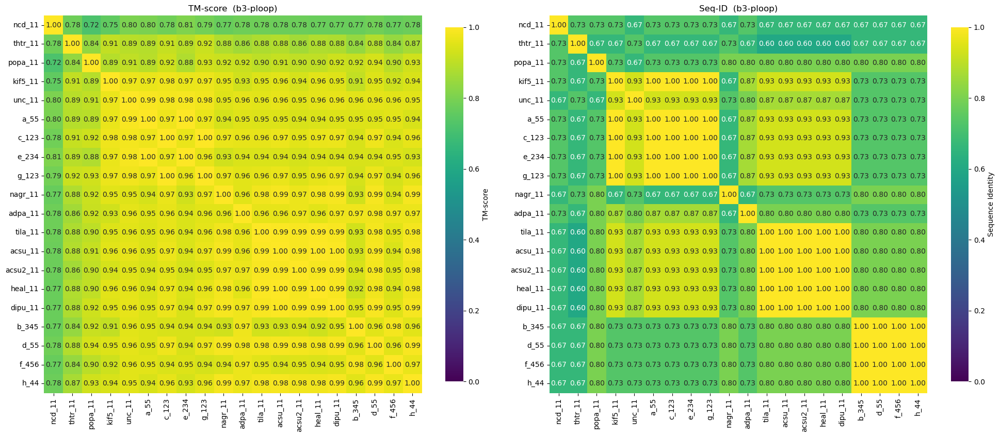


— L5 —


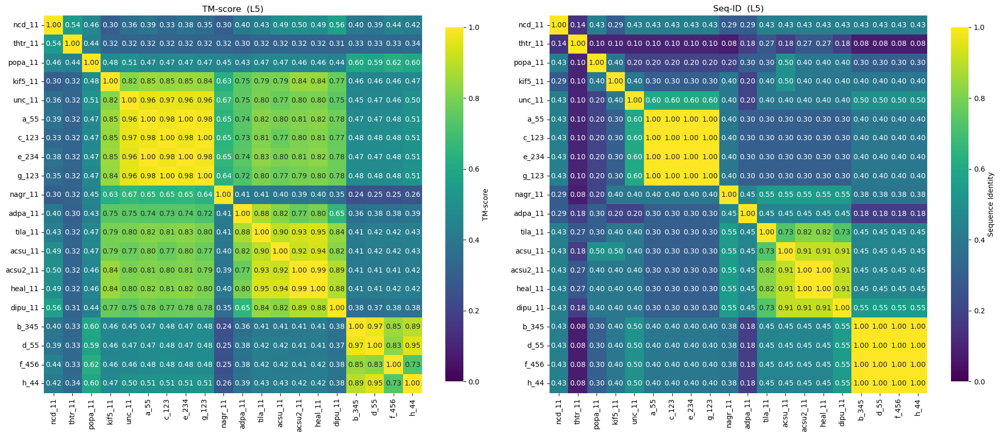


— a2 —


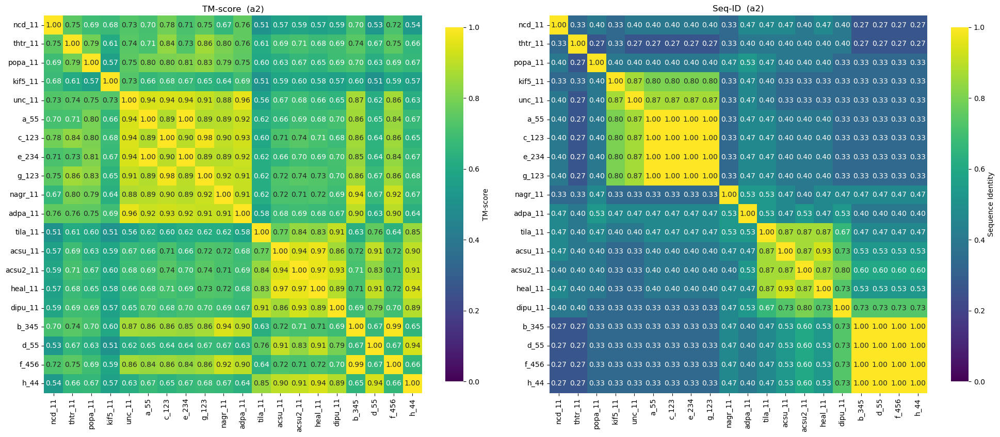


— b4 —


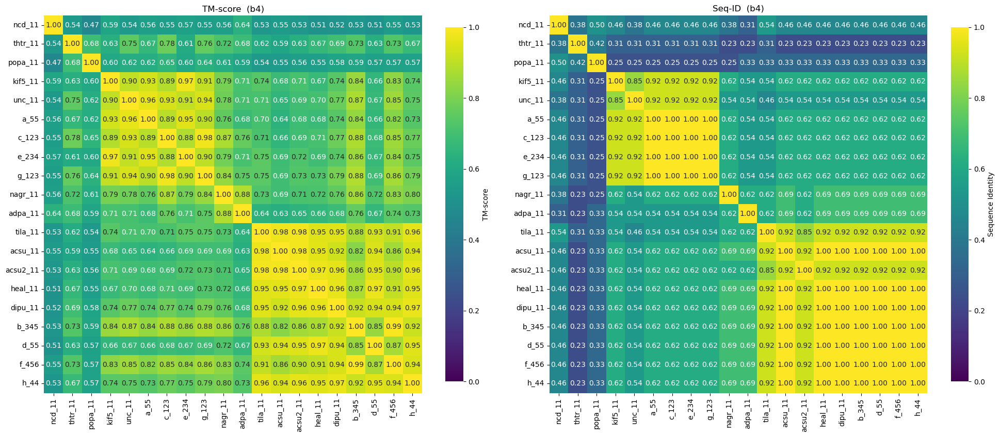


— L8-b5 —


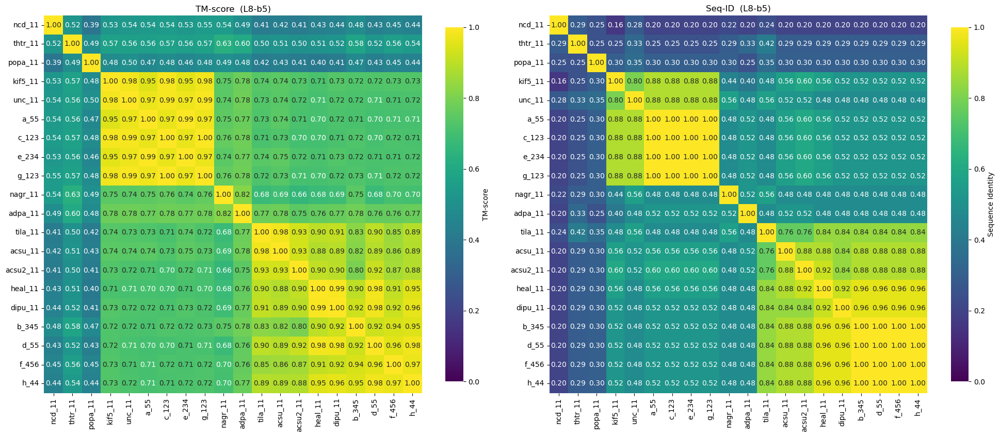


— a3 —


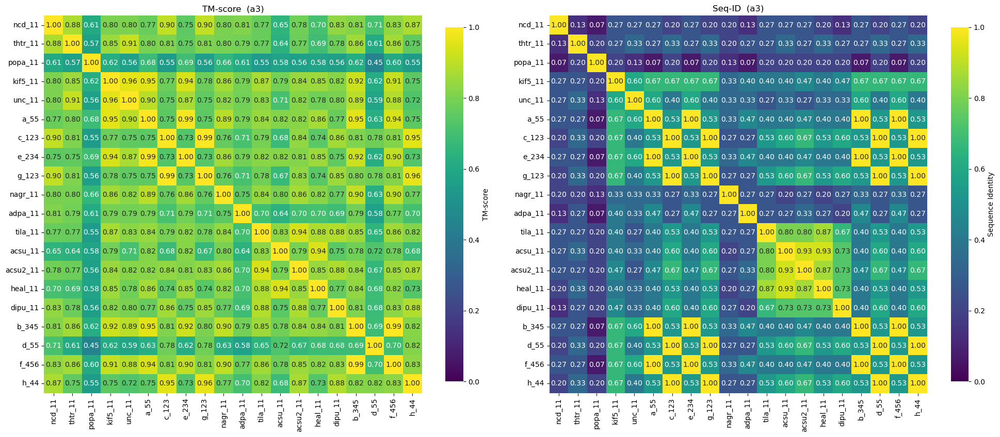


— L9-SwI —


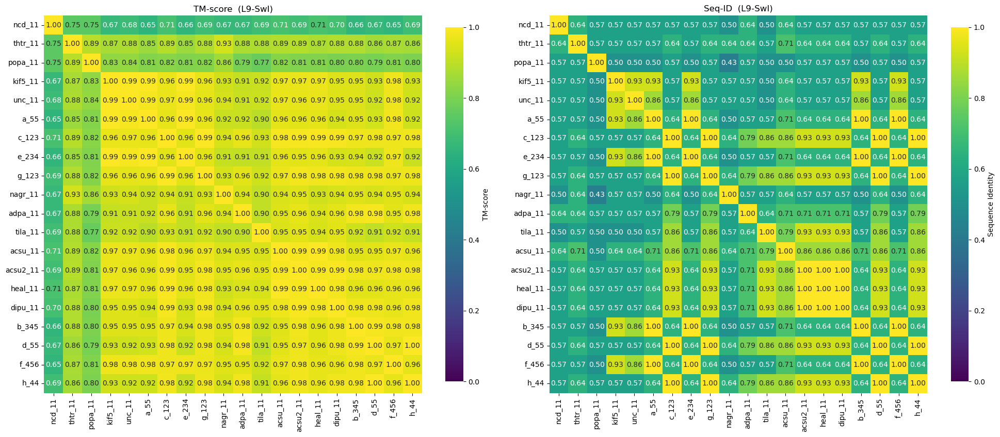


— b6 —


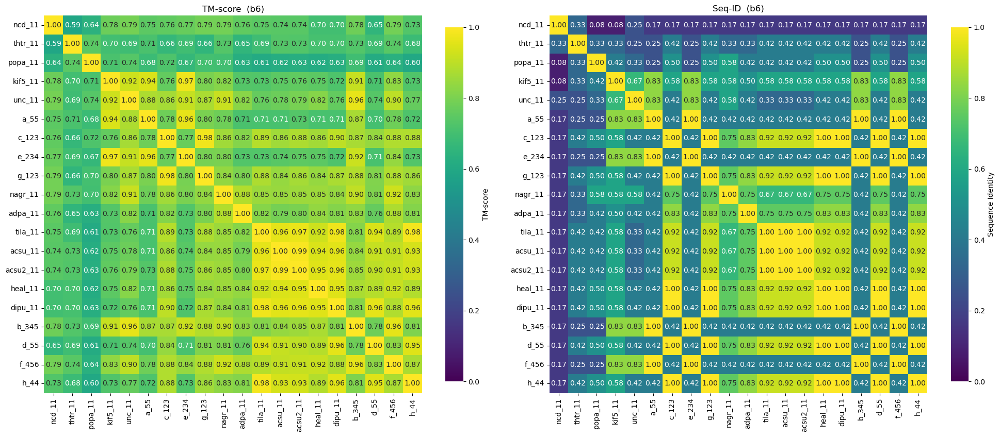


— b7 —


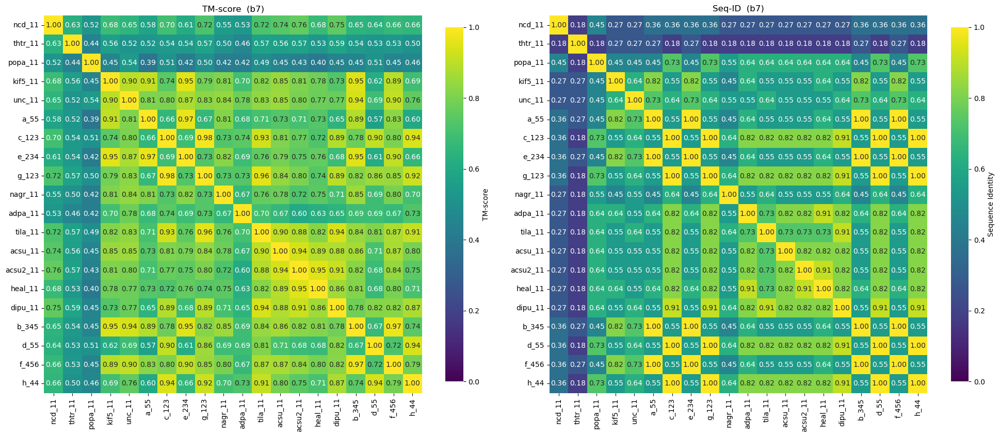


— L11-SwII —


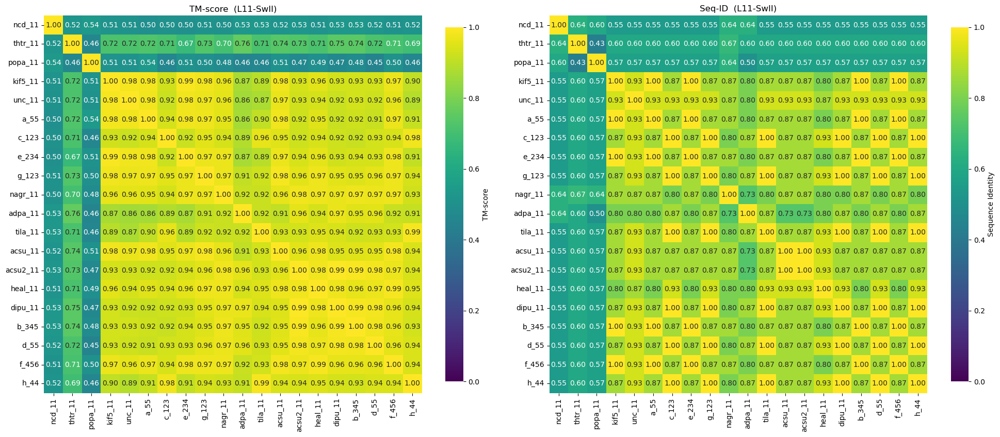


— a4 —


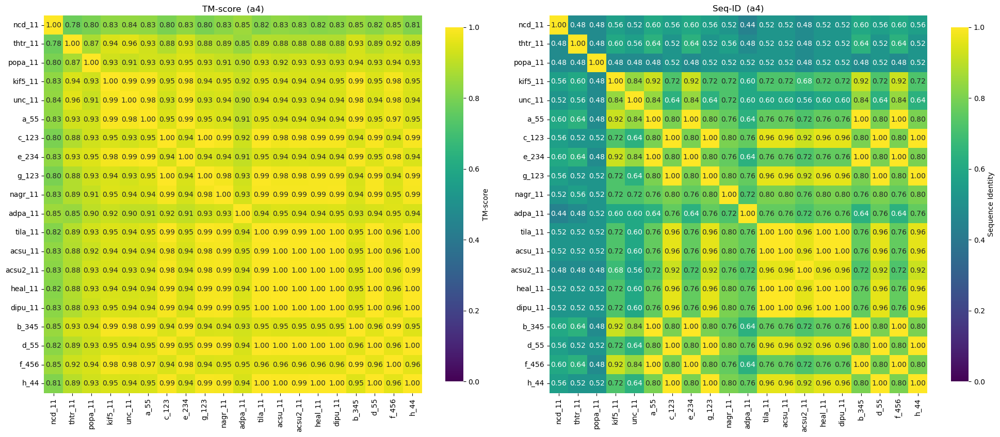


— L12 —


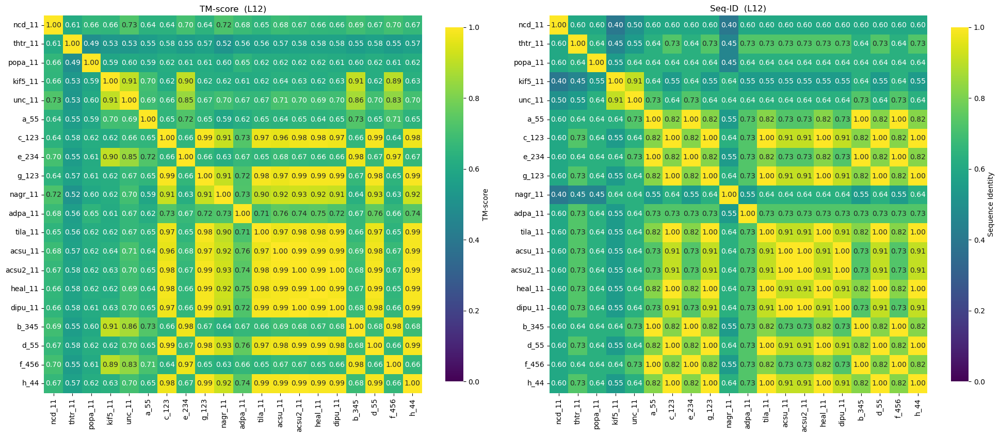


— a5 —


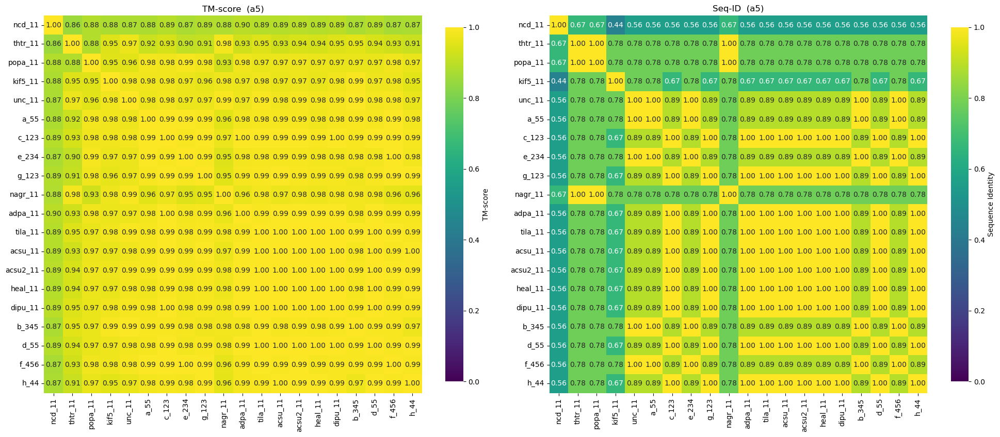


— b8-a6 —


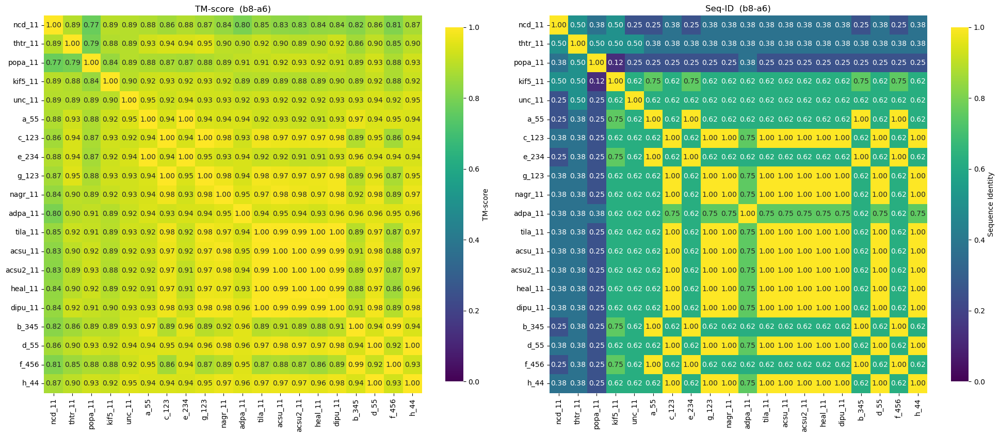


— a6 —


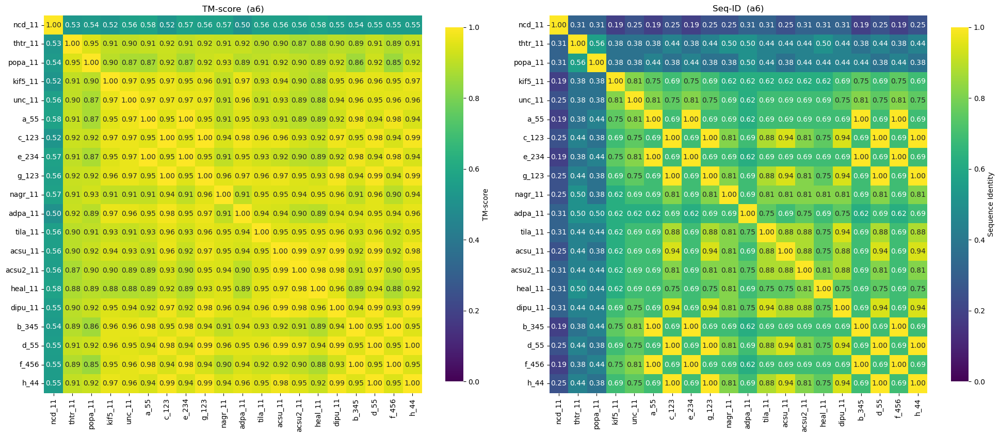


— neck —


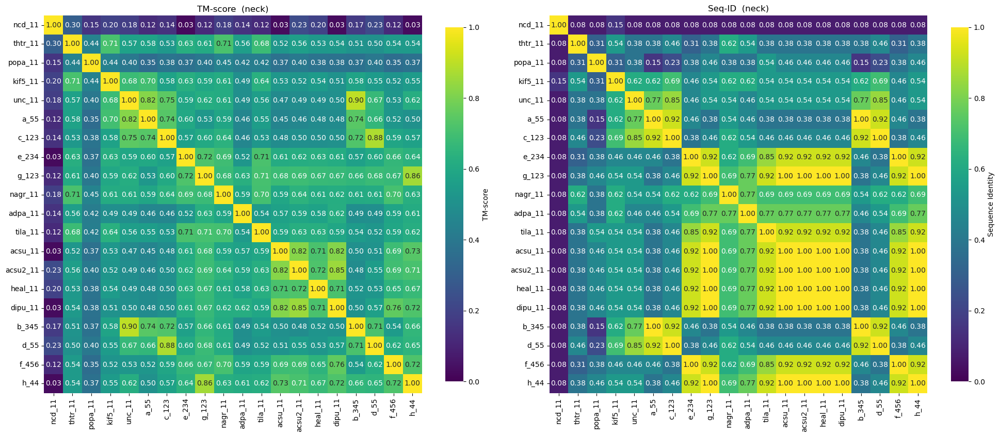


— coiled-coil —


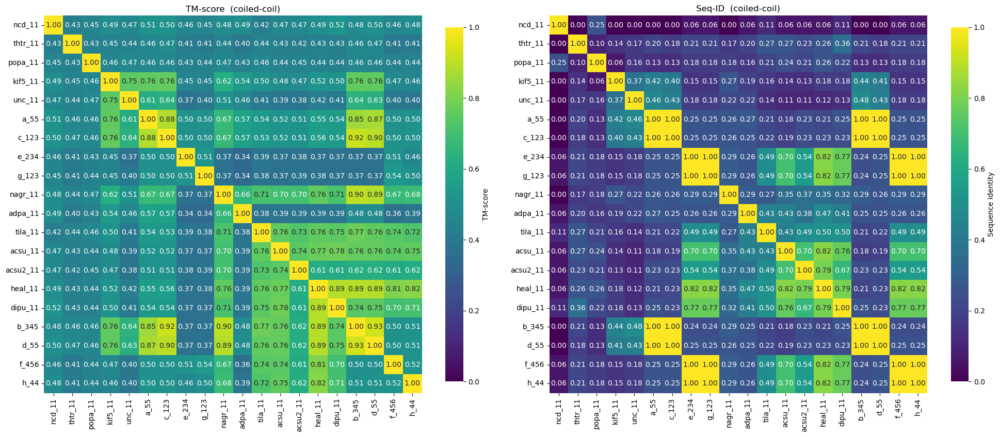


— full —


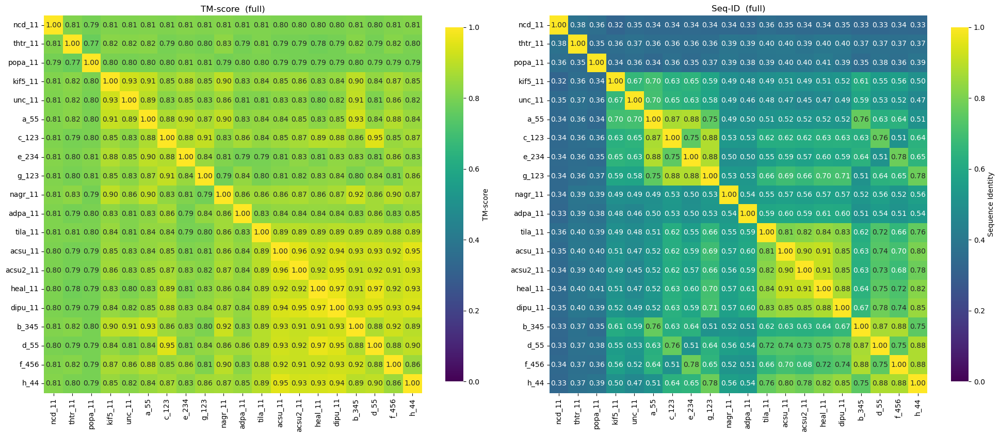


✓  Finished – trimmed PDBs in ../../data/3d_predictions/prodigy/trimmed_segments/<domain>/


In [ ]:
#!/usr/bin/env python3
"""
Kinesin‑domain TM‑score & sequence‑identity pipeline (FIXED for single-chain structures)
========================================================================================

* Reads a Clustal multiple alignment.
* Uses **a_55** as reference to map **modules** (1‑3) and **sub‑domains**.
* Enriches the alignment DataFrame (`ali_df`) with two extra columns:
      ‑  ali_df["Module"]    :  "module 1" / "module 2" / "module 3" / "-"
      ‑  ali_df["Subdomain"] :  the sub‑domain name (e.g. "b3‑ploop") or "-"
* The structural/heat‑map part is FIXED to handle single-chain structures.
* Works with structures that have any chain ID (not just "A").

Copy‑&‑paste ready.
"""

# ---------------------------------------------------------------------
#  0.  USER FILES & CONSTANTS
# ---------------------------------------------------------------------
import os, subprocess, functools, numpy as np, pandas as pd, matplotlib.pyplot as plt, seaborn as sns
from Bio import AlignIO
from Bio.PDB import PDBParser, MMCIFParser, PDBIO, Select, Polypeptide

alignment_file = "../../../../Downloads/all"      # Clustal alignment
structure_paths = [
    "../../data/3d_predictions/prodigy/ncd_11",
    "../../data/3d_predictions/prodigy/thtr_11",
    "../../data/3d_predictions/prodigy/popa_11",
    "../../data/3d_predictions/prodigy/kif5_11",
    "../../data/3d_predictions/prodigy/unc_11",

    "../../data/3d_predictions/prodigy/a_55",
    "../../data/3d_predictions/prodigy/c_123",

    "../../data/3d_predictions/prodigy/e_234",
    "../../data/3d_predictions/prodigy/g_123",

    "../../data/3d_predictions/prodigy/nagr_11",
    "../../data/3d_predictions/prodigy/adpa_11",

    "../../data/3d_predictions/prodigy/tila_11",
    "../../data/3d_predictions/prodigy/acsu_11",
    "../../data/3d_predictions/prodigy/acsu2_11",
    "../../data/3d_predictions/prodigy/heal_11",

    "../../data/3d_predictions/prodigy/dipu_11",

    "../../data/3d_predictions/prodigy/b_345",
    "../../data/3d_predictions/prodigy/d_55",

    "../../data/3d_predictions/prodigy/f_456",
    "../../data/3d_predictions/prodigy/h_44",

    # "../../data/3d_predictions/prodigy/blesto_11",
    # "../../data/3d_predictions/prodigy/blesto2_11",
]
ref_name = "a_55"                                    # reference sequence ID

# ---------------------------------------------------------------------
#  1.  DOMAIN & MODULE DEFINITIONS (UNGAPPED, REF = a_55)
# ---------------------------------------------------------------------
domain_def_ref = {
    # ---------- modules & full ---------------------------------------
    "full":       "MSAEREIPAEDSIKVVCRFRPLNDSEEKAGSKFVVKFPNNVEENCISIAGKVYLFDKVF"
                  "KPNASQEKVYNEAAKSIVTDVLAGYNGTIFAYGQTSSGKTHTMEGVIGDSVKQGIIPRI"
                  "VNDIFNHIYAMEVNLEFHIKVSYYEIYMDKIRDLLDVSKVNLSVHEDKNRVPYVKGATE"
                  "RFVSSPEDVFEVIEEGKSNRHIAVTNMNEHSSRSHSVFLINVKQENLENQKKLSGKLYL"
                  "VDLAGSEKVSKTGAEGTVLDEAKNINKSLSALGNVISALADGNKTHIPYRDSKLTRILQ"
                  "ESLGGNARTTIVICCSPASFNESETKSTLDFGRRAKTVKNVVCVNEELTAEEWKRRYEKE"
                  "KEKNARLKGKVEKLEIELARWRAGETVKAEEQINMEDLMEASTPNL",
    "module 1":   "MSAEREIPAEDSIKVVCRFRPLNDSEEKAGSKFVVKFPNNVEENCISIAGKVYLFDKVF"
                  "KPNASQEKVYNEAAKSIVTDVLAGYNGTIFAYGQTSSGKTHTMEGVIGDSVKQGIIPRI"
                  "VNDIFNHIYAMEVNLEFHIKVSYYEIYMDKIRDLLDVSKVNLSVHEDKNRVPYVKGATERF",
    "module 2":   "VSSPEDVFEVIEEGKSNRHIAVTNMNEHSSRSHSVFLINVKQENLENQKKLSGKLYLVD"
                  "LAGSEKVSKTGAEGTVLDEAKNINKSLSALGNVISALADGNKTHIPYRDSKLTRILQESL"
                  "GGNARTTIVICCSPASFNESETKSTLDFGRRAKTVK",
    "module 3":   "NVVCVNEELTAEEWKRRYEKEKEKNARLKGKVEKLEIELARWRAGETVKAEEQINMEDL"
                  "MEASTPNL",
    # ---------- sub‑domains ------------------------------------------
    "b0-a0": "AEDSIKVVCRFRPLNDSEEKA",
    "b2": "CISIAGKVYLFDKVF",
    "a1": "QEKVYNEAAKSIVTDVLA",
    "b3-ploop": "GTIFAYGQTSSGKTH",
    "L5": "GVIGDSVKQG",
    "a2": "IIPRIVNDIFNHIYA",
    "b4": "LEFHIKVSYYEIY",
    "L8-b5": "KIRDLLDVSKVNLSVHEDKNRVPYV",
    "a3": "PEDVFEVIEEGKSNR",
    "L9-SwI": "HIAVTNMNEHSSRS",
    "b6": "HSVFLINVKQEN",
    "b7": "QKKLSGKLYLV",
    "L11-SwII": "DLAGSEKVSKTGAEG",
    "a4": "TVLDEAKNINKSLSALGNVISALAD",
    "L12": "GNKTHIPYRDS",
    "a5": "KLTRILQES",
    "b8-a6": "RTTIVICC",
    "a6": "ESETKSTLDFGRRAKT",
    "neck": "VKNVVCVNEELTA",
    "coiled-coil": "EEWKRRYEKEKEKNARLKGKVEKLEIELARWRAGETVKAEEQINMEDLMEASTPNL"
}

# split dictionaries --------------------------------------------------
modules_def_ref  = {k: v for k, v in domain_def_ref.items()
                    if k in ("full", "module 1", "module 2", "module 3")}
subdom_def_ref   = {k: v for k, v in domain_def_ref.items()
                    if k not in modules_def_ref}

# ---------------------------------------------------------------------
#  2.  READ ALIGNMENT, MAP RANGES
# ---------------------------------------------------------------------
print("· loading alignment …")
ali = AlignIO.read(alignment_file, "clustal")
ali_df = pd.DataFrame({rec.id: list(str(rec.seq)) for rec in ali})
if ref_name not in ali_df.columns:
    raise ValueError(f"Reference '{ref_name}' missing from alignment.")

ref_gapped   = ali_df[ref_name].tolist()
ungapped_idx = [i for i, aa in enumerate(ref_gapped) if aa != "-"]
ref_ungapped = "".join(aa for aa in ref_gapped if aa != "-")

def map_ranges(def_dict):
    rng = {}
    for name, subseq in def_dict.items():
        u0 = ref_ungapped.find(subseq)
        if u0 == -1:
            raise ValueError(f"Cannot map '{name}'")
        g0 = ungapped_idx[u0]
        g1 = ungapped_idx[u0 + len(subseq) - 1]
        rng[name] = (g0, g1)
    return rng

module_ranges   = map_ranges({k: v for k, v in modules_def_ref.items()
                              if k != "full"})       # exclude "full"
subdom_ranges   = map_ranges(subdom_def_ref)
domain_ranges   = {**module_ranges, **subdom_ranges, "full": map_ranges({"full": modules_def_ref["full"]})["full"]}

# ---------------------------------------------------------------------
#  3.  ADD "Module" & "Subdomain" COLUMNS TO ali_df
# ---------------------------------------------------------------------
module_labels    = ["-"] * len(ref_gapped)
for mod, (g0, g1) in module_ranges.items():
    for i in range(g0, g1 + 1):
        module_labels[i] = mod

subdom_labels    = ["-"] * len(ref_gapped)
for sd, (g0, g1) in subdom_ranges.items():
    for i in range(g0, g1 + 1):
        subdom_labels[i] = sd

ali_df.insert(0, "Module",    module_labels)
ali_df.insert(1, "Subdomain", subdom_labels)

# ---------------------------------------------------------------------
#  4.  BUILD per‑protein DOMAIN SEQ DICT (ungapped)
# ---------------------------------------------------------------------
protein_dom_seq = {}
for prot in ali_df.columns[2:]:               # skip Module/Subdomain cols
    d = {}
    for dom, (g0, g1) in domain_ranges.items():
        d[dom] = "".join(ali_df.loc[g0:g1, prot]).replace("-", "")
    protein_dom_seq[prot] = d

domain_list = list(domain_ranges.keys())

# ---------------------------------------------------------------------
#  5.  STRUCTURE HELPERS (FIXED for single-chain structures)
# ---------------------------------------------------------------------
class Keep(Select):
    def __init__(self, keep, chain_id): 
        self.keep = keep
        self.chain_id = chain_id
    def accept_residue(self, r): 
        return r.get_parent().id == self.chain_id and r.get_id() in self.keep

def get_chain_sequence(path):
    """Get sequence from the first available chain (works for single-chain structures)"""
    # Attempt to open both .pdb and .cif versions
    pdb_path = path + ".pdb"
    cif_path = path + ".cif"
    
    if os.path.exists(pdb_path):
        parser = PDBParser(QUIET=True)
        s = parser.get_structure("s", pdb_path)
    elif os.path.exists(cif_path):
        parser = MMCIFParser(QUIET=True)
        s = parser.get_structure("s", cif_path)
    else:
        raise FileNotFoundError(f"Neither {pdb_path} nor {cif_path} found.")
    
    # Get all chains
    chains = list(s[0].get_chains())
    if not chains:
        raise ValueError(f"No chains found in {path}")
    
    # Use the first chain (for single-chain structures, this is the only chain)
    chain = chains[0]
    chain_id = chain.id
    
    seq, ids = [], []
    for res in chain:
        if Polypeptide.is_aa(res, standard=True):
            seq.append(Polypeptide.three_to_one(res.get_resname()))
            ids.append(res.get_id())
    
    return "".join(seq), ids, chain_id

def save_trim(src, dst, keep_ids, chain_id):
    # Attempt to open both .pdb and .cif versions
    pdb_src = src + ".pdb"
    cif_src = src + ".cif"
    
    if os.path.exists(pdb_src):
        parser = PDBParser(QUIET=True)
        s = parser.get_structure("s", pdb_src)
    elif os.path.exists(cif_src):
        parser = MMCIFParser(QUIET=True)
        s = parser.get_structure("s", cif_src)
    else:
        raise FileNotFoundError(f"Neither {pdb_src} nor {cif_src} found.")
    
    io = PDBIO()
    io.set_structure(s)
    io.save(dst, Keep(keep_ids, chain_id))

import functools, subprocess, numpy as np
@functools.lru_cache(maxsize=None)
def tm_score(p1, p2):
    out = subprocess.run(["USalign", p1, p2], stdout=subprocess.PIPE, text=True).stdout
    for ln in out.splitlines():
        if ln.startswith("TM-score="):
            try: return float(ln.split("=")[1].split()[0])
            except ValueError: break
    return np.nan

# ---------------------------------------------------------------------
#  6.  READ STRUCTURES
# ---------------------------------------------------------------------
structure_map = {os.path.splitext(os.path.basename(p))[0]: p for p in structure_paths}
structures    = [os.path.splitext(os.path.basename(p))[0] for p in structure_paths
                 if os.path.splitext(os.path.basename(p))[0] in protein_dom_seq]

# FIXED: Use the new function that returns chain_id as well
seq_cache     = {prot: get_chain_sequence(structure_map[prot]) for prot in structures}

# ---------------------------------------------------------------------
#  7.  MAIN LOOP – heat‑maps (FIXED logic)
# ---------------------------------------------------------------------
for dom in domain_list:
    print(f"\n— {dom} —")
    g0, g1 = domain_ranges[dom]
    dom_align = ali_df.loc[g0:g1, structures]        # slice with Module/Subdomain removed

    # ---------- trim structures --------------------------------------
    trimmed = {}
    for prot in structures:
        dom_seq = protein_dom_seq[prot][dom]
        full_seq, ids, chain_id = seq_cache[prot]  # FIXED: unpack chain_id
        idx = full_seq.find(dom_seq)
        if idx == -1:
            raise ValueError(f"{dom} not found in chain {chain_id} of {prot}")
        keep_ids = set(ids[idx : idx + len(dom_seq)])
        out_dir  = f"../../data/3d_predictions/prodigy/trimmed_segments/{dom}"
        os.makedirs(out_dir, exist_ok=True)
        out_pdb  = os.path.join(out_dir, f"{prot}_{dom}.pdb")
        save_trim(structure_map[prot], out_pdb, keep_ids, chain_id)  # FIXED: pass chain_id
        trimmed[prot] = out_pdb

    # ---------- matrices --------------------------------------------
    tm_mat = pd.DataFrame(index=structures, columns=structures, dtype=float)
    id_mat = pd.DataFrame(index=structures, columns=structures, dtype=float)

    for i, a in enumerate(structures):
        for j, b in enumerate(structures):
            if j < i:
                tm_mat.iat[i, j] = tm_mat.iat[j, i]
                id_mat.iat[i, j] = id_mat.iat[j, i]
                continue
            col_a, col_b = dom_align[a], dom_align[b]
            mask = (col_a != '-') & (col_b != '-')
            id_mat.iat[i, j] = ((col_a == col_b) & mask).sum() / mask.sum() if mask.any() else np.nan
            tm_mat.iat[i, j] = tm_score(trimmed[a], trimmed[b])

    # ---------- plot -------------------------------------------------
    plt.figure(figsize=(20, 9))
    plt.subplot(1, 2, 1)
    sns.heatmap(tm_mat, annot=True, fmt=".2f", cmap="viridis",
                vmin=0, vmax=1, square=True, cbar_kws={"label": "TM‑score", "shrink": 0.8})
    plt.title(f"TM‑score  ({dom})")
    plt.subplot(1, 2, 2)
    sns.heatmap(id_mat, annot=True, fmt=".2f", cmap="viridis",
                vmin=0, vmax=1, square=True, cbar_kws={"label": "Sequence Identity", "shrink": 0.8})
    plt.title(f"Seq‑ID  ({dom})")
    plt.tight_layout()
    plt.show()
    plt.close()

print("\n✓  Finished – trimmed PDBs in ../../data/3d_predictions/prodigy/trimmed_segments/<domain>/")

# ---------------------------------------------------------------------
#  8.  OPTIONAL – inspect the enriched alignment DataFrame
# ---------------------------------------------------------------------
# print(ali_df.head(30))  # uncomment to preview Module / Subdomain labels

· loading alignment …


/Users/dalarios/anaconda3/lib/python3.11/site-packages/Bio/PDB/Polypeptide.py:144: BiopythonDeprecationWarning: 'three_to_one' will be deprecated in a future release of Biopython in favor of 'Bio.PDB.Polypeptide.protein_letters_3to1'.
  warnings.warn(
/Users/dalarios/anaconda3/lib/python3.11/site-packages/Bio/PDB/Polypeptide.py:144: BiopythonDeprecationWarning: 'three_to_one' will be deprecated in a future release of Biopython in favor of 'Bio.PDB.Polypeptide.protein_letters_3to1'.
  warnings.warn(
/Users/dalarios/anaconda3/lib/python3.11/site-packages/Bio/PDB/Polypeptide.py:144: BiopythonDeprecationWarning: 'three_to_one' will be deprecated in a future release of Biopython in favor of 'Bio.PDB.Polypeptide.protein_letters_3to1'.
  warnings.warn(
/Users/dalarios/anaconda3/lib/python3.11/site-packages/Bio/PDB/Polypeptide.py:144: BiopythonDeprecationWarning: 'three_to_one' will be deprecated in a future release of Biopython in favor of 'Bio.PDB.Polypeptide.protein_letters_3to1'.
  warning


— module 1 —


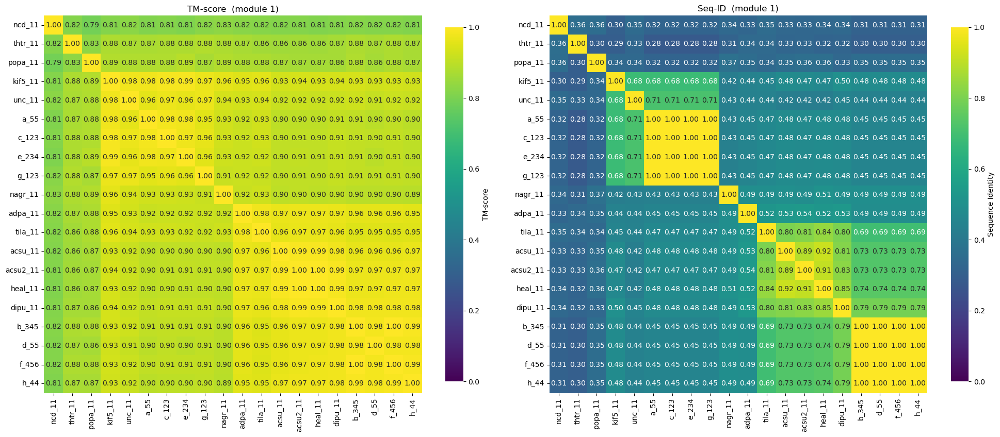


— module 2 —


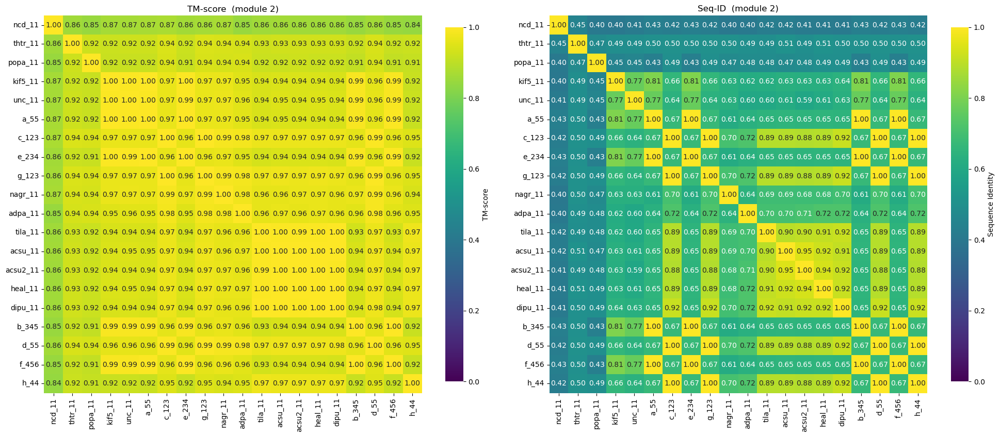


— module 3 —


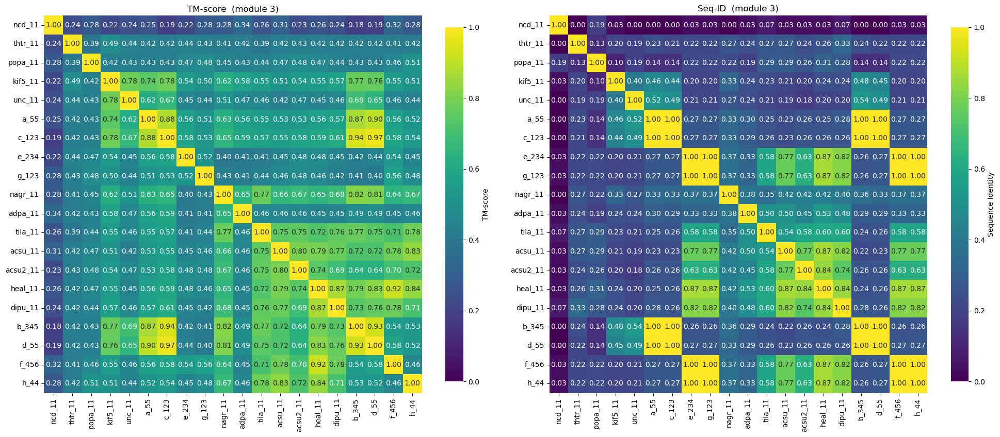


— b0-a0 —


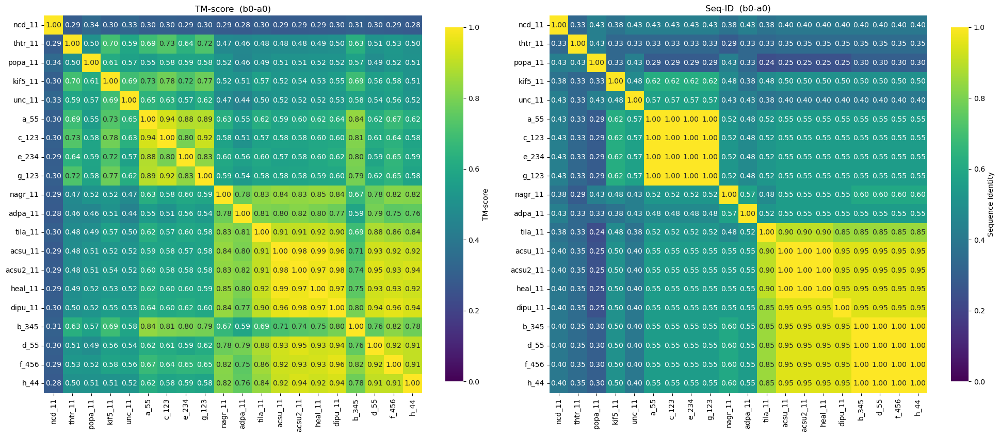


— b2 —


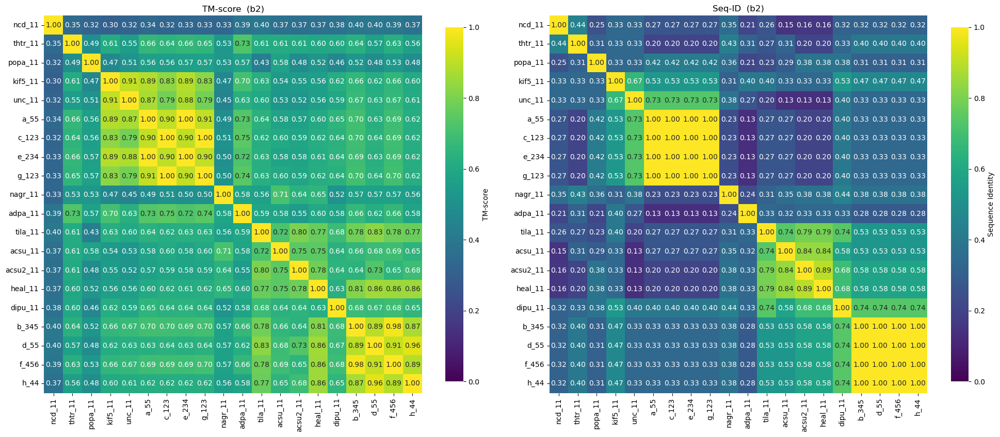


— a1 —


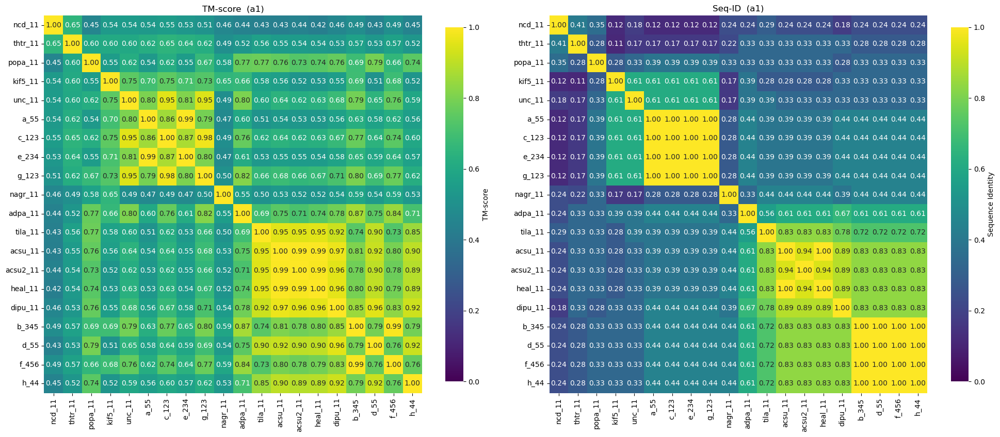


— b3-ploop —


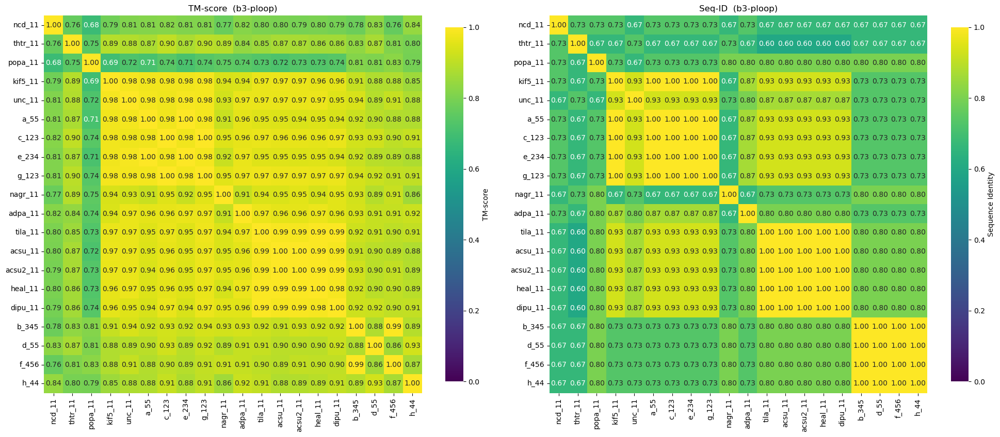


— L5 —


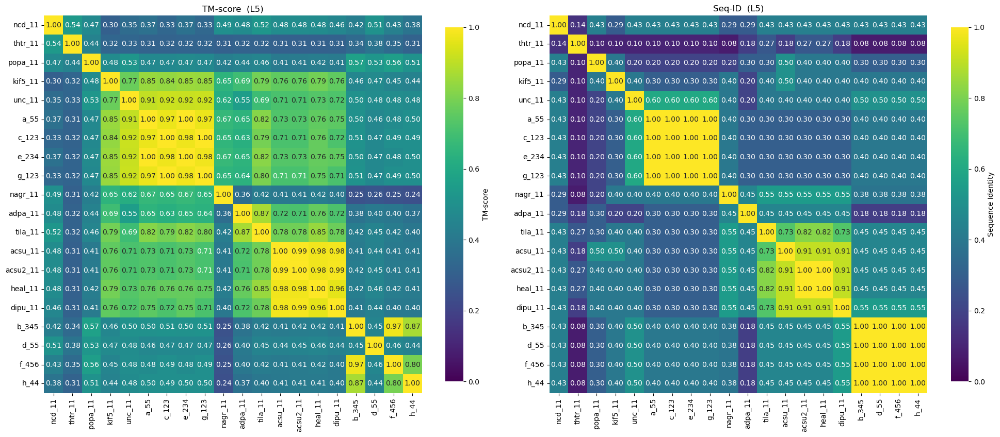


— a2 —


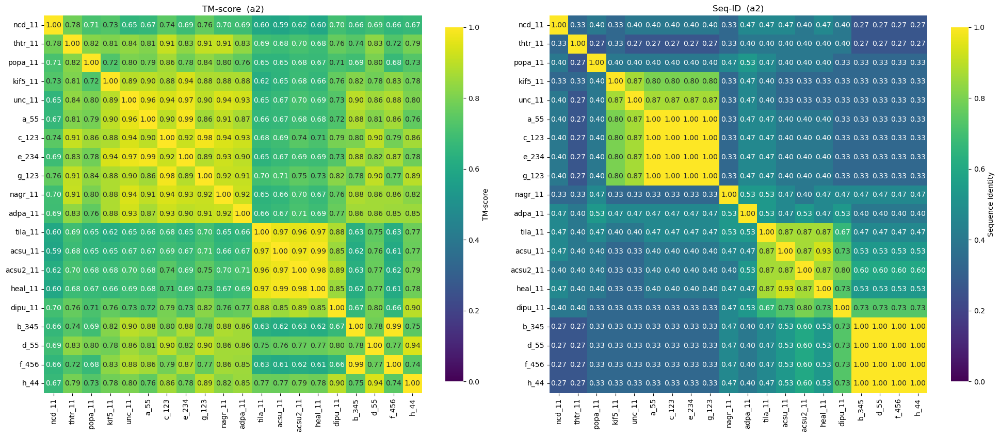


— b4 —


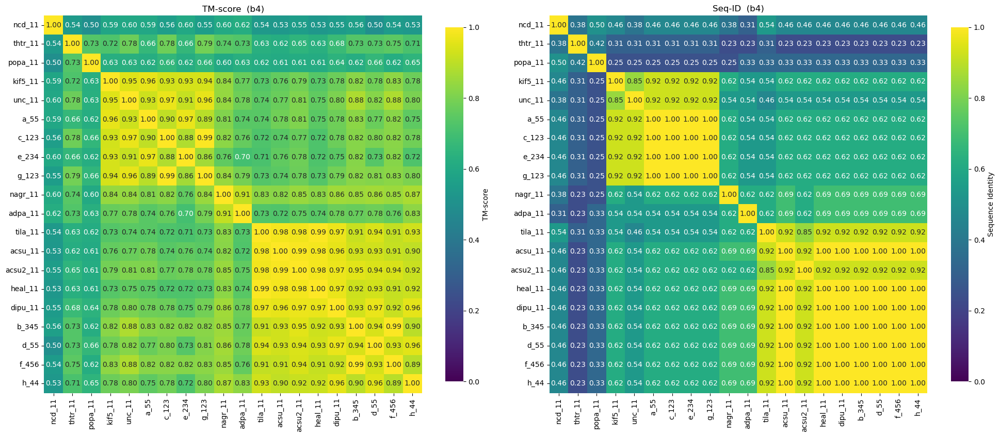


— L8-b5 —


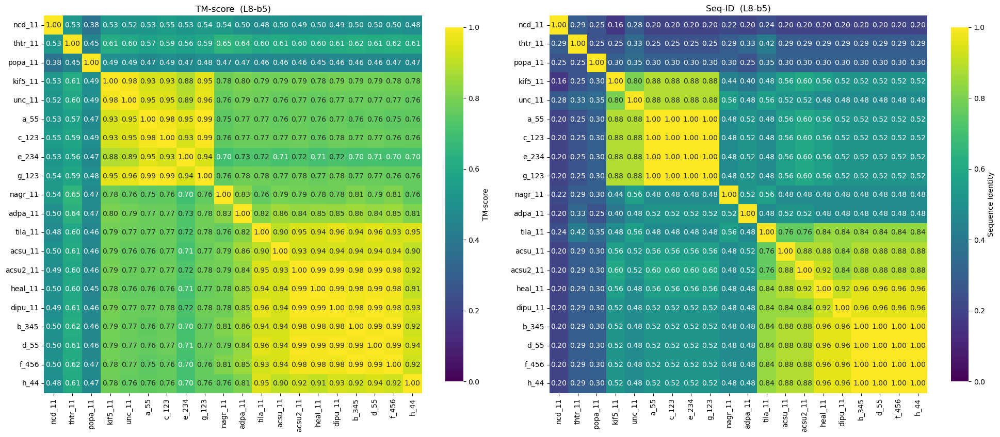


— a3 —


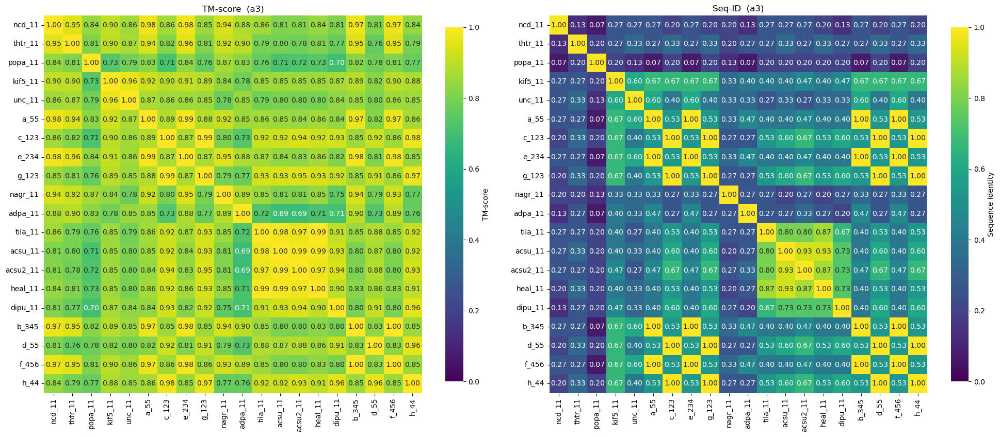


— L9-SwI —


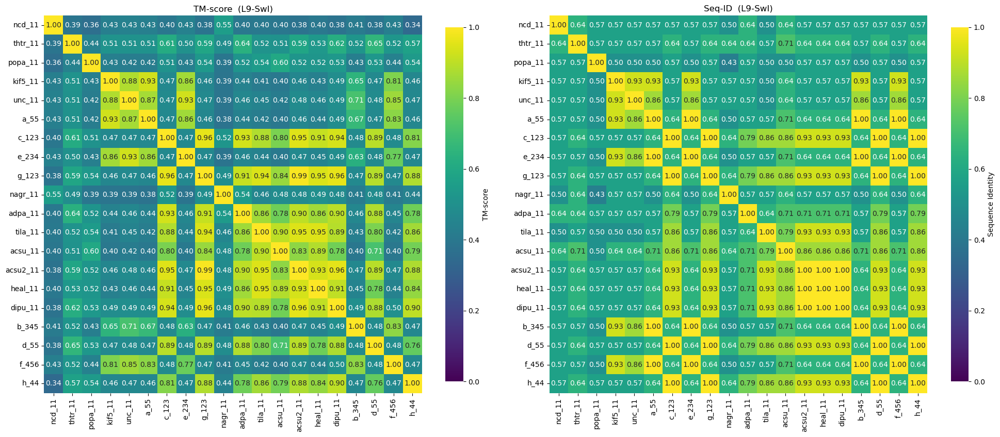


— b6 —


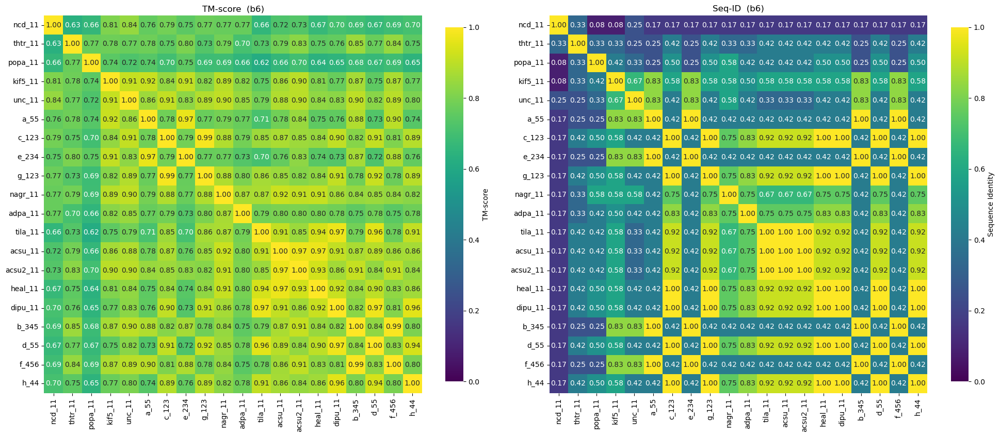


— b7 —


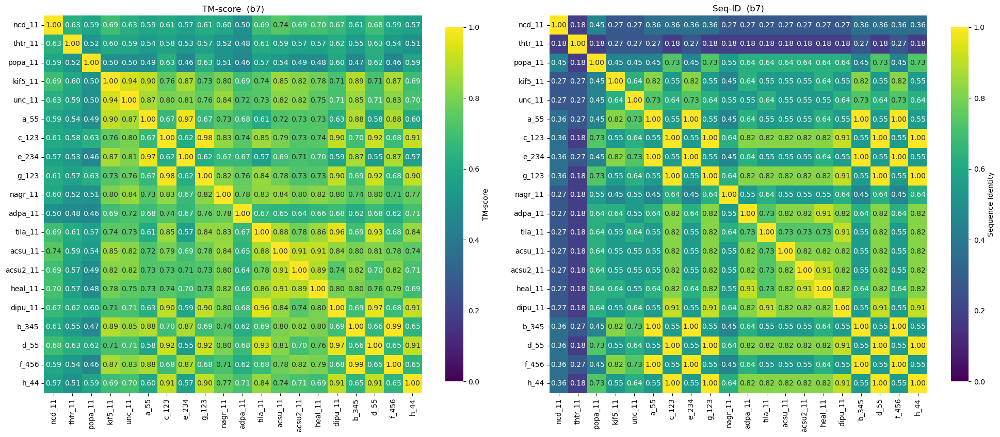


— L11-SwII —


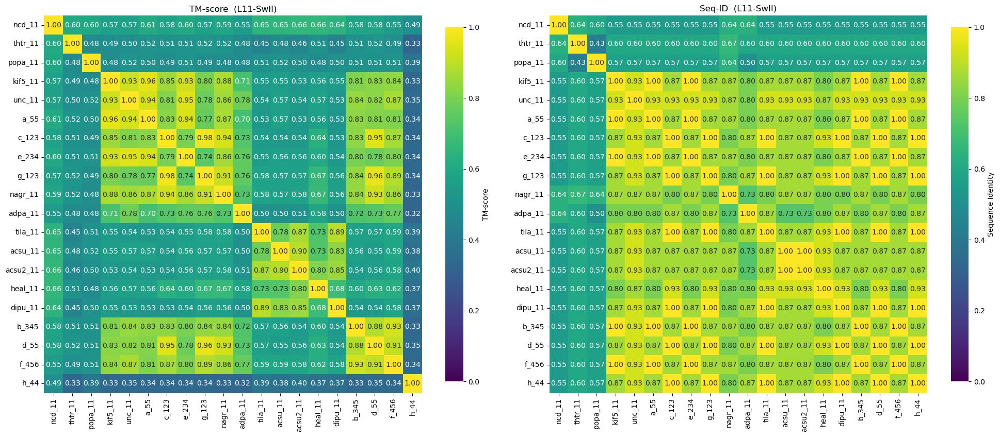


— a4 —


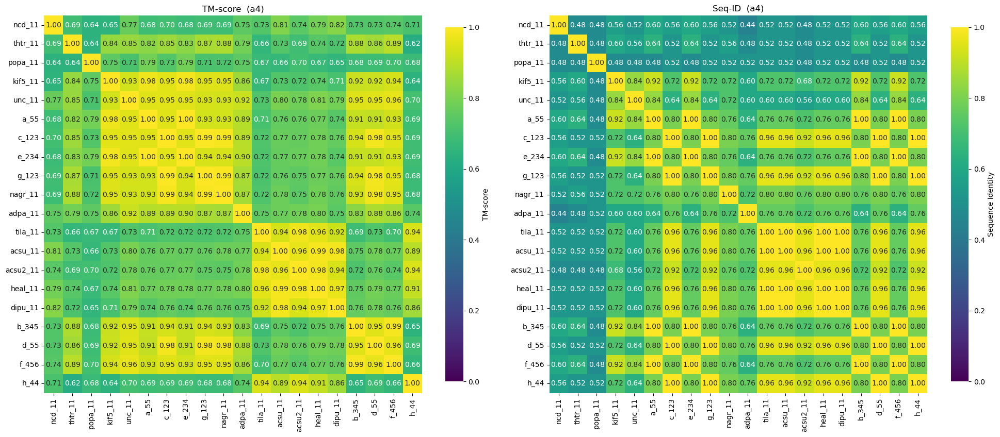


— L12 —


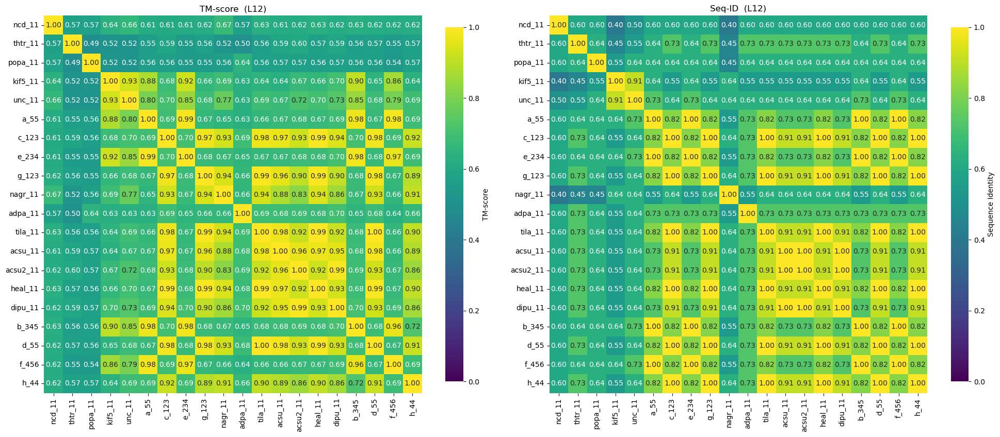


— a5 —


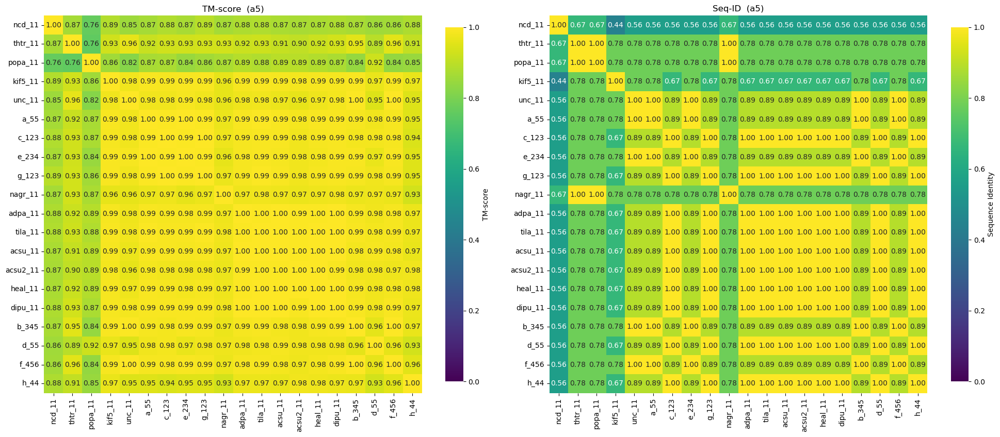


— b8-a6 —


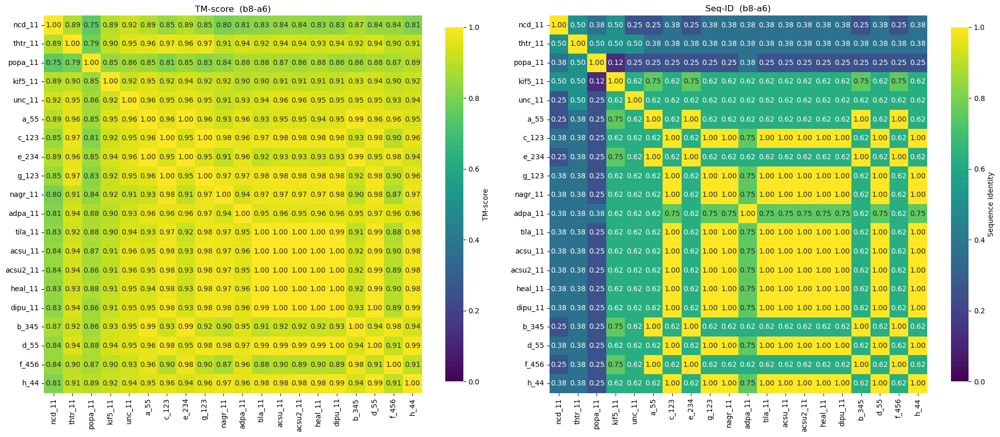


— a6 —


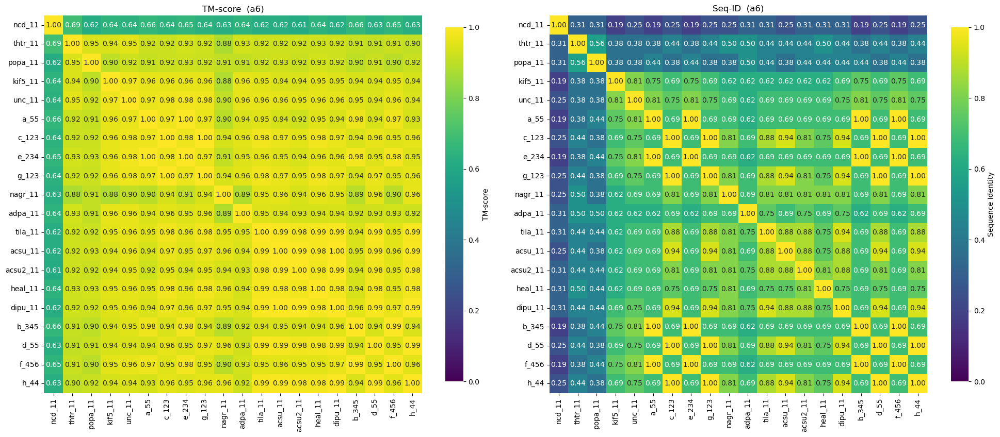


— neck —


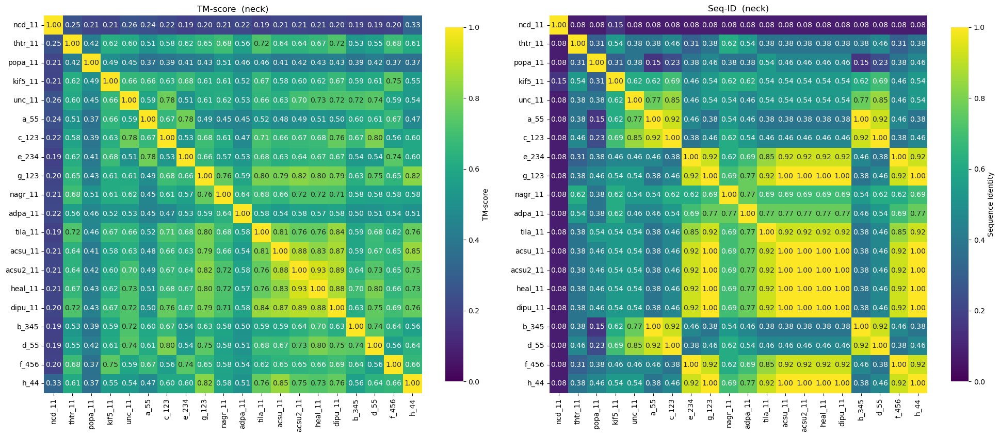


— coiled-coil —


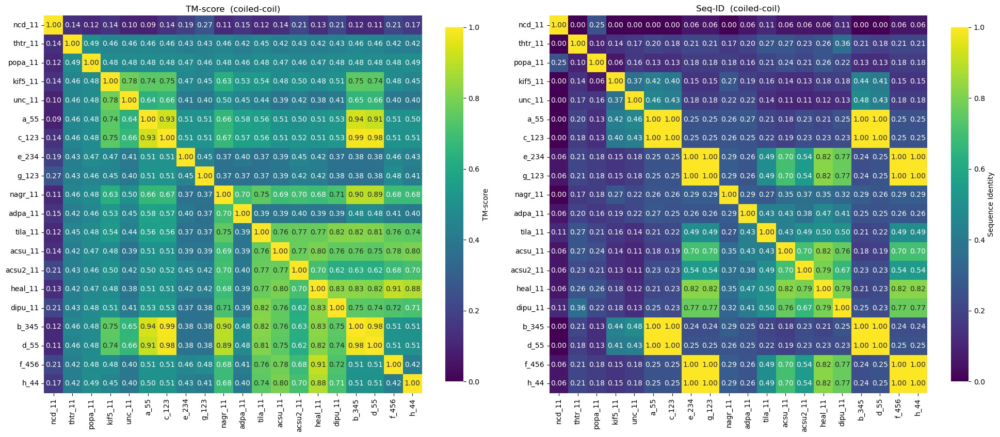


— full —


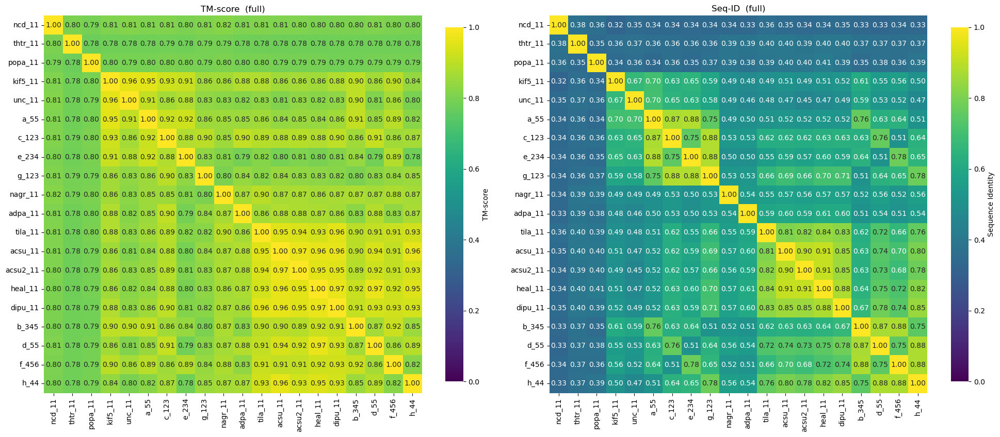


✓  Finished – trimmed PDBs in ../../data/3d_predictions/prodigy/trimmed_segments/<domain>/


In [22]:
#!/usr/bin/env python3
"""
Kinesin‑domain TM‑score & sequence‑identity pipeline (FIXED for single-chain structures)
========================================================================================

* Reads a Clustal multiple alignment.
* Uses **a_55** as reference to map **modules** (1‑3) and **sub‑domains**.
* Enriches the alignment DataFrame (`ali_df`) with two extra columns:
      ‑  ali_df["Module"]    :  "module 1" / "module 2" / "module 3" / "-"
      ‑  ali_df["Subdomain"] :  the sub‑domain name (e.g. "b3‑ploop") or "-"
* The structural/heat‑map part is FIXED to handle single-chain structures.
* Works with structures that have any chain ID (not just "A").

Copy‑&‑paste ready.
"""

# ---------------------------------------------------------------------
#  0.  USER FILES & CONSTANTS
# ---------------------------------------------------------------------
import os, subprocess, functools, numpy as np, pandas as pd, matplotlib.pyplot as plt, seaborn as sns
from Bio import AlignIO
from Bio.PDB import PDBParser, MMCIFParser, PDBIO, Select, Polypeptide

alignment_file = "../../../../Downloads/all"      # Clustal alignment
structure_paths = [

    "../../data/3d_predictions/prodigy/monomer_predicted/ncd_11",
    "../../data/3d_predictions/prodigy/monomer_predicted/thtr_11",
    "../../data/3d_predictions/prodigy/monomer_predicted/popa_11",
    "../../data/3d_predictions/prodigy/monomer_predicted/kif5_11",
    "../../data/3d_predictions/prodigy/monomer_predicted/unc_11",

    "../../data/3d_predictions/prodigy/monomer_predicted/a_55",
    "../../data/3d_predictions/prodigy/monomer_predicted/c_123",

    "../../data/3d_predictions/prodigy/monomer_predicted/e_234",
    "../../data/3d_predictions/prodigy/monomer_predicted/g_123",

    "../../data/3d_predictions/prodigy/monomer_predicted/nagr_11",
    "../../data/3d_predictions/prodigy/monomer_predicted/adpa_11",

    "../../data/3d_predictions/prodigy/monomer_predicted/tila_11",
    "../../data/3d_predictions/prodigy/monomer_predicted/acsu_11",
    "../../data/3d_predictions/prodigy/monomer_predicted/acsu2_11",
    "../../data/3d_predictions/prodigy/monomer_predicted/heal_11",

    "../../data/3d_predictions/prodigy/monomer_predicted/dipu_11",

    "../../data/3d_predictions/prodigy/monomer_predicted/b_345",
    "../../data/3d_predictions/prodigy/monomer_predicted/d_55",

    "../../data/3d_predictions/prodigy/monomer_predicted/f_456",
    "../../data/3d_predictions/prodigy/monomer_predicted/h_44",

    # "../../data/3d_predictions/prodigy/blesto_11",
    # "../../data/3d_predictions/prodigy/blesto2_11",
]
ref_name = "a_55"                                    # reference sequence ID

# ---------------------------------------------------------------------
#  1.  DOMAIN & MODULE DEFINITIONS (UNGAPPED, REF = a_55)
# ---------------------------------------------------------------------
domain_def_ref = {
    # ---------- modules & full ---------------------------------------
    "full":       "MSAEREIPAEDSIKVVCRFRPLNDSEEKAGSKFVVKFPNNVEENCISIAGKVYLFDKVF"
                  "KPNASQEKVYNEAAKSIVTDVLAGYNGTIFAYGQTSSGKTHTMEGVIGDSVKQGIIPRI"
                  "VNDIFNHIYAMEVNLEFHIKVSYYEIYMDKIRDLLDVSKVNLSVHEDKNRVPYVKGATE"
                  "RFVSSPEDVFEVIEEGKSNRHIAVTNMNEHSSRSHSVFLINVKQENLENQKKLSGKLYL"
                  "VDLAGSEKVSKTGAEGTVLDEAKNINKSLSALGNVISALADGNKTHIPYRDSKLTRILQ"
                  "ESLGGNARTTIVICCSPASFNESETKSTLDFGRRAKTVKNVVCVNEELTAEEWKRRYEKE"
                  "KEKNARLKGKVEKLEIELARWRAGETVKAEEQINMEDLMEASTPNL",
    "module 1":   "MSAEREIPAEDSIKVVCRFRPLNDSEEKAGSKFVVKFPNNVEENCISIAGKVYLFDKVF"
                  "KPNASQEKVYNEAAKSIVTDVLAGYNGTIFAYGQTSSGKTHTMEGVIGDSVKQGIIPRI"
                  "VNDIFNHIYAMEVNLEFHIKVSYYEIYMDKIRDLLDVSKVNLSVHEDKNRVPYVKGATERF",
    "module 2":   "VSSPEDVFEVIEEGKSNRHIAVTNMNEHSSRSHSVFLINVKQENLENQKKLSGKLYLVD"
                  "LAGSEKVSKTGAEGTVLDEAKNINKSLSALGNVISALADGNKTHIPYRDSKLTRILQESL"
                  "GGNARTTIVICCSPASFNESETKSTLDFGRRAKTVK",
    "module 3":   "NVVCVNEELTAEEWKRRYEKEKEKNARLKGKVEKLEIELARWRAGETVKAEEQINMEDL"
                  "MEASTPNL",
    # ---------- sub‑domains ------------------------------------------
    "b0-a0": "AEDSIKVVCRFRPLNDSEEKA",
    "b2": "CISIAGKVYLFDKVF",
    "a1": "QEKVYNEAAKSIVTDVLA",
    "b3-ploop": "GTIFAYGQTSSGKTH",
    "L5": "GVIGDSVKQG",
    "a2": "IIPRIVNDIFNHIYA",
    "b4": "LEFHIKVSYYEIY",
    "L8-b5": "KIRDLLDVSKVNLSVHEDKNRVPYV",
    "a3": "PEDVFEVIEEGKSNR",
    "L9-SwI": "HIAVTNMNEHSSRS",
    "b6": "HSVFLINVKQEN",
    "b7": "QKKLSGKLYLV",
    "L11-SwII": "DLAGSEKVSKTGAEG",
    "a4": "TVLDEAKNINKSLSALGNVISALAD",
    "L12": "GNKTHIPYRDS",
    "a5": "KLTRILQES",
    "b8-a6": "RTTIVICC",
    "a6": "ESETKSTLDFGRRAKT",
    "neck": "VKNVVCVNEELTA",
    "coiled-coil": "EEWKRRYEKEKEKNARLKGKVEKLEIELARWRAGETVKAEEQINMEDLMEASTPNL"
}

# split dictionaries --------------------------------------------------
modules_def_ref  = {k: v for k, v in domain_def_ref.items()
                    if k in ("full", "module 1", "module 2", "module 3")}
subdom_def_ref   = {k: v for k, v in domain_def_ref.items()
                    if k not in modules_def_ref}

# ---------------------------------------------------------------------
#  2.  READ ALIGNMENT, MAP RANGES
# ---------------------------------------------------------------------
print("· loading alignment …")
ali = AlignIO.read(alignment_file, "clustal")
ali_df = pd.DataFrame({rec.id: list(str(rec.seq)) for rec in ali})
if ref_name not in ali_df.columns:
    raise ValueError(f"Reference '{ref_name}' missing from alignment.")

ref_gapped   = ali_df[ref_name].tolist()
ungapped_idx = [i for i, aa in enumerate(ref_gapped) if aa != "-"]
ref_ungapped = "".join(aa for aa in ref_gapped if aa != "-")

def map_ranges(def_dict):
    rng = {}
    for name, subseq in def_dict.items():
        u0 = ref_ungapped.find(subseq)
        if u0 == -1:
            raise ValueError(f"Cannot map '{name}'")
        g0 = ungapped_idx[u0]
        g1 = ungapped_idx[u0 + len(subseq) - 1]
        rng[name] = (g0, g1)
    return rng

module_ranges   = map_ranges({k: v for k, v in modules_def_ref.items()
                              if k != "full"})       # exclude "full"
subdom_ranges   = map_ranges(subdom_def_ref)
domain_ranges   = {**module_ranges, **subdom_ranges, "full": map_ranges({"full": modules_def_ref["full"]})["full"]}

# ---------------------------------------------------------------------
#  3.  ADD "Module" & "Subdomain" COLUMNS TO ali_df
# ---------------------------------------------------------------------
module_labels    = ["-"] * len(ref_gapped)
for mod, (g0, g1) in module_ranges.items():
    for i in range(g0, g1 + 1):
        module_labels[i] = mod

subdom_labels    = ["-"] * len(ref_gapped)
for sd, (g0, g1) in subdom_ranges.items():
    for i in range(g0, g1 + 1):
        subdom_labels[i] = sd

ali_df.insert(0, "Module",    module_labels)
ali_df.insert(1, "Subdomain", subdom_labels)

# ---------------------------------------------------------------------
#  4.  BUILD per‑protein DOMAIN SEQ DICT (ungapped)
# ---------------------------------------------------------------------
protein_dom_seq = {}
for prot in ali_df.columns[2:]:               # skip Module/Subdomain cols
    d = {}
    for dom, (g0, g1) in domain_ranges.items():
        d[dom] = "".join(ali_df.loc[g0:g1, prot]).replace("-", "")
    protein_dom_seq[prot] = d

domain_list = list(domain_ranges.keys())

# ---------------------------------------------------------------------
#  5.  STRUCTURE HELPERS (FIXED for single-chain structures)
# ---------------------------------------------------------------------
class Keep(Select):
    def __init__(self, keep, chain_id): 
        self.keep = keep
        self.chain_id = chain_id
    def accept_residue(self, r): 
        return r.get_parent().id == self.chain_id and r.get_id() in self.keep

def get_chain_sequence(path):
    """Get sequence from the first available chain (works for single-chain structures)"""
    # Attempt to open both .pdb and .cif versions
    pdb_path = path + ".pdb"
    cif_path = path + ".cif"
    
    if os.path.exists(pdb_path):
        parser = PDBParser(QUIET=True)
        s = parser.get_structure("s", pdb_path)
    elif os.path.exists(cif_path):
        parser = MMCIFParser(QUIET=True)
        s = parser.get_structure("s", cif_path)
    else:
        raise FileNotFoundError(f"Neither {pdb_path} nor {cif_path} found.")
    
    # Get all chains
    chains = list(s[0].get_chains())
    if not chains:
        raise ValueError(f"No chains found in {path}")
    
    # Use the first chain (for single-chain structures, this is the only chain)
    chain = chains[0]
    chain_id = chain.id
    
    seq, ids = [], []
    for res in chain:
        if Polypeptide.is_aa(res, standard=True):
            seq.append(Polypeptide.three_to_one(res.get_resname()))
            ids.append(res.get_id())
    
    return "".join(seq), ids, chain_id

def save_trim(src, dst, keep_ids, chain_id):
    # Attempt to open both .pdb and .cif versions
    pdb_src = src + ".pdb"
    cif_src = src + ".cif"
    
    if os.path.exists(pdb_src):
        parser = PDBParser(QUIET=True)
        s = parser.get_structure("s", pdb_src)
    elif os.path.exists(cif_src):
        parser = MMCIFParser(QUIET=True)
        s = parser.get_structure("s", cif_src)
    else:
        raise FileNotFoundError(f"Neither {pdb_src} nor {cif_src} found.")
    
    io = PDBIO()
    io.set_structure(s)
    io.save(dst, Keep(keep_ids, chain_id))

import functools, subprocess, numpy as np
@functools.lru_cache(maxsize=None)
def tm_score(p1, p2):
    out = subprocess.run(["USalign", p1, p2], stdout=subprocess.PIPE, text=True).stdout
    for ln in out.splitlines():
        if ln.startswith("TM-score="):
            try: return float(ln.split("=")[1].split()[0])
            except ValueError: break
    return np.nan

# ---------------------------------------------------------------------
#  6.  READ STRUCTURES
# ---------------------------------------------------------------------
structure_map = {os.path.splitext(os.path.basename(p))[0]: p for p in structure_paths}
structures    = [os.path.splitext(os.path.basename(p))[0] for p in structure_paths
                 if os.path.splitext(os.path.basename(p))[0] in protein_dom_seq]

# FIXED: Use the new function that returns chain_id as well
seq_cache     = {prot: get_chain_sequence(structure_map[prot]) for prot in structures}

# ---------------------------------------------------------------------
#  7.  MAIN LOOP – heat‑maps (FIXED logic)
# ---------------------------------------------------------------------
for dom in domain_list:
    print(f"\n— {dom} —")
    g0, g1 = domain_ranges[dom]
    dom_align = ali_df.loc[g0:g1, structures]        # slice with Module/Subdomain removed

    # ---------- trim structures --------------------------------------
    trimmed = {}
    for prot in structures:
        dom_seq = protein_dom_seq[prot][dom]
        full_seq, ids, chain_id = seq_cache[prot]  # FIXED: unpack chain_id
        idx = full_seq.find(dom_seq)
        if idx == -1:
            raise ValueError(f"{dom} not found in chain {chain_id} of {prot}")
        keep_ids = set(ids[idx : idx + len(dom_seq)])
        out_dir  = f"../../data/3d_predictions/prodigy/trimmed_segments/{dom}"
        os.makedirs(out_dir, exist_ok=True)
        out_pdb  = os.path.join(out_dir, f"{prot}_{dom}.pdb")
        save_trim(structure_map[prot], out_pdb, keep_ids, chain_id)  # FIXED: pass chain_id
        trimmed[prot] = out_pdb

    # ---------- matrices --------------------------------------------
    tm_mat = pd.DataFrame(index=structures, columns=structures, dtype=float)
    id_mat = pd.DataFrame(index=structures, columns=structures, dtype=float)

    for i, a in enumerate(structures):
        for j, b in enumerate(structures):
            if j < i:
                tm_mat.iat[i, j] = tm_mat.iat[j, i]
                id_mat.iat[i, j] = id_mat.iat[j, i]
                continue
            col_a, col_b = dom_align[a], dom_align[b]
            mask = (col_a != '-') & (col_b != '-')
            id_mat.iat[i, j] = ((col_a == col_b) & mask).sum() / mask.sum() if mask.any() else np.nan
            tm_mat.iat[i, j] = tm_score(trimmed[a], trimmed[b])

    # ---------- plot -------------------------------------------------
    plt.figure(figsize=(20, 9))
    plt.subplot(1, 2, 1)
    sns.heatmap(tm_mat, annot=True, fmt=".2f", cmap="viridis",
                vmin=0, vmax=1, square=True, cbar_kws={"label": "TM‑score", "shrink": 0.8})
    plt.title(f"TM‑score  ({dom})")
    plt.subplot(1, 2, 2)
    sns.heatmap(id_mat, annot=True, fmt=".2f", cmap="viridis",
                vmin=0, vmax=1, square=True, cbar_kws={"label": "Sequence Identity", "shrink": 0.8})
    plt.title(f"Seq‑ID  ({dom})")
    plt.tight_layout()
    plt.show()
    plt.close()

print("\n✓  Finished – trimmed PDBs in ../../data/3d_predictions/prodigy/trimmed_segments/<domain>/")

# ---------------------------------------------------------------------
#  8.  OPTIONAL – inspect the enriched alignment DataFrame
# ---------------------------------------------------------------------
# print(ali_df.head(30))  # uncomment to preview Module / Subdomain labels